##**Trabalho Introdução a Ciência de Dados - Spotify**

Grupo: 11

Integrantes:
  *   Kleber Junior Alves Pereira - 2020054625
  *   Letícia Miranda Ribeiro - 2021095686
  *   Lucca Alvarenga de Magalhães Pinto - 2021036736
  *   Victor Gabriel Moura Oliveira - 2021019602

**Objetivo:** analisar o banco de dados "Spotify Top Hit Playlist 2010-2023" e obter uma maior compreensão das dinâmicas e tendências da música popular ao longo de mais de uma década.

**Motivação:**

A escolha de analisar essa base de dados está motivada por diversas razões, alinhadas com o objetivo de explorar o ciclo de tarefas de um cientista de dados e fazer uso da matéria ensinada durante a disciplina.

A música é uma parte integral da cultura moderna, e serviços de streaming como o Spotify têm revolucionado a forma como consumimos essa parte do entretenimento. A base "Spotify Top Hit Playlist 2010-2023" oferece uma rica fonte de dados sobre as músicas mais populares ao longo dos anos, refletindo tendências e mudanças nos gostos musicais. Analisar esses dados, nos permite entender melhor o que torna uma faixa um sucesso, além de identificar padrões e características comuns entre as faixas mais escutadas, o que pode ter implicações práticas para a indústria musical, ajudando artistas, produtores e empresas a tomar decisões informadas sobre produção e marketing.

**Perguntas:**


**Pergunta 1:** Qual é a distribuição de duração das faixas na base de dados?

Essa pergunta busca explorar como a duração das músicas varia dentro da base. Compreender a distribuição de duração pode revelar tendências, como a preferência por músicas mais curtas ou mais longas em diferentes períodos.

**Pergunta 2:** Quais são os artistas e músicas mais escutados? Qual o gênero mais popular?

Identificar os artistas e músicas mais escutados, bem como os gêneros mais populares, ajuda a entender quais são os maiores influenciadores no cenário musical atual. Isso também pode revelar a popularidade de determinados gêneros ao longo dos anos.

**Pergunta 3:** Quais são as características musicais mais distintas dos gêneros mais populares?

Explorar as características musicais dos gêneros mais populares, como tempo, energia, valência, entre outros, pode ajudar a identificar o que diferencia um gênero de outro.

**Pergunta 4:** O que produz um sucesso musical? Quais são as características musicais mais comuns em músicas populares?

Entender as características musicais que contribuem para o sucesso de uma música é fundamental. Essa análise pode revelar padrões comuns em músicas populares, para assim prever futuros sucessos.

## **1. Configurações Padrões**

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
from IPython.display import display
import scipy.stats as ss
from statsmodels.distributions.empirical_distribution import ECDF
import ast
import scipy.stats as stats
import statsmodels.api as sm
import statsmodels.formula.api as smf
from sklearn.preprocessing import MinMaxScaler

## **2. Carregando as Bases de Dados**

Fonte: [Spotify Top Hit Playlist 2010-2022 Dataset](https://www.kaggle.com/datasets/josephinelsy/spotify-top-hit-playlist-2010-2022)

In [ ]:
# URL onde estão todas as bases que usaremos durante o trabalho prático
URL_BASES = "https://raw.githubusercontent.com/leticia-ribeiro98/TP-de-Ciencia-de-Dados/main/"

# Nome do arquivo CSV
playlist_2000to2023 = 'playlist_2010to2023.csv'

# Construindo a URL completa para o arquivo CSV
url_playlist_2000to2023 = URL_BASES + playlist_2000to2023

# Carregando o DataFrame a partir da URL do arquivo CSV, especificando a codificação 'latin1'
df_playlist_2000to2023 = pd.read_csv(url_playlist_2000to2023, encoding='latin1')

### 2.1. Características Principais da base de dados

In [ ]:
df_playlist_2000to2023.columns

Index(['playlist_url', 'year', 'track_id', 'track_name', 'track_popularity',
       'album', 'artist_id', 'artist_name', 'artist_genres',
       'artist_popularity', 'danceability', 'energy', 'key', 'loudness',
       'mode', 'speechiness', 'acousticness', 'instrumentalness', 'liveness',
       'valence', 'tempo', 'duration_ms', 'time_signature'],
      dtype='object')

O conjunto de dados inclui informações sobre músicas (100 por ano) das playlists Top Hit de 2010 a 2023 criadas pelo Spotify.

As colunas da base são:

- **playlist_url**: playlist do SPOTIFY em que a música está inserida

- **year**: Ano em que entrou para o Top Hits do SPOTIFY

- **track_id**: ID da música

- **track_name:**  Nome da música

- **track_popularity**: Classificação de popularidade da música no SPOTIFY,  sendo 0 o mais baixo e 100 o mais alto

- **album**: Nome do álbum (se tiver)

- **artist_id:** ID do artista

- **artist_name:** Nome do artista

- **artist_genres:** Gênero

- **artist_popularity:** Classificação de popularidade do cantor no SPOTIFY, sendo 0 o mais baixo e 100 o mais alto

- **danceability:**  Danceability descreve o quão adequada uma faixa é para dançar. Um valor de 0,0 é menos dançante e 1,0 é mais dançante.

- **energy:** Energia é uma medida de 0,0 a 1,0 e representa uma medida perceptiva de intensidade e atividade. Normalmente, as faixas energéticas parecem rápidas, altas e barulhentas.

- **key:** O tom em que a faixa está. Os números inteiros são mapeados para tons usando a notação padrão de classe de tom. Por exemplo, 0 = C, 1 = C♯/D♭, 2 = D e assim por diante. Se nenhuma chave for detectada, o valor será -1.

- **loudness:** O volume geral de uma faixa em decibéis (dB). Os valores de intensidade são calculados em média em toda a faixa e são úteis para comparar a intensidade relativa das faixas.

- **mode:** Indica a modalidade (maior ou menor) de uma faixa, o tipo de escala da qual deriva seu conteúdo melódico. Maior é representado por 1 e menor é 0.

- **speechiness:** Detecta a presença de palavras faladas em uma faixa. Quanto mais exclusivamente falada for a gravação (por exemplo, talk show, audiolivro, poesia), mais próximo de 1,0 será o valor do atributo.

- **acousticness:** Uma medida de confiança de 0,0 a 1,0 para saber se a faixa é acústica. 1,0 representa alta confiança de que a faixa é acústica.

- **instrumentalness:** Prevê se uma faixa não contém vocais. Os sons "Ooh" e "aah" são tratados como instrumentais neste contexto. Faixas de rap ou palavras faladas são claramente "vocais".

- **liveness:** Detecta a presença de um público na gravação. Valores mais altos de vivacidade representam uma probabilidade maior de que a faixa tenha sido tocada ao vivo. Um valor acima de 0,8 oferece forte probabilidade de que a pista esteja ativa.

- **valence:** Uma medida de 0,0 a 1,0 que descreve a positividade musical transmitida por uma faixa. Faixas com valência alta soam mais positivas (por exemplo, feliz, alegre, eufórica), enquanto faixas com valência baixa soam mais negativas (por exemplo, triste, deprimida, irritada).

- **tempo:** O andamento da música por segundo.

- **duration_ms:** O andamento da música em milissegundo.

- **time_signature:** Uma assinatura de compasso estimada. A fórmula de compasso (métrica) é uma convenção de notação para especificar quantas batidas há em cada compasso (ou medida). A fórmula de compasso varia de 3 a 7, indicando "3/4" a "7/4".

## **3. Limpeza dos Dados**

### 3.1. Dados Faltantes

Antes de manipular o dataframe, precisamos verificar se existem dados faltantes e como vamos lidar com eles. Utilizando isnull().sum(), podemos conferir quantos dados faltantes existem em cada coluna.

Em Python, a função isnull() retorna **True** para valores faltantes e **False** para valores presentes. Ao aplicar o método sum() a esse resultado, somamos os valores True, que são interpretados como 1, obtendo assim a contagem total de dados faltantes em cada coluna.

Vamos verificar a base de dados com músicas de 2000 a 2023.

In [ ]:
df_playlist_2000to2023.isnull().sum()

,0
playlist_url,0
year,0
track_id,0
track_name,0
track_popularity,0
album,0
artist_id,0
artist_name,0
artist_genres,0
artist_popularity,0


Através desse método, verificamos que o dataframe não possui dados faltantes, pois a soma de cada coluna resultou em 0.

## **4. Manipulação e Visualização dos Dados**

### 4.1. Pergunta 1: Qual é a distribuição de duração das faixas na base de dados?

Inicialmente, vamos criar um novo dataframe para manipular os dados.

In [ ]:
df_pergunta1 = df_playlist_2000to2023[['track_name', 'artist_genres', 'tempo']].copy()
df_pergunta1.head()

,track_name,artist_genres,tempo
0,Oops!...I Did It Again,"['dance pop', 'pop']",95.053
1,All The Small Things,"['alternative metal', 'modern rock', 'pop punk...",148.726
2,Breathe,"['contemporary country', 'country', 'country d...",136.859
3,It's My Life,"['glam metal', 'rock']",119.992
4,Bye Bye Bye,"['boy band', 'dance pop', 'pop']",172.638


#### 4.1.1. Estatisticas dos dados

Usando a função describe, vamos calcular os valores e compara-los através do histograma.

In [ ]:
df_pergunta1.describe()

,tempo
count,2400.000000
mean,120.456363
std,27.640203
min,60.019000
25%,98.061500
50%,120.000000
75%,137.644500
max,210.857000


In [ ]:
data = df_pergunta1['tempo']

min_ = round(data.min(), 2)
max_ = round(data.max(), 2)
mean = round(data.mean(), 2)
median = round(data.median(), 2)
mode = round(data.mode()[0], 2)

print(min_, max_, mean, median, mode, sep=', ')

60.02, 210.86, 120.46, 120.0, 100.01


#### 4.1.2. Histograma

Abaixo plotamos cada estatística em linhas verticais, juntamente com a distribuição de tempo da duração das músicas.

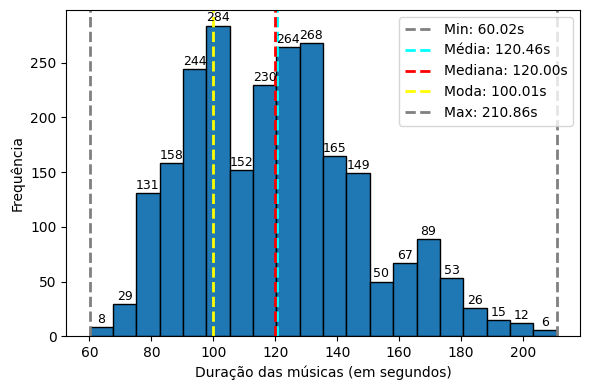

In [ ]:
# Histograma

plt.figure(figsize=(6, 4))

counts, bins, _ = plt.hist(data, edgecolor='k', bins=20)
# Adicionando números em cima de cada barra
for i, freq in enumerate(counts):
    plt.text(bins[i] + (bins[i+1] - bins[i]) / 2, freq + 1, str(int(freq)), fontsize=9, ha='center', va='bottom')
plt.xlabel('Duração das músicas (em segundos)')
plt.ylabel('Frequência')

# Linhas para cada estatística
plt.axvline(x=min_, color = 'gray', linestyle='dashed', linewidth = 2, label=f'Min: {min_:.2f}s')
plt.axvline(x=mean, color = 'cyan', linestyle='dashed', linewidth = 2, label=f'Média: {mean:.2f}s')
plt.axvline(x=median, color = 'red', linestyle='dashed', linewidth = 2, label=f'Mediana: {median:.2f}s')
plt.axvline(x=mode, color = 'yellow', linestyle='dashed', linewidth = 2, label=f'Moda: {mode:.2f}s')
plt.axvline(x=max_, color = 'gray', linestyle='dashed', linewidth = 2, label=f'Max: {max_:.2f}s')

# Adiciona uma legenda
plt.legend(loc='upper right')
plt.tight_layout()
plt.show()

A média e a mediana próximas, indicam que a maior parte das músicas está concentrada em torno de um valor central (120 segundos). Enquanto a moda à esquerda da média e da mediana, sugere que há uma maior aglomeração de faixas com duração de 100 segundos.

#### 4.1.3. Intervalo de Confiança

Vamos construir um intervalo de confiança para tempo médio das músicas em um nível de confiança de 95%.

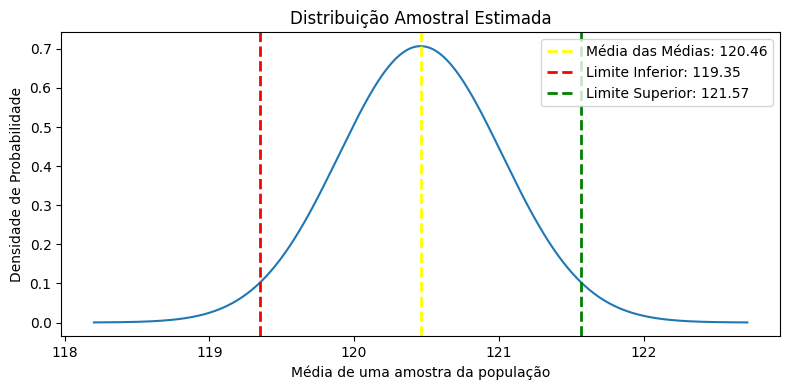

In [ ]:
#Desvio Padrão
desvio_padrao = df_pergunta1['tempo'].std()

#Número de musicas
n = len(df_pergunta1)

#Calculando o intervalo de confiança com confiança = 95%
z = 1.96
erro_padrao = desvio_padrao / (n ** 0.5)
margem_erro = z * erro_padrao
limite_inferior = round (mean - margem_erro, 2)
limite_superior = round (mean + margem_erro, 2)

std = df_pergunta1['tempo'].std()
std_AD = std / (len(df_pergunta1['tempo']) ** 0.5)
x = np.linspace(mean - 4*std_AD, mean + 4*std_AD, 1000)
y = stats.norm.pdf(x, mean, std_AD)

plt.figure(figsize=(8, 4))
plt.plot(x, y)
plt.xlabel('Média de uma amostra da população')
plt.ylabel('Densidade de Probabilidade')
plt.title('Distribuição Amostral Estimada')

plt.axvline(x=mean, color='yellow', linestyle='dashed', linewidth=2, label=f'Média das Médias: {mean:.2f}')
plt.axvline(x=limite_inferior, color='red', linestyle='dashed', linewidth=2, label=f'Limite Inferior: {limite_inferior:.2f}')
plt.axvline(x=limite_superior, color='green', linestyle='dashed', linewidth=2, label=f'Limite Superior: {limite_superior:.2f}')

plt.legend(loc='upper right')
plt.tight_layout()
plt.show()

Por fim, calcularemos a CDF (Função de Distribuição Acumulada), para descrever a probabilidade acumulada de uma variável aleatória assumir um valor menor ou igual a média.

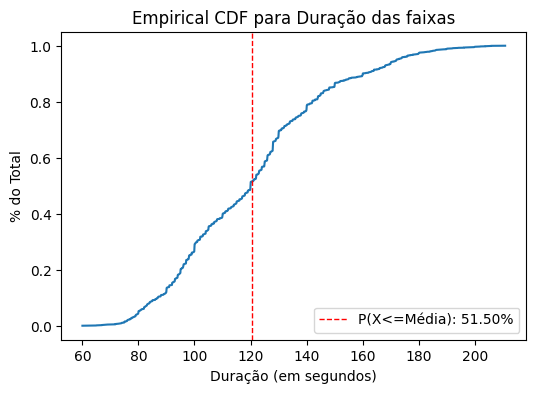

In [ ]:
plt.figure(figsize=(6, 4))

# Calculando a CDF empírica
ecdf = ECDF(df_pergunta1['tempo'])

# Porcentagem da média na CDF empírica
percentile_mean = ecdf(mean) * 100

plt.plot(ecdf.x, ecdf.y)
plt.axvline(mean, color='r', linestyle='--', linewidth=1, label=f'P(X<=Média): {percentile_mean:.2f}%')

plt.xlabel('Duração (em segundos)')
plt.ylabel('% do Total')
plt.title('Empirical CDF para Duração das faixas')
plt.legend()
plt.show()

#### 4.1.4. Bootstrap

A partir da reamostragem, vamos calcular a distribuição das médias. Em seguida estimaremos o intervalo de confiança e avaliar sua variabilidade. Ao realizarmos várias sub-amostras com reposição, a lei dos grandes números nos garante que estamos aproximando a população de interesse.

In [ ]:
col = 'tempo'
n_sub = 10000 #numero de sub-amostras
size = len(df_pergunta1) #tamanho do dataframe
values = np.zeros(n_sub) #array para armazenar as médias das sub-amostras

for i in range(n_sub):
  sample = df_pergunta1.sample(size, replace=True)

  # Lembre que podemos utilizar mediana, média ou qualquer outra estatística agregada
  # values[i] = sample[col].median()
  values[i] = sample[col].mean()

# Calculando a média das médias
media_das_medias = np.mean(values)

# Gerando valores inferior e superior para um nível de confiança de 95%
LI = np.percentile(values, 2.5)
LS = np.percentile(values, 97.5)

print('Média das Médias: {}'.format(media_das_medias.round(2)))
print('Intervalo de Confianca Empírico: [{}, {}]'.format(LI.round(2), LS.round(2)))

Média das Médias: 120.45
Intervalo de Confianca Empírico: [119.34, 121.59]


#### 4.1.5. Distribuição Amostral Empírica (Bootstrap)

O histograma mostra a frequência das médias das sub-amostras. Tal como previsto pelo Teorema Central do Limite, podemos observar que a distribuição empírica construída aproxima uma normal. Cada barra representa o número de vezes que uma determinada faixa de valores médios do tempo de duração das músicas apareceu entre as 10.000 amostras coletadas com reposição.

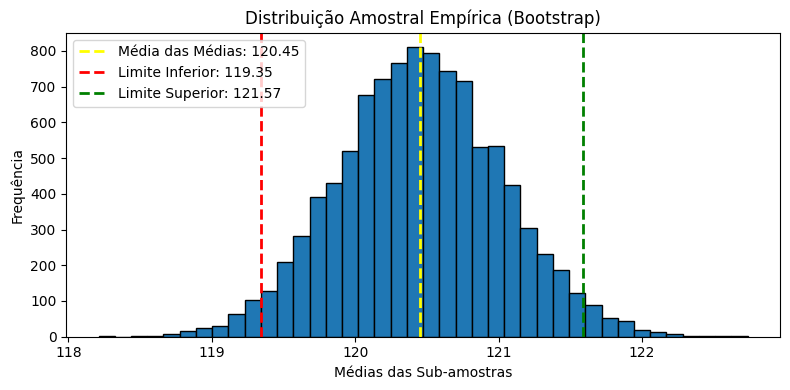

In [ ]:
plt.figure(figsize=(8, 4))

# Plot do histograma das médias das sub-amostras
plt.hist(values, bins=40, edgecolor='k')
plt.axvline(x=media_das_medias, color='yellow', linestyle='dashed', linewidth=2, label=f'Média das Médias: {media_das_medias:.2f}')
plt.axvline(x=LI, color='red', linestyle='dashed', linewidth=2, label=f'Limite Inferior: {limite_inferior:.2f}')
plt.axvline(x=LS, color='green', linestyle='dashed', linewidth=2, label=f'Limite Superior: {limite_superior:.2f}')

plt.xlabel('Médias das Sub-amostras')
plt.ylabel('Frequência')
plt.title('Distribuição Amostral Empírica (Bootstrap)')
plt.legend(loc='upper left')

plt.tight_layout()
plt.show()

Quando aplicamos o bootstrap podemos concluir que de fato o tempo das musicas populares estão em torno de 120 segundos, já que quando constratamos o bootstrap com a base de dados, não se vê diferenças significativas.

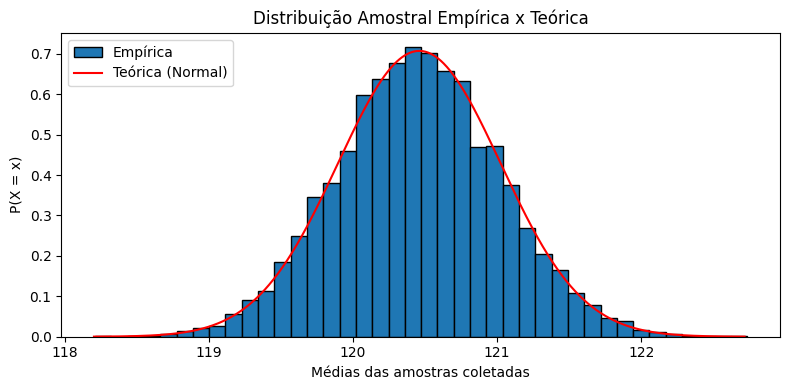

In [ ]:
plt.figure(figsize=(8, 4))

# Plot do histograma das médias das sub-amostras
plt.hist(values, bins=40, edgecolor='k', density=True, label='Empírica')

# Parâmetros da distribuição normal
std = df_pergunta1['tempo'].std()
std_AD = std / (len(df_pergunta1['tempo']) ** 0.5)
x = np.linspace(mean - 4*std_AD, mean + 4*std_AD, 1000)
y = stats.norm.pdf(x, mean, std_AD)

# Plot da distribuição normal teórica
plt.plot(x, y, label='Teórica (Normal)', color='red')

# Configurações do gráfico
plt.xlabel('Médias das amostras coletadas')
plt.ylabel('P(X = x)')
plt.title('Distribuição Amostral Empírica x Teórica')
plt.legend(loc='upper left')

plt.tight_layout()
plt.show()

Quando o bootstrap se aproxima da curva de distribuição dos dados, significa que o procedimento de reamostragem foi eficaz em capturar a variabilidade e a forma da distribuição original dos dados. A partir disso, podemos inferir as seguintes conclusões:

A amostra original é representativa da população e as reamostragens refletem bem essa representatividade. Ou seja, a duração média das faixas, de aproximadamente 120 segundos, que tem um bom ranqueamento nas plataformas de streaming, representam bem a população de músicas mais populares.

#### 4.1.6. Teste A/B: Gêneros musicais influenciam o tempo de duração das músicas?

obs: a célula abaixo demora mais ou menos 43 segundos pra rodar

In [ ]:
# Teste A/B genero influencia na duração?
import ast
a = []
for sublist in df_pergunta1['artist_genres']:
  for item in ast.literal_eval(sublist):
    a.append(item)

genres = set(a)
mean_per_genre = {}
std_per_genre = {}
size_per_genre = {}
for genre in genres:
  df_pop = df_pergunta1[df_pergunta1['artist_genres'].apply(lambda x: genre in ast.literal_eval(x))]
  mean_per_genre[genre] = df_pop['tempo'].mean()
  std_per_genre[genre] = df_pop['tempo'].std()
  size_per_genre[genre] = len(df_pop)


Considerando apenas 6 gêneros de músicas (hip hop, punk, soul, r&b, country e rock):

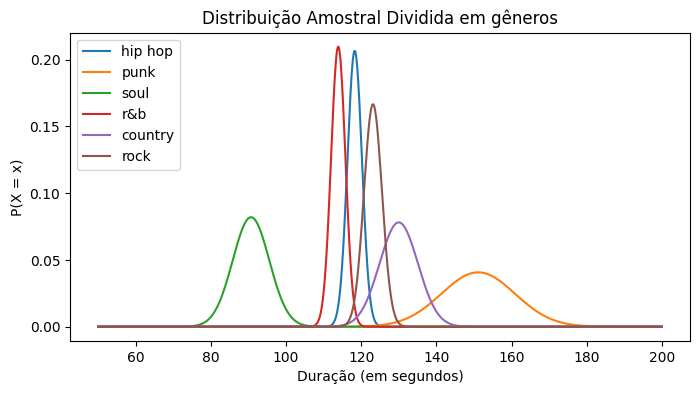

In [ ]:
min_key = max(mean_per_genre, key=lambda k: mean_per_genre[k])
min_value = mean_per_genre[min_key]
min_key, min_value

plt.figure(figsize=(8, 4))

analised_genres = ['hip hop', 'punk', 'soul','r&b', 'country', 'rock']

for genre in analised_genres:
  std_AD = std_per_genre[genre] / (size_per_genre[genre] ** 0.5)
  x = np.linspace(50,200, 1000)
  y = stats.norm.pdf(x, mean_per_genre[genre], std_AD)
  plt.plot(x, y, label=genre)

plt.xlabel('Duração (em segundos)')
plt.ylabel('P(X = x)')
plt.title('Distribuição Amostral Dividida em gêneros')
plt.legend(loc='upper left')
plt.show()

A partir do gráfico, podemos perceber que, para gêneros distintos, o tempo médio de duração das músicas muda.

#### 4.1.7. Conclusão

De acordo com o dados, a distribuição amostral está bastante concentrada em torno da média. Existe, portanto, uma tendência no mercado em produzir, na média, músicas com duração próxima de 120 segundos. Sendo raros os casos muito discrepantes. Além disso, observamos pelo teste A/B que gêneros musicais influenciam a média dos tempos de duração.

### 4.2. Pergunta 2: Quais são os artistas e músicas mais escutados? Qual o gênero mais popular?

Novamente, vamos criar um novo dataframe para manipular os dados.

In [ ]:
df_pergunta2 = df_playlist_2000to2023[['year', 'track_id', 'track_name', 'track_popularity',
       'album', 'artist_name', 'artist_genres', 'artist_popularity', 'danceability', 'energy', 'key', 'loudness',
       'mode', 'speechiness', 'acousticness', 'instrumentalness', 'liveness',
       'valence', 'tempo']].copy()
df_pergunta2.head()

,year,track_id,track_name,track_popularity,album,artist_name,artist_genres,artist_popularity,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo
0,2000,6naxalmIoLFWR0siv8dnQQ,Oops!...I Did It Again,81,Oops!... I Did It Again,Britney Spears,"['dance pop', 'pop']",81,0.751,0.834,1,-5.444,0,0.0437,0.3000,0.000018,0.3550,0.894,95.053
1,2000,2m1hi0nfMR9vdGC8UcrnwU,All The Small Things,83,Enema Of The State,blink-182,"['alternative metal', 'modern rock', 'pop punk...",79,0.434,0.897,0,-4.918,1,0.0488,0.0103,0.000000,0.6120,0.684,148.726
2,2000,3y4LxiYMgDl4RethdzpmNe,Breathe,66,Breathe,Faith Hill,"['contemporary country', 'country', 'country d...",62,0.529,0.496,7,-9.007,1,0.0290,0.1730,0.000000,0.2510,0.278,136.859
3,2000,0v1XpBHnsbkCn7iJ9Ucr1l,It's My Life,81,Crush,Bon Jovi,"['glam metal', 'rock']",79,0.551,0.913,0,-4.063,0,0.0466,0.0263,0.000013,0.3470,0.544,119.992
4,2000,62bOmKYxYg7dhrC6gH9vFn,Bye Bye Bye,75,No Strings Attached,*NSYNC,"['boy band', 'dance pop', 'pop']",70,0.610,0.926,8,-4.843,0,0.0479,0.0310,0.001200,0.0821,0.861,172.638


#### 4.2.1. Artista mais ouvido de cada ano

Com base no rank de popularidade de cada ano, vamos relacionar os artistas mais ouvidos.

In [ ]:
# Selecionando as colunas relevantes
top_artistas = df_pergunta2[['year', 'track_name',	'track_popularity', 'artist_name', 'artist_popularity']].copy()

# Encontrando o artista mais ouvido de cada ano
top_artistas_ano = top_artistas.loc[top_artistas.groupby('year')['artist_popularity'].idxmax()]
top_artistas_ano.head()

,year,track_name,track_popularity,artist_name,artist_popularity
6,2000,The Real Slim Shady,87,Eminem,90
102,2001,Stan,82,Eminem,90
201,2002,Without Me,88,Eminem,90
303,2003,Crazy In Love (feat. Jay-Z),80,Beyoncé,93
409,2004,All Falls Down,83,Kanye West,94


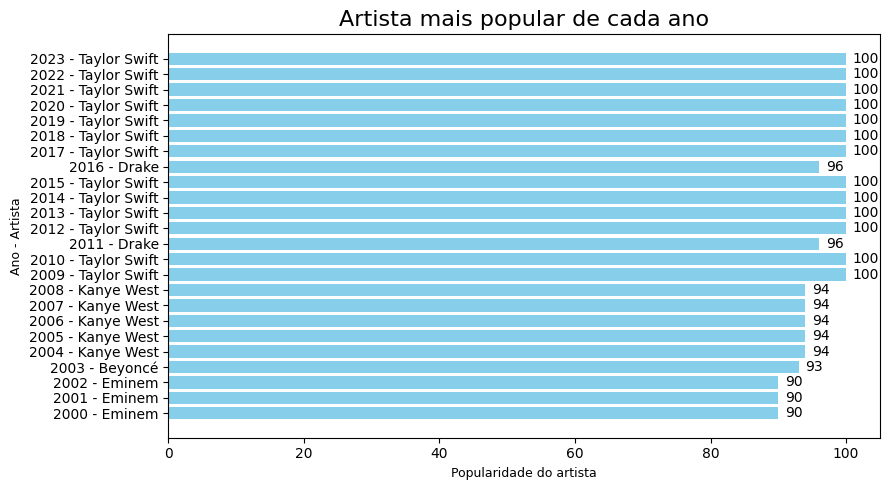

In [ ]:
# Ordenando pelo ano, do maior para o menor
top_artistas_ano = top_artistas_ano.sort_values(by='year', ascending=False)

# Criando o gráfico de barras
plt.figure(figsize=(9, 5))
plt.barh(top_artistas_ano['year'].astype(str) + " - " + top_artistas_ano['artist_name'], top_artistas_ano['artist_popularity'], color='skyblue')
plt.xlabel('Popularidade do artista', fontsize=9)
plt.ylabel('Ano - Artista', fontsize=9)
plt.title('Artista mais popular de cada ano', fontsize=16)
plt.gca().invert_yaxis()  # Inverter o eixo y para mostrar o ano mais recente no topo

# Adicionando os valores da popularidade em cada barra
for index, value in enumerate(top_artistas_ano['artist_popularity']):
    plt.text(value + 1, index, str(value), va='center', fontsize=10)

plt.tight_layout()
plt.show()

#### 4.2.2. Música mais popular de cada ano

Com base na coluna track_popularity, vamos relacionar as músicas mais populares de cada ano.

In [ ]:
# Selecionando as colunas relevantes
top_musicas = df_pergunta2[['year', 'track_name', 'track_popularity', 'artist_name', 'artist_genres', 'artist_popularity',
        'danceability', 'energy', 'key', 'loudness',
       'mode', 'speechiness', 'acousticness', 'instrumentalness', 'liveness',
       'valence', 'tempo']].copy()

# Encontrando o artista mais ouvido de cada ano
top_musicas_ano = top_musicas.loc[top_musicas.groupby('year')['track_popularity'].idxmax()]
top_musicas_ano.head()

,year,track_name,track_popularity,artist_name,artist_genres,artist_popularity,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo
9,2000,Yellow,90,Coldplay,"['permanent wave', 'pop']",88,0.429,0.661,11,-7.227,1,0.0281,0.00239,0.000121,0.234,0.285,173.372
101,2001,Murder On The Dancefloor,89,Sophie Ellis-Bextor,"['dance pop', 'europop', 'new wave pop']",73,0.730,0.849,1,-5.281,0,0.0299,0.00234,0.000026,0.312,0.887,117.310
207,2002,Murder On The Dancefloor,89,Sophie Ellis-Bextor,"['dance pop', 'europop', 'new wave pop']",73,0.730,0.849,1,-5.281,0,0.0299,0.00234,0.000026,0.312,0.887,117.310
301,2003,Seven Nation Army,85,The White Stripes,"['alternative rock', 'blues rock', 'detroit ro...",71,0.743,0.446,4,-7.807,0,0.0683,0.00390,0.118000,0.337,0.278,123.596
405,2004,Numb,87,Linkin Park,"['alternative metal', 'nu metal', 'post-grunge...",86,0.496,0.863,9,-4.153,1,0.0381,0.00460,0.000000,0.639,0.243,110.018


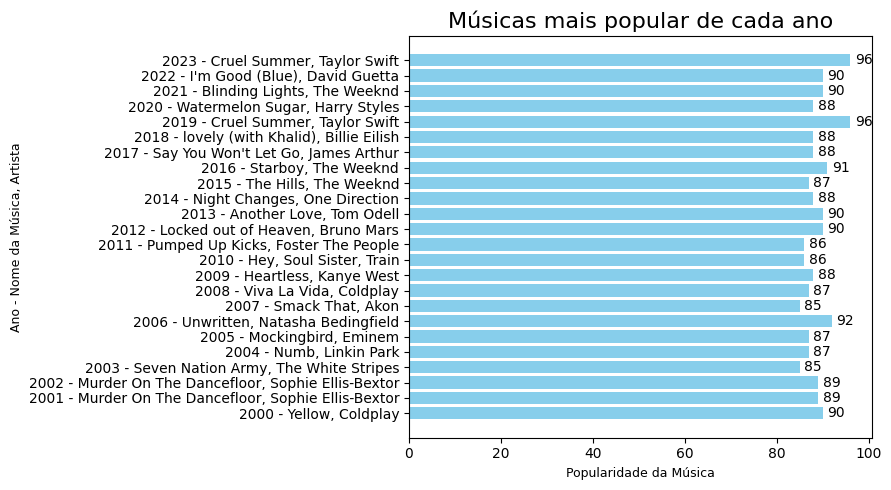

In [ ]:
#Ordernar em ordem decrescente
top_musicas_ano = top_musicas_ano.sort_values(by='year', ascending=False)

# Criando o gráfico de barras
plt.figure(figsize=(9, 5))
plt.barh(top_musicas_ano['year'].astype(str) + " - " + top_musicas_ano['track_name'] + ", " + top_musicas_ano['artist_name'],
         top_musicas_ano['track_popularity'], color='skyblue')
plt.xlabel('Popularidade da Música', fontsize=9)
plt.ylabel('Ano - Nome da Música, Artista', fontsize=9)
plt.title('Músicas mais popular de cada ano', fontsize=16)
plt.gca().invert_yaxis()  # Inverter o eixo y para mostrar o ano mais recente no topo

# Adicionando os valores da popularidade em cada barra
for index, value in enumerate(top_musicas_ano['track_popularity']):
    plt.text(value + 1, index, str(value), va='center', fontsize=10)

plt.tight_layout()
plt.show()

#### 4.2.3. Música mais popular de cada ano vs Popularidade do Artista

Nessa etapa, vamos verificar se o artista da música mais popular de cada ano é um artista já consolidado ou se pode existir novos artistas ocupando essa posição.

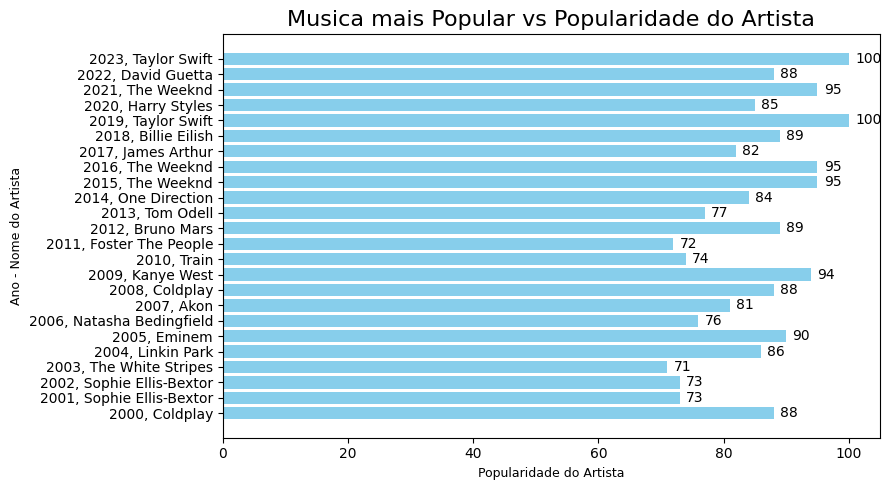

In [ ]:
top_musicas_ano = top_musicas_ano.sort_values(by='year', ascending=False)

# Criando o gráfico de barras
plt.figure(figsize=(9, 5))
plt.barh(top_musicas_ano['year'].astype(str) + ", " + top_musicas_ano['artist_name'],
         top_musicas_ano['artist_popularity'], color='skyblue')
plt.xlabel('Popularidade do Artista', fontsize=9)
plt.ylabel('Ano - Nome do Artista', fontsize=9)
plt.title('Musica mais Popular vs Popularidade do Artista', fontsize=16)
plt.gca().invert_yaxis()  # Inverter o eixo y para mostrar o ano mais recente no topo

# Adicionando os valores da popularidade em cada barra
for index, value in enumerate(top_musicas_ano['artist_popularity']):
    plt.text(value + 1, index, str(value), va='center', fontsize=10)

plt.tight_layout()
plt.show()

#### 4.2.4. Estatística dos Dados para a Popularidade dos Artistas

Agora, vamos calcular a nossa estatística dos dados da coluna Artist Popularity de todos os artistas

In [ ]:
df_pergunta2['artist_popularity'].describe()

,artist_popularity
count,2400.000000
mean,75.882500
std,12.016746
min,36.000000
25%,68.000000
50%,77.000000
75%,85.000000
max,100.000000


In [ ]:
data = df_pergunta2['artist_popularity']

min_ = round(data.min(), 2)
max_ = round(data.max(), 2)
mean = round(data.mean(), 2)
median = round(data.median(), 2)
mode = round(data.mode()[0], 2)

print(min_, max_, mean, median, mode, sep=', ')

36, 100, 75.88, 77.0, 81


#### 4.2.5. Histograma

Abaixo, plotamos o Histograma para melhor visualização

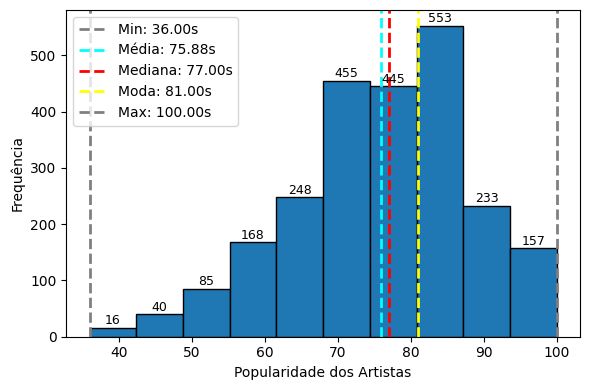

In [ ]:
# Histograma

plt.figure(figsize=(6, 4))

counts, bins, _ = plt.hist(data, edgecolor='k', bins=10)
# Adicionando números em cima de cada barra
for i, freq in enumerate(counts):
    plt.text(bins[i] + (bins[i+1] - bins[i]) / 2, freq + 1, str(int(freq)), fontsize=9, ha='center', va='bottom')
plt.xlabel('Popularidade dos Artistas')
plt.ylabel('Frequência')

# Linhas para cada estatística
plt.axvline(x=min_, color = 'gray', linestyle='dashed', linewidth = 2, label=f'Min: {min_:.2f}s')
plt.axvline(x=mean, color = 'cyan', linestyle='dashed', linewidth = 2, label=f'Média: {mean:.2f}s')
plt.axvline(x=median, color = 'red', linestyle='dashed', linewidth = 2, label=f'Mediana: {median:.2f}s')
plt.axvline(x=mode, color = 'yellow', linestyle='dashed', linewidth = 2, label=f'Moda: {mode:.2f}s')
plt.axvline(x=max_, color = 'gray', linestyle='dashed', linewidth = 2, label=f'Max: {max_:.2f}s')

# Adiciona uma legenda
plt.legend(loc='upper left')
plt.tight_layout()
plt.show()

A média e a mediana próximas, indicam que a maior parte da popularidade das músicas está concentrada em torno de um valor central (posição 75). Enquanto a moda à direita da média e da mediana, sugere que há uma maior aglomeração de faixas com popularidade ranqueadas em 81.

#### 4.2.6. Intervalo de Confiança para a Popularidade dos Artistas

Vamos construir um intervalo com nível de 95% de confiança

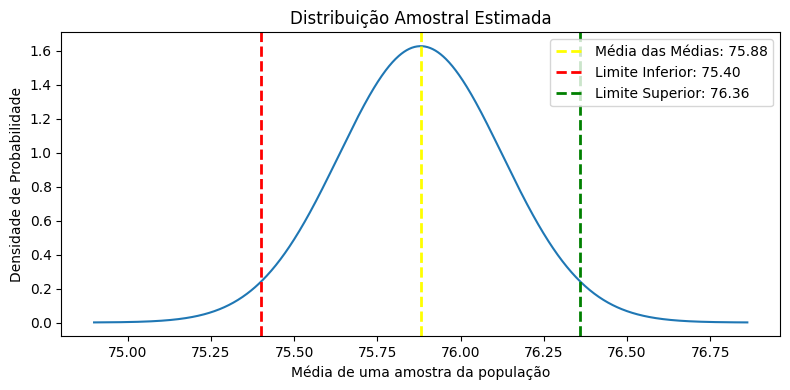

In [ ]:
#Desvio Padrão
desvio_padrao = df_pergunta2['artist_popularity'].std()

#Número de musicas
n = len(df_pergunta2)

#Calculando o intervalo de confiança com confiança = 96%
z = 1.96
erro_padrao = desvio_padrao / (n ** 0.5)
margem_erro = z * erro_padrao
limite_inferior = round (mean - margem_erro, 2)
limite_superior = round (mean + margem_erro, 2)

std = df_pergunta2['artist_popularity'].std()
std_AD = std / (len(df_pergunta2['artist_popularity']) ** 0.5)
x = np.linspace(mean - 4*std_AD, mean + 4*std_AD, 1000)
y = stats.norm.pdf(x, mean, std_AD)

plt.figure(figsize=(8, 4))
plt.plot(x, y)
plt.xlabel('Média de uma amostra da população')
plt.ylabel('Densidade de Probabilidade')
plt.title('Distribuição Amostral Estimada')

plt.axvline(x=mean, color='yellow', linestyle='dashed', linewidth=2, label=f'Média das Médias: {mean:.2f}')
plt.axvline(x=limite_inferior, color='red', linestyle='dashed', linewidth=2, label=f'Limite Inferior: {limite_inferior:.2f}')
plt.axvline(x=limite_superior, color='green', linestyle='dashed', linewidth=2, label=f'Limite Superior: {limite_superior:.2f}')

plt.legend(loc='upper right')
plt.tight_layout()
plt.show()

#### 4.2.7. Bootstrap para a Popularidade do Artista

In [ ]:
col = 'artist_popularity'
n_sub = 10000 #numero de sub-amostras
size = len(df_pergunta2) #tamanho do dataframe
values = np.zeros(n_sub) #array para armazenar as médias das sub-amostras


for i in range(n_sub):
  sample = df_pergunta2.sample(size, replace=True)

  # Lembre que podemos utilizar mediana, média ou qualquer outra estatística agregada
  # values[i] = sample[col].median()
  values[i] = sample[col].mean()

# Calculando a média das médias
media_das_medias = np.mean(values)

# Gerando valores inferior e superior para um nível de confiança de 95%
LI = np.percentile(values, 2.5)
LS = np.percentile(values, 97.5)

print('Média das Médias: {}'.format(media_das_medias.round(2)))
print('Intervalo de Confianca: [{}, {}]'.format(LI.round(2), LS.round(2)))

Média das Médias: 75.88
Intervalo de Confianca: [75.39, 76.36]


#### 4.2.8. Distribuição Amostral Empírica (Bootstrap)

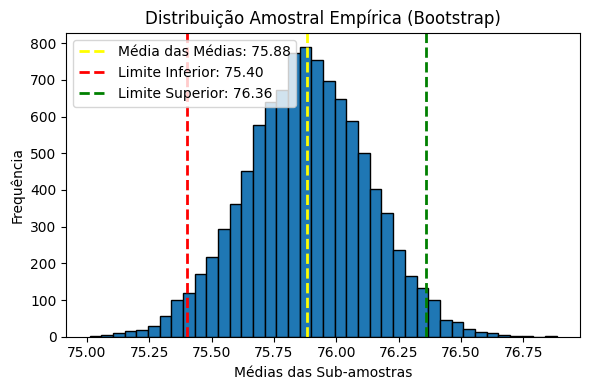

In [ ]:
plt.figure(figsize=(6, 4))

# Plot do histograma das médias das sub-amostras
plt.hist(values, bins=40, edgecolor='k')
plt.axvline(x=media_das_medias, color='yellow', linestyle='dashed', linewidth=2, label=f'Média das Médias: {media_das_medias:.2f}')
plt.axvline(x=limite_inferior, color='red', linestyle='dashed', linewidth=2, label=f'Limite Inferior: {limite_inferior:.2f}')
plt.axvline(x=limite_superior, color='green', linestyle='dashed', linewidth=2, label=f'Limite Superior: {limite_superior:.2f}')

plt.xlabel('Médias das Sub-amostras')
plt.ylabel('Frequência')
plt.title('Distribuição Amostral Empírica (Bootstrap)')
plt.legend(loc='upper left')

plt.tight_layout()
plt.show()

Quando aplicamos o bootstrap podemos concluir que de fato os artistas das musicas populares são bem ranqueados no spotify, já que quando constratamos o bootstrap com a base de dados, não se vê diferenças significativas.

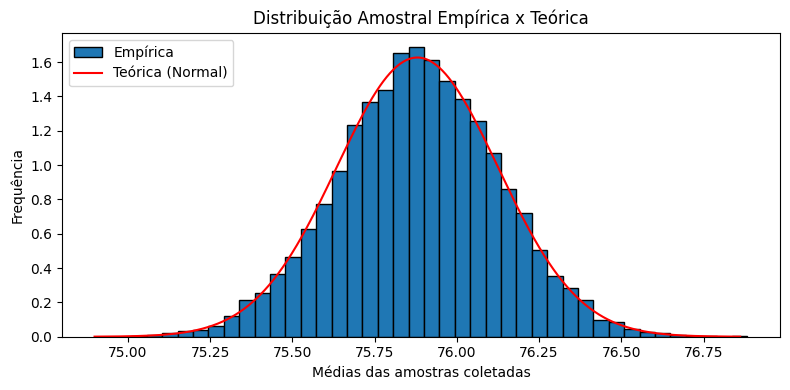

In [ ]:
plt.figure(figsize=(8, 4))

# Plot do histograma das médias das sub-amostras
plt.hist(values, bins=40, edgecolor='k', density=True, label='Empírica')

# Parâmetros da distribuição normal
std = df_pergunta2['artist_popularity'].std()
std_AD = std / (len(df_pergunta2['artist_popularity']) ** 0.5)
x = np.linspace(mean - 4*std_AD, mean + 4*std_AD, 1000)
y = stats.norm.pdf(x, mean, std_AD)

# Plot da distribuição normal teórica
plt.plot(x, y, label='Teórica (Normal)', color='red')

# Configurações do gráfico
plt.xlabel('Médias das amostras coletadas')
plt.ylabel('Frequência')
plt.title('Distribuição Amostral Empírica x Teórica')
plt.legend(loc='upper left')

plt.tight_layout()
plt.show()

Quando o bootstrap se aproxima da curva de distribuição dos dados, significa que o procedimento de reamostragem foi eficaz em capturar a variabilidade e a forma da distribuição original dos dados. A partir disso, podemos inferir as seguintes conclusões:

A amostra original é representativa da população e as reamostragens refletem bem essa representatividade. Ou seja, a popularidade do artista, de aproximadamente 75, das músicas que tem um bom ranqueamento nas plataformas de streaming, representam bem a popularidade dos artistas das músicas mais populares.

#### 4.2.9. Gêneros mais escutados

Para este campo, vamos observar os dados da música popular de cada ano. Além disso, precisamos normalizar os dados da coluna artist_genres, por isso agrupamos os seguintes gêneros:
- **pop:** boy band, talent show, neo mellow, uk pop, dance pop, post-teen pop;
- **alternative rock:** modern rock, modern alternative rock, alternative rock, blues rock, detroit rock, garage rock, modern blues rock, permanent wave, punk blues, rock, indietronica, alternative metal, nu metal, post-grunge, rap metal;
- **hip hop:** chicago rap, rap, detroit hip hop;
- **r&b:** canadian contemporary r&b ;
- **edm:** big room, pop dance;
- **alternative pop:** art pop, chill pop;

In [ ]:
#converte uma string que representa uma lista de gêneros em uma lista real de strings
def convert_to_list(genres):
    try:
        return ast.literal_eval(genres)
    except (ValueError, SyntaxError):
        return [genres]

#Fazendo uma copia do df para facilitar a manipulação
copia_TopMusicasAno = top_musicas_ano.copy()

#Convertendo as strings em listas
copia_TopMusicasAno['artist_genres'] = copia_TopMusicasAno['artist_genres'].apply(convert_to_list)

#Expansão da Coluna de Gêneros - transformar cada elemento da lista na coluna artist_genres em uma nova linha, mantendo as outras colunas iguais.
df_exploded = copia_TopMusicasAno.explode('artist_genres')

'''Normalizando a base'''
# Substituindo alguns gêneros para 'pop'
df_exploded.loc[df_exploded['artist_genres'].str.contains('boy band|talent show|neo mellow|uk pop|dance pop|post-teen pop', case=False, na=False), 'artist_genres'] = 'pop'
# Substituindo alguns gêneros para 'alternative rock'
df_exploded.loc[df_exploded['artist_genres'].str.contains('modern rock|modern alternative rock|alternative rock|blues rock|detroit rock|garage rock|modern blues rock|permanent wave|punk blues|rock|indietronica|alternative metal|nu metal|post-grunge|rap metal',
                                                          case=False, na=False), 'artist_genres'] = 'alternative rock'
# Substituindo alguns gêneros para 'hip hop'
df_exploded.loc[df_exploded['artist_genres'].str.contains('chicago rap|rap|detroit hip hop', case=False, na=False), 'artist_genres'] = 'hip hop'
# Substituindo alguns gêneros para 'r&b'
df_exploded.loc[df_exploded['artist_genres'].str.contains('canadian contemporary r&b', case=False, na=False), 'artist_genres'] = 'r&b'
# Substituindo alguns gêneros para 'edm'
df_exploded.loc[df_exploded['artist_genres'].str.contains('big room|pop dance', case=False, na=False), 'artist_genres'] = 'edm'
# Substituindo alguns gêneros para 'alternative pop'
df_exploded.loc[df_exploded['artist_genres'].str.contains('art pop|chill pop', case=False, na=False), 'artist_genres'] = 'alternative pop'

#Remoção de Espaços Extras
df_exploded['artist_genres'] = df_exploded['artist_genres'].str.strip()
# Agrupando novamente por música e mantendo apenas a primeira linha de cada música
df_exploded = df_exploded.groupby(['track_name', 'year']).first().reset_index()

df_exploded = df_exploded.sort_values(by=['year', 'track_popularity'], ascending=[False, False])

df_exploded.head()

,track_name,year,track_popularity,artist_name,artist_genres,artist_popularity,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo
3,Cruel Summer,2023,96,Taylor Swift,pop,100,0.552,0.702,9,-5.707,1,0.1570,0.11700,0.000021,0.1050,0.564,169.994
6,I'm Good (Blue),2022,90,David Guetta,edm,88,0.561,0.965,7,-3.673,0,0.0343,0.00383,0.000007,0.3710,0.304,128.040
1,Blinding Lights,2021,90,The Weeknd,r&b,95,0.514,0.730,1,-5.934,1,0.0598,0.00146,0.000095,0.0897,0.334,171.005
21,Watermelon Sugar,2020,88,Harry Styles,pop,85,0.548,0.816,0,-4.209,1,0.0465,0.12200,0.000000,0.3350,0.557,95.390
2,Cruel Summer,2019,96,Taylor Swift,pop,100,0.552,0.702,9,-5.707,1,0.1570,0.11700,0.000021,0.1050,0.564,169.994


Agora, vamos plotar o gráfico dos gêneros que são mais frequentes nas músicas populares

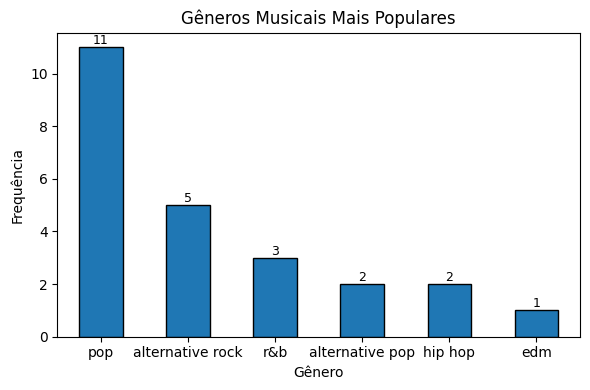

In [ ]:
# Contagem de gêneros
genre_counts = df_exploded['artist_genres'].value_counts().sort_values(ascending=False)

# Plotagem do gráfico
plt.figure(figsize=(6, 4))
ax = genre_counts.plot(kind='bar', edgecolor='k')
plt.title('Gêneros Musicais Mais Populares')
plt.xlabel('Gênero')
plt.ylabel('Frequência')
plt.xticks(rotation=360)

# Adicionar rótulos de quantidade em cima de cada barra
for i, freq in enumerate(genre_counts.values):
    plt.text(i, freq, str(int(freq)), fontsize=9, ha='center', va='bottom')

plt.tight_layout()
plt.show()

### 4.3. Pergunta 3: Quais são as características musicais mais distintas dos gêneros mais populares?

#### 4.3.1. Gêneros e características distintas

Para esta pergunta, vamos analisar o dataframe contendo a música popular de cada ano e seu respectivo gênero.

In [ ]:
# Agrupando por gênero e calculando a média das características de cada genero
df_genre_means = df_exploded.groupby('artist_genres')[['danceability', 'energy', 'key', 'loudness', 'speechiness', 'instrumentalness', 'valence', 'tempo']].mean().reset_index()
df_genre_means.head(10)

,artist_genres,danceability,energy,key,loudness,speechiness,instrumentalness,valence,tempo
0,alternative pop,0.398000,0.416500,4.000000,-9.320500,0.036650,0.000008,0.125500,119.026500
1,alternative rock,0.577400,0.659400,6.800000,-6.430200,0.038480,0.046625,0.437600,134.595200
2,edm,0.561000,0.965000,7.000000,-3.673000,0.034300,0.000007,0.304000,128.040000
3,hip hop,0.713500,0.662500,5.000000,-4.890500,0.201000,0.000000,0.454000,86.019000
4,pop,0.653273,0.738273,4.909091,-5.585364,0.062491,0.000008,0.685273,121.367000
5,r&b,0.592667,0.627000,2.666667,-6.670667,0.129100,0.000034,0.319000,156.670333


In [ ]:
# Lista de características
features = ['danceability', 'energy', 'key', 'loudness', 'speechiness', 'instrumentalness', 'valence', 'tempo']


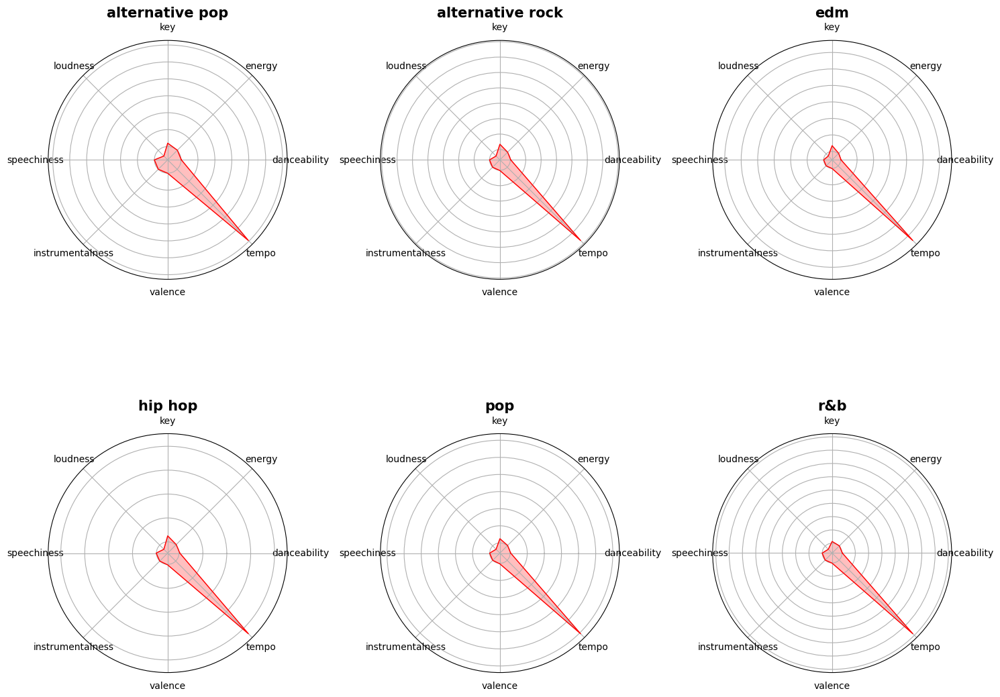

In [ ]:
# Número de características
num_features = len(features)

# Gerando um gráfico de radar para cada gênero
num_genres = len(df_genre_means)
num_rows = (num_genres + 2) // 3  # Calculando o número de linhas necessário

fig, axs = plt.subplots(num_rows, 3, figsize=(15, num_rows * 6), subplot_kw=dict(polar=True))
axs = axs.flatten()

for i, (idx, row) in enumerate(df_genre_means.iterrows()):

    # Gênero
    genre = row['artist_genres']

    # Valores das características
    values = row[features].values

    # Criando um gráfico de radar
    angles = np.linspace(0, 2 * np.pi, num_features, endpoint=False).tolist()
    values = np.concatenate((values, [values[0]]))
    angles += angles[:1]

    ax = axs[i]
    ax.fill(angles, values, color='red', alpha=0.25)
    ax.plot(angles, values, color='red', linewidth=1, linestyle='solid')
    ax.set_yticklabels([])
    ax.set_xticks(angles[:-1])
    ax.set_xticklabels(features)
    ax.set_title(f'{genre}', weight='bold', size=15, color='black', loc='center')

# Removendo eixos vazios
for i in range(num_genres, num_rows * 3):
    fig.delaxes(axs[i])

plt.tight_layout()
plt.show()

Como as variáveis 'key', 'loudness', 'instrumentalness' e 'tempo' estão em escalas diferentes, o gráfico de  radar acaba não representando muito bem as distinções dos gêneros.
Por isso, vamos normalizar estas colunas e plotar o gráfico de radar novamente.

Observamos também que a variável loudnesse, apresenta valores muito baixos. Isso se deve ao fato de que ela representa à percepção subjetiva da intensidade do som, ou seja, como alto ou baixo um som é percebido pelo ouvinte. Embora a intensidade física do som seja medida em decibéis, a loudness é influenciada por diversos fatores psicoacústicos, como a sensibilidade auditiva, a frequência do som e a duração da exposição, por isso o aumento é não linear. A normalização de intensidade ajusta o volume das músicas para um nível uniforme, melhorando a experiência de escuta, por isso os valores dessa variável são tão baixos.

Fonte: [Spotify loudness-normalization](https://support.spotify.com/br-pt/artists/article/loudness-normalization/)

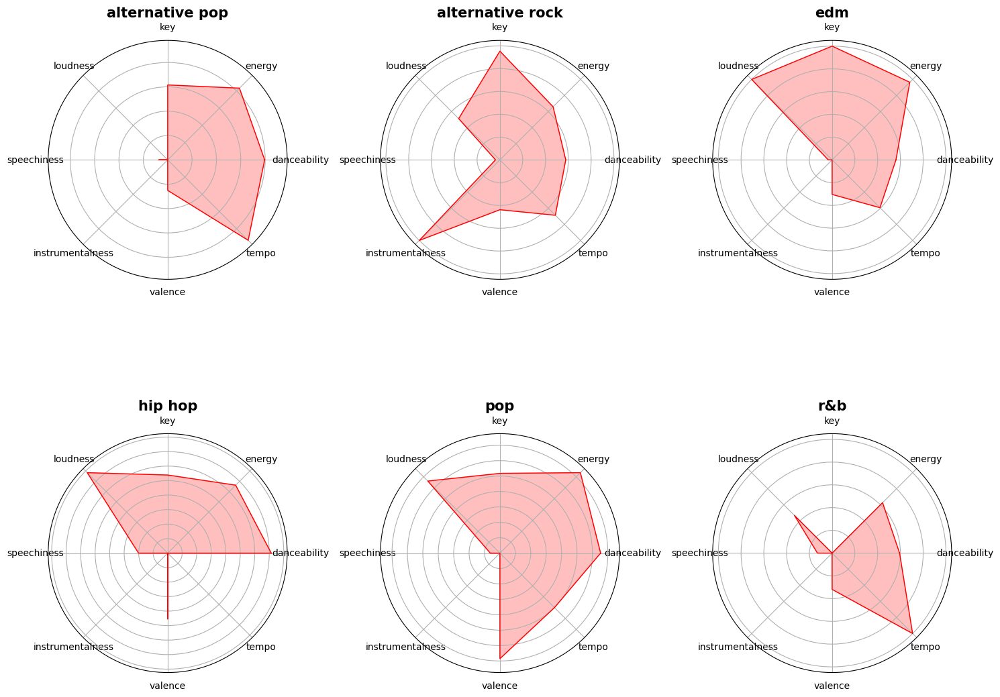

In [ ]:
# Lista de características
features = ['danceability', 'energy', 'key', 'loudness', 'speechiness', 'instrumentalness', 'valence', 'tempo']
# Inicializa o escalador MinMax
scaler = MinMaxScaler()

# Colunas a serem normalizadas
columns_to_normalize = ['key', 'loudness', 'instrumentalness', 'tempo']

# Aplica a normalização somente às colunas especificadas
df_genre_means[columns_to_normalize] = scaler.fit_transform(df_genre_means[columns_to_normalize])

# Número de características
num_features = len(features)

# Gerando um gráfico de radar para cada gênero
num_genres = len(df_genre_means)
num_rows = (num_genres + 2) // 3  # Calculando o número de linhas necessário

fig, axs = plt.subplots(num_rows, 3, figsize=(15, num_rows * 6), subplot_kw=dict(polar=True))
axs = axs.flatten()

for i, (idx, row) in enumerate(df_genre_means.iterrows()):

    # Gênero
    genre = row['artist_genres']

    # Valores das características
    values = row[features].values

    # Criando um gráfico de radar
    angles = np.linspace(0, 2 * np.pi, num_features, endpoint=False).tolist()
    values = np.concatenate((values, [values[0]]))
    angles += angles[:1]

    ax = axs[i]
    ax.fill(angles, values, color='red', alpha=0.25)
    ax.plot(angles, values, color='red', linewidth=1, linestyle='solid')
    ax.set_yticklabels([])
    ax.set_xticks(angles[:-1])
    ax.set_xticklabels(features)
    ax.set_title(f'{genre}', weight='bold', size=15, color='black', loc='center')

# Removendo eixos vazios
for i in range(num_genres, num_rows * 3):
    fig.delaxes(axs[i])

plt.tight_layout()
plt.show()

#### 4.3.2. Conclusão

Nesta etapa, podemos observar que cada gênero musical possui características distintas. O gênero 'hip hop' destaca-se pela maior danceability e speechiness, enquanto o 'edm' exibe a maior energia e o tom 'key' mais agudo. Por outro lado, 'alternative pop' apresenta os menores valores de loudness. 'Alternative rock' se destaca pelos maiores índices de instrumentalness e o gênero 'pop' possui a maior valence.
Por fim, o gênero r&b é o que apresenta a maior duração de tempo das músicas.

### 4.4. Pergunta 4: O que produz um sucesso musical? Quais são as características musicais mais comuns em músicas populares?

Vamos criar um novo dataframe para manipular os dados.

In [ ]:
df_pergunta4 = df_playlist_2000to2023[['year', 'track_name', 'track_popularity',
       'album', 'artist_name', 'artist_genres', 'artist_popularity', 'danceability', 'energy', 'key', 'loudness',
       'mode', 'speechiness', 'acousticness', 'instrumentalness', 'liveness',
       'valence', 'tempo']].copy()
df_pergunta4.head()

,year,track_name,track_popularity,album,artist_name,artist_genres,artist_popularity,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo
0,2000,Oops!...I Did It Again,81,Oops!... I Did It Again,Britney Spears,"['dance pop', 'pop']",81,0.751,0.834,1,-5.444,0,0.0437,0.3000,0.000018,0.3550,0.894,95.053
1,2000,All The Small Things,83,Enema Of The State,blink-182,"['alternative metal', 'modern rock', 'pop punk...",79,0.434,0.897,0,-4.918,1,0.0488,0.0103,0.000000,0.6120,0.684,148.726
2,2000,Breathe,66,Breathe,Faith Hill,"['contemporary country', 'country', 'country d...",62,0.529,0.496,7,-9.007,1,0.0290,0.1730,0.000000,0.2510,0.278,136.859
3,2000,It's My Life,81,Crush,Bon Jovi,"['glam metal', 'rock']",79,0.551,0.913,0,-4.063,0,0.0466,0.0263,0.000013,0.3470,0.544,119.992
4,2000,Bye Bye Bye,75,No Strings Attached,*NSYNC,"['boy band', 'dance pop', 'pop']",70,0.610,0.926,8,-4.843,0,0.0479,0.0310,0.001200,0.0821,0.861,172.638


Para essa sessão vamos analisar as variáveis das músicas, bem como a popularidade das músicas do nosso banco de dados.

#### 4.4.1. Funções que utilizaremos nesta Seção

##### 4.4.1.1. Função para calcular estatística dos dados

In [ ]:
def estatistica (df, atributo):
  data = df[atributo]

  min_ = data.min()
  max_ = data.max()
  mean = data.mean()
  median = data.median()
  mode = data.mode().iloc[0]

  return min_, max_, mean, median, mode

##### 4.4.1.2. Função para calcular o Intervalo de Confiança

Vamos construir um intervalo de confiança para alguns atributos, em um nível de confiança de 95%.

In [ ]:
#Função para calcular o intervalo de confiança
def intervalo (df, atributo):

  #Media
  mean = df[atributo].mean()
  #Desvio Padrão
  desvio_padrao = df[atributo].std()

  #Número de musicas
  n = len(df)

  #Calculando o intervalo de confiança com confiança = 96%
  z = 1.96
  erro_padrao = desvio_padrao / (n ** 0.5)
  margem_erro = z * erro_padrao
  limite_inferior = round (mean - margem_erro, 2)
  limite_superior = round (mean + margem_erro, 2)

  return limite_inferior, limite_superior

##### 4.4.1.3. Função para o Bootstrap

In [ ]:
def bootstrap(df, coluna):
  col = coluna
  n_sub = 10000 #numero de sub-amostras
  size = len(df) #tamanho do dataframe
  values = np.zeros(n_sub) #array para armazenar as médias das sub-amostras


  for i in range(n_sub):
    sample = df.sample(size, replace=True)

    # Lembre que podemos utilizar mediana, média ou qualquer outra estatística agregada
    # values[i] = sample[col].median()
    values[i] = sample[col].mean()

  # Calculando a média das médias
  media_das_medias = np.mean(values)

  # Gerando valores inferior e superior para um nível de confiança de 95%
  limite_inferior = np.percentile(values, 2.5)
  limite_superior = np.percentile(values, 97.5)

  return media_das_medias, limite_inferior, limite_superior, values

##### 4.4.1.4. Função para desenhar o gráfico do Bootstrap

In [ ]:
def analise_bootstrap(df, coluna):
    media, LI, LS, values = bootstrap(df, coluna)

    # Cálculo dos valores
    print(f'{coluna.capitalize()}')
    print(f'Média das Médias: {media.round(2)}')
    print(f'Intervalo de Confiança: [{LI.round(2)}, {LS.round(2)}]')

    # Configuração da figura e eixos
    fig, axes = plt.subplots(1, 2, figsize=(12, 4))  # 1 linha e 2 colunas

    '''Primeiro gráfico: Histograma das médias das sub-amostras'''
    axes[0].hist(values, bins=40, edgecolor='k')
    axes[0].axvline(x=media, color='yellow', linestyle='dashed', linewidth=2, label=f'Média das Médias: {media:.2f}')
    axes[0].axvline(x=LI, color='red', linestyle='dashed', linewidth=2, label=f'Limite Inferior: {LI:.2f}')
    axes[0].axvline(x=LS, color='green', linestyle='dashed', linewidth=2, label=f'Limite Superior: {LS:.2f}')
    axes[0].set_xlabel('Médias das Sub-amostras')
    axes[0].set_ylabel('Frequência')
    axes[0].set_title('Distribuição das Médias das Sub-amostras (Bootstrap)')
    axes[0].legend(loc='upper left')

    '''Segundo gráfico: Distribuição amostral empírica vs teórica'''
    axes[1].hist(values, bins=40, edgecolor='k', density=True, label='Empírica')

    # Parâmetros da distribuição normal
    mean = df[coluna].mean()
    std = df[coluna].std()
    std_AD = std / (len(df[coluna]) ** 0.5)
    x = np.linspace(mean - 4 * std_AD, mean + 4 * std_AD, 1000)
    y = stats.norm.pdf(x, mean, std_AD)

    # Plot da distribuição normal teórica
    axes[1].plot(x, y, label='Teórica (Normal)', color='red')

    # Configurações do gráfico
    axes[1].set_xlabel('Médias das amostras coletadas')
    axes[1].set_ylabel('P(X = x)')
    axes[1].set_title('Distribuição Amostral Empírica x Teórica')
    axes[1].legend(loc='upper left')

    # Ajuste final e exibição
    plt.tight_layout()
    plt.show()

#### 4.4.3. Popularidade da música

##### 4.4.3.1. Estatística dos dados

Vamos calcular os valores e compara-los através do histograma.

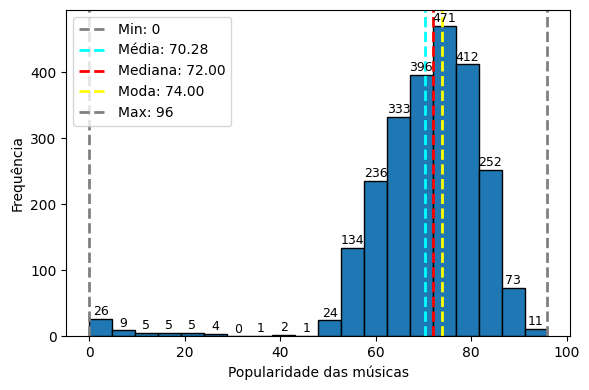

In [ ]:
min_, max_, mean, median, mode = estatistica(df_pergunta4, 'track_popularity')

# Definindo o tamanho da figura antes de plotar
plt.figure(figsize=(6, 4))

# Histograma
counts, bins, _ = plt.hist(df_pergunta4 ['track_popularity'], edgecolor='k', bins=20)
# Adicionando números em cima de cada barra
for i, freq in enumerate(counts):
    plt.text(bins[i] + (bins[i+1] - bins[i]) / 2, freq + 1, str(int(freq)), fontsize=9, ha='center', va='bottom')
plt.xlabel('Popularidade das músicas')
plt.ylabel('Frequência')

# Linhas para cada estatística
plt.axvline(x=min_, color = 'gray', linestyle='dashed', linewidth = 2, label=f'Min: {min_:.0f}')
plt.axvline(x=mean, color = 'cyan', linestyle='dashed', linewidth = 2, label=f'Média: {mean:.2f}')
plt.axvline(x=median, color = 'red', linestyle='dashed', linewidth = 2, label=f'Mediana: {median:.2f}')
plt.axvline(x=mode, color = 'yellow', linestyle='dashed', linewidth = 2, label=f'Moda: {mode:.2f}')
plt.axvline(x=max_, color = 'gray', linestyle='dashed', linewidth = 2, label=f'Max: {max_:.0f}')

# Adiciona uma legenda
plt.legend()

# Mostra o gráfico
plt.tight_layout()
plt.show()

A média e a mediana próximas, indicam que a maior parte da popularidade das músicas está concentrada em torno de um valor central (70). Enquanto a moda à direita da média e da mediana, sugere que há uma maior aglomeração de faixas com popularidade 74.

##### 4.4.3.2. Intervalo de confiança da popularidade das músicas

Vamos construir um intervalo de confiança em um nível de confiança de 95%.

In [ ]:
LI, LS = intervalo(df_pergunta4, 'track_popularity')
print ('Intervalos de confiança da popularidade das músicas: [{}, {}]'.format(LI.round(2), LS.round(2)))

Intervalos de confiança da popularidade das músicas: [69.76, 70.8]


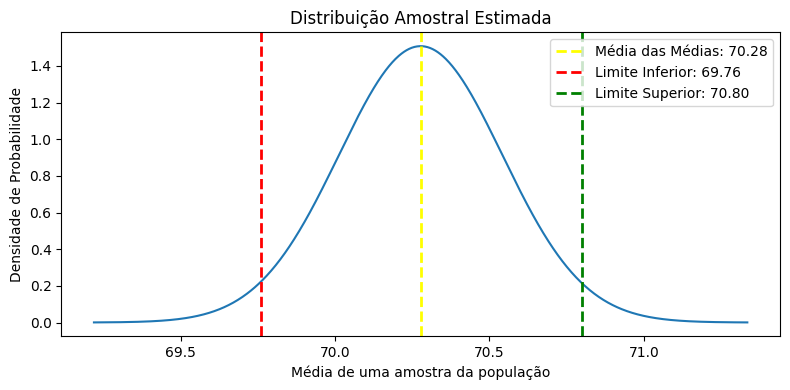

In [ ]:
#Número de musicas
n = len(df_pergunta4)

std = df_pergunta4['track_popularity'].std()
std_AD = std / (len(df_pergunta4['track_popularity']) ** 0.5)
x = np.linspace(mean - 4*std_AD, mean + 4*std_AD, 1000)
y = stats.norm.pdf(x, mean, std_AD)

plt.figure(figsize=(8, 4))
plt.plot(x, y)
plt.xlabel('Média de uma amostra da população')
plt.ylabel('Densidade de Probabilidade')
plt.title('Distribuição Amostral Estimada')

plt.axvline(x=mean, color='yellow', linestyle='dashed', linewidth=2, label=f'Média das Médias: {mean:.2f}')
plt.axvline(x=LI, color='red', linestyle='dashed', linewidth=2, label=f'Limite Inferior: {LI:.2f}')
plt.axvline(x=LS, color='green', linestyle='dashed', linewidth=2, label=f'Limite Superior: {LS:.2f}')

plt.legend(loc='upper right')
plt.tight_layout()
plt.show()

##### 4.4.3.3. Bootstrap

A partir da reamostragem, vamos calcular a distribuição das médias. Em seguida estimaremos o intervalo de confiança e avaliar sua variabilidade.

In [ ]:
media, LI, LS, values = bootstrap(df_pergunta4, 'track_popularity')
print('Média das Médias: {}'.format(media.round(2)))
print('Intervalo de Confianca: [{}, {}]'.format(LI.round(2), LS.round(2)))

Média das Médias: 70.28
Intervalo de Confianca: [69.74, 70.8]


##### 4.4.3.4. Distribuição Amostral Empírica (Bootstrap)

O histograma mostra a frequência das médias das sub-amostras. Cada barra representa o número de vezes que uma determinada faixa de valores médios do tempo de duração das músicas apareceu entre as 10.000 sub-amostras.

Track_popularity
Média das Médias: 70.28
Intervalo de Confiança: [69.74, 70.8]


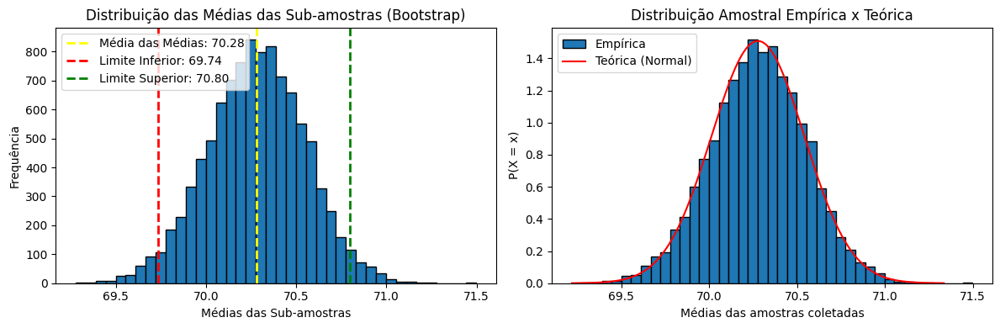

In [ ]:
analise_bootstrap(df_pergunta4, 'track_popularity')

Quando aplicamos o bootstrap podemos concluir que de fato as musicas mais populares do spotify estão, média, na posição 70, já que ao constratamos o bootstrap com a base de dados, não se vê diferenças significativas.

#### 4.4.4. Características das músicas

##### 4.4.4.1. Estatística dos dados

Vamos calcular os valores e compara-los através do histograma.

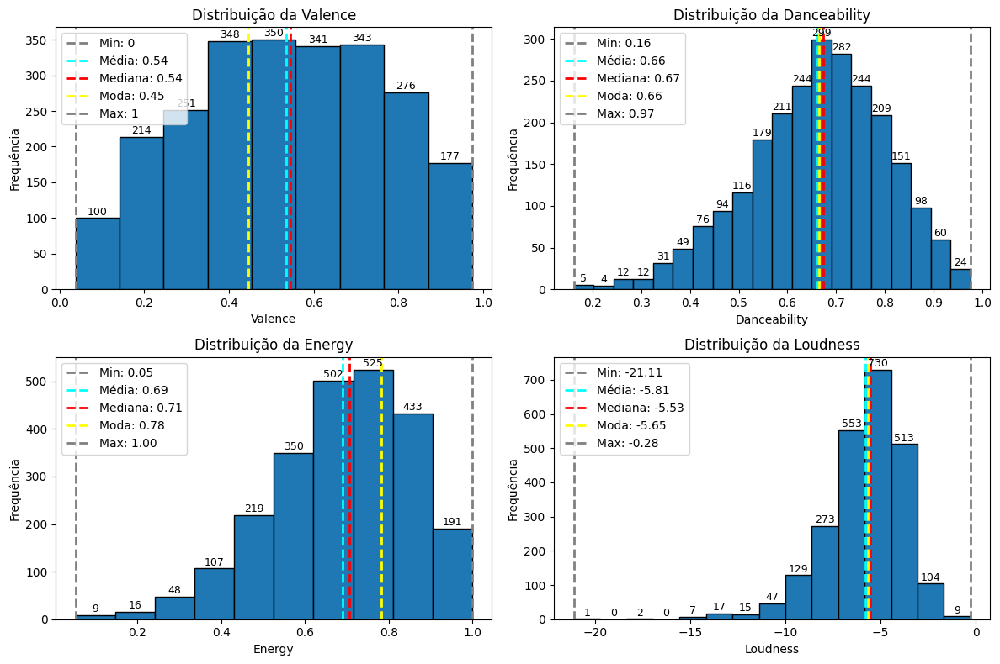

In [ ]:
# Set up the matplotlib figure
fig, axes = plt.subplots(2, 2, figsize=(12, 8))

'''Distribuição da Valence'''
# Calculando as estatísticas
min_, max_, mean, median, mode = estatistica(df_pergunta4, 'valence')
axes[0, 0].set_title('Distribuição da Valence')
axes[0, 0].set_xlabel('Valence')
axes[0, 0].set_ylabel('Frequência')

# Adicionando números em cima de cada barra
counts, bins, _ = axes[0, 0].hist(df_pergunta4['valence'], bins=9, edgecolor='black')
for i, freq in enumerate(counts):
    axes[0, 0].text(bins[i] + (bins[i+1] - bins[i]) / 2, freq + 1, str(int(freq)), fontsize=9, ha='center', va='bottom')
# Linhas para cada estatística
axes[0, 0].axvline(x=min_, color='gray', linestyle='dashed', linewidth=2, label=f'Min: {min_:.0f}')
axes[0, 0].axvline(x=mean, color='cyan', linestyle='dashed', linewidth=2, label=f'Média: {mean:.2f}')
axes[0, 0].axvline(x=median, color='red', linestyle='dashed', linewidth=2, label=f'Mediana: {median:.2f}')
axes[0, 0].axvline(x=mode, color='yellow', linestyle='dashed', linewidth=2, label=f'Moda: {mode:.2f}')
axes[0, 0].axvline(x=max_, color='gray', linestyle='dashed', linewidth=2, label=f'Max: {max_:.0f}')
# Adiciona uma legenda
axes[0, 0].legend(loc='upper left')

'''Distribuição da Danceability'''
# Calculando as estatísticas
min_, max_, mean, median, mode = estatistica(df_pergunta4, 'danceability')
axes[0, 1].set_title('Distribuição da Danceability')
axes[0, 1].set_xlabel('Danceability')
axes[0, 1].set_ylabel('Frequência')

# Adicionando números em cima de cada barra
counts, bins, _ = axes[0, 1].hist(df_pergunta4['danceability'], bins=20, edgecolor='black')
for i, freq in enumerate(counts):
    axes[0, 1].text(bins[i] + (bins[i+1] - bins[i]) / 2, freq + 1, str(int(freq)), fontsize=9, ha='center', va='bottom')
# Linhas para cada estatística
axes[0, 1].axvline(x=min_, color='gray', linestyle='dashed', linewidth=2, label=f'Min: {min_:.2f}')
axes[0, 1].axvline(x=mean, color='cyan', linestyle='dashed', linewidth=2, label=f'Média: {mean:.2f}')
axes[0, 1].axvline(x=median, color='red', linestyle='dashed', linewidth=2, label=f'Mediana: {median:.2f}')
axes[0, 1].axvline(x=mode, color='yellow', linestyle='dashed', linewidth=2, label=f'Moda: {mode:.2f}')
axes[0, 1].axvline(x=max_, color='gray', linestyle='dashed', linewidth=2, label=f'Max: {max_:.2f}')
# Adiciona uma legenda
axes[0, 1].legend(loc='upper left')

'''Distribuição da Energy'''
# Calculando as estatísticas
min_, max_, mean, median, mode = estatistica(df_pergunta4, 'energy')
axes[1, 0].set_title('Distribuição da Energy')
axes[1, 0].set_xlabel('Energy')
axes[1, 0].set_ylabel('Frequência')

# Adicionando números em cima de cada barra
counts, bins, _ = axes[1, 0].hist(df_pergunta4['energy'], bins=10, edgecolor='black')
for i, freq in enumerate(counts):
    axes[1, 0].text(bins[i] + (bins[i+1] - bins[i]) / 2, freq + 1, str(int(freq)), fontsize=9, ha='center', va='bottom')
# Linhas para cada estatística
axes[1, 0].axvline(x=min_, color='gray', linestyle='dashed', linewidth=2, label=f'Min: {min_:.2f}')
axes[1, 0].axvline(x=mean, color='cyan', linestyle='dashed', linewidth=2, label=f'Média: {mean:.2f}')
axes[1, 0].axvline(x=median, color='red', linestyle='dashed', linewidth=2, label=f'Mediana: {median:.2f}')
axes[1, 0].axvline(x=mode, color='yellow', linestyle='dashed', linewidth=2, label=f'Moda: {mode:.2f}')
axes[1, 0].axvline(x=max_, color='gray', linestyle='dashed', linewidth=2, label=f'Max: {max_:.2f}')
# Adiciona uma legenda
axes[1, 0].legend(loc='upper left')

'''Distribuição da Loudness'''
# Calculando as estatísticas
min_, max_, mean, median, mode = estatistica(df_pergunta4, 'loudness')
axes[1, 1].set_title('Distribuição da Loudness')
axes[1, 1].set_xlabel('Loudness')
axes[1, 1].set_ylabel('Frequência')

# Adicionando números em cima de cada barra
counts, bins, _ = axes[1, 1].hist(df_pergunta4['loudness'], bins=15, edgecolor='black')
for i, freq in enumerate(counts):
    axes[1, 1].text(bins[i] + (bins[i+1] - bins[i]) / 2, freq + 1, str(int(freq)), fontsize=9, ha='center', va='bottom')
# Linhas para cada estatística
axes[1, 1].axvline(x=min_, color='gray', linestyle='dashed', linewidth=2, label=f'Min: {min_:.2f}')
axes[1, 1].axvline(x=mean, color='cyan', linestyle='dashed', linewidth=2, label=f'Média: {mean:.2f}')
axes[1, 1].axvline(x=median, color='red', linestyle='dashed', linewidth=2, label=f'Mediana: {median:.2f}')
axes[1, 1].axvline(x=mode, color='yellow', linestyle='dashed', linewidth=2, label=f'Moda: {mode:.2f}')
axes[1, 1].axvline(x=max_, color='gray', linestyle='dashed', linewidth=2, label=f'Max: {max_:.2f}')
# Adiciona uma legenda
axes[1, 1].legend(loc='upper left')

plt.tight_layout()
plt.show()

Valence: A média e a mediana próximas, indicam que a maior parte da valence das músicas está concentrada em torno de um valor central (0.54). Enquanto a moda à esquerda da média e da mediana, sugere que há uma maior aglomeração de faixas com valence de 0.45.

Dancebility: A média e a mediana próximas, indicam que a maior parte da dancebility das músicas está concentrada em torno de um valor central (0.66). Enquanto a moda, próxima da média e da mediana, sugere que há uma maior aglomeração em torno da média.

Energy: A média e a mediana próximas, indicam que a maior parte da energy das músicas está concentrada em torno de um valor central (0.69). Enquanto a moda à direita da média e da mediana, sugere que há uma maior aglomeração de faixas com energy de 0.78.

Loudness: A média e a mediana próximas, indicam que a maior parte da Loudness das músicas está concentrada em torno de um valor central (-5.81). Enquanto a moda, próxima da média e da mediana, sugere que há uma maior aglomeração em torno da média.

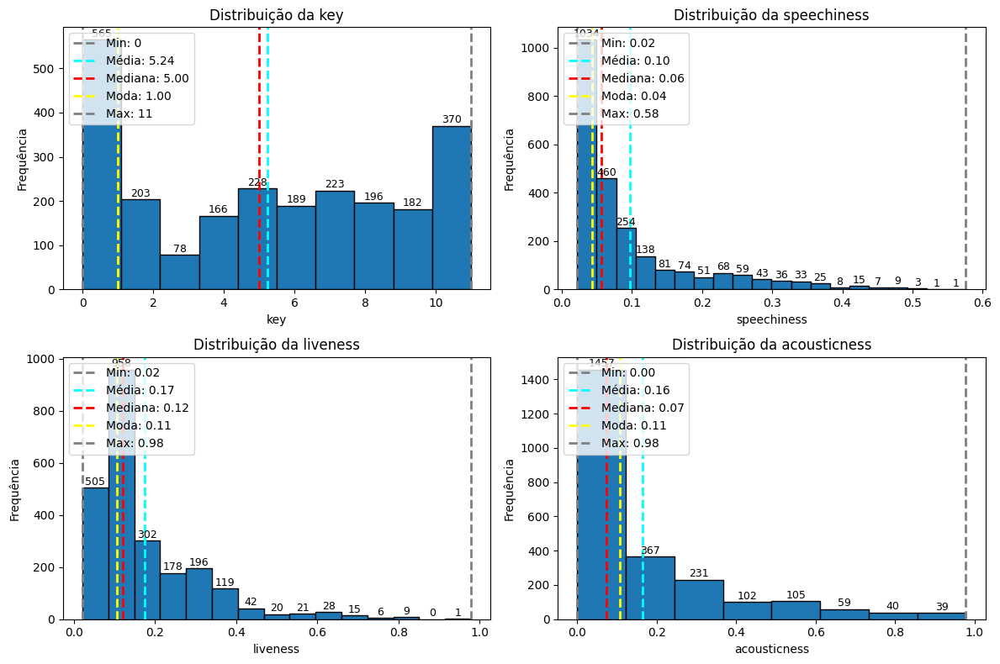

In [ ]:
# Set up the matplotlib figure
fig, axes = plt.subplots(2, 2, figsize=(12, 8))

'''Distribuição da Key'''
# Calculando as estatísticas
min_, max_, mean, median, mode = estatistica(df_pergunta4, 'key')
axes[0, 0].set_title('Distribuição da key')
axes[0, 0].set_xlabel('key')
axes[0, 0].set_ylabel('Frequência')

# Adicionando números em cima de cada barra
counts, bins, _ = axes[0, 0].hist(df_pergunta4['key'], bins=10, edgecolor='black')
for i, freq in enumerate(counts):
    axes[0, 0].text(bins[i] + (bins[i+1] - bins[i]) / 2, freq + 1, str(int(freq)), fontsize=9, ha='center', va='bottom')
# Linhas para cada estatística
axes[0, 0].axvline(x=min_, color='gray', linestyle='dashed', linewidth=2, label=f'Min: {min_:.0f}')
axes[0, 0].axvline(x=mean, color='cyan', linestyle='dashed', linewidth=2, label=f'Média: {mean:.2f}')
axes[0, 0].axvline(x=median, color='red', linestyle='dashed', linewidth=2, label=f'Mediana: {median:.2f}')
axes[0, 0].axvline(x=mode, color='yellow', linestyle='dashed', linewidth=2, label=f'Moda: {mode:.2f}')
axes[0, 0].axvline(x=max_, color='gray', linestyle='dashed', linewidth=2, label=f'Max: {max_:.0f}')
# Adiciona uma legenda
axes[0, 0].legend(loc='upper left')

'''Distribuição da Speechiness'''
# Calculando as estatísticas
min_, max_, mean, median, mode = estatistica(df_pergunta4, 'speechiness')
axes[0, 1].set_title('Distribuição da speechiness')
axes[0, 1].set_xlabel('speechiness')
axes[0, 1].set_ylabel('Frequência')

# Adicionando números em cima de cada barra
counts, bins, _ = axes[0, 1].hist(df_pergunta4['speechiness'], bins=20, edgecolor='black')
for i, freq in enumerate(counts):
    axes[0, 1].text(bins[i] + (bins[i+1] - bins[i]) / 2, freq + 1, str(int(freq)), fontsize=9, ha='center', va='bottom')
# Linhas para cada estatística
axes[0, 1].axvline(x=min_, color='gray', linestyle='dashed', linewidth=2, label=f'Min: {min_:.2f}')
axes[0, 1].axvline(x=mean, color='cyan', linestyle='dashed', linewidth=2, label=f'Média: {mean:.2f}')
axes[0, 1].axvline(x=median, color='red', linestyle='dashed', linewidth=2, label=f'Mediana: {median:.2f}')
axes[0, 1].axvline(x=mode, color='yellow', linestyle='dashed', linewidth=2, label=f'Moda: {mode:.2f}')
axes[0, 1].axvline(x=max_, color='gray', linestyle='dashed', linewidth=2, label=f'Max: {max_:.2f}')
# Adiciona uma legenda
axes[0, 1].legend(loc='upper left')

'''Distribuição da Liveness'''
# Calculando as estatísticas
min_, max_, mean, median, mode = estatistica(df_pergunta4, 'liveness')
axes[1, 0].set_title('Distribuição da liveness')
axes[1, 0].set_xlabel('liveness')
axes[1, 0].set_ylabel('Frequência')

# Adicionando números em cima de cada barra
counts, bins, _ = axes[1, 0].hist(df_pergunta4['liveness'], bins=15, edgecolor='black')
for i, freq in enumerate(counts):
    axes[1, 0].text(bins[i] + (bins[i+1] - bins[i]) / 2, freq + 1, str(int(freq)), fontsize=9, ha='center', va='bottom')
# Linhas para cada estatística
axes[1, 0].axvline(x=min_, color='gray', linestyle='dashed', linewidth=2, label=f'Min: {min_:.2f}')
axes[1, 0].axvline(x=mean, color='cyan', linestyle='dashed', linewidth=2, label=f'Média: {mean:.2f}')
axes[1, 0].axvline(x=median, color='red', linestyle='dashed', linewidth=2, label=f'Mediana: {median:.2f}')
axes[1, 0].axvline(x=mode, color='yellow', linestyle='dashed', linewidth=2, label=f'Moda: {mode:.2f}')
axes[1, 0].axvline(x=max_, color='gray', linestyle='dashed', linewidth=2, label=f'Max: {max_:.2f}')
# Adiciona uma legenda
axes[1, 0].legend(loc='upper left')

'''Distribuição da Acousticness'''
# Calculando as estatísticas
min_, max_, mean, median, mode = estatistica(df_pergunta4, 'acousticness')
axes[1, 1].set_title('Distribuição da acousticness')
axes[1, 1].set_xlabel('acousticness')
axes[1, 1].set_ylabel('Frequência')

# Adicionando números em cima de cada barra
counts, bins, _ = axes[1, 1].hist(df_pergunta4['acousticness'], bins=8, edgecolor='black')
for i, freq in enumerate(counts):
    axes[1, 1].text(bins[i] + (bins[i+1] - bins[i]) / 2, freq + 1, str(int(freq)), fontsize=9, ha='center', va='bottom')
# Linhas para cada estatística
axes[1, 1].axvline(x=min_, color='gray', linestyle='dashed', linewidth=2, label=f'Min: {min_:.2f}')
axes[1, 1].axvline(x=mean, color='cyan', linestyle='dashed', linewidth=2, label=f'Média: {mean:.2f}')
axes[1, 1].axvline(x=median, color='red', linestyle='dashed', linewidth=2, label=f'Mediana: {median:.2f}')
axes[1, 1].axvline(x=mode, color='yellow', linestyle='dashed', linewidth=2, label=f'Moda: {mode:.2f}')
axes[1, 1].axvline(x=max_, color='gray', linestyle='dashed', linewidth=2, label=f'Max: {max_:.2f}')
# Adiciona uma legenda
axes[1, 1].legend(loc='upper left')

plt.tight_layout()
plt.show()

Key: A média e a mediana próximas, indicam que a maior parte da key das músicas está concentrada em torno de um valor central (5.00). Enquanto a moda à esquerda da média e da mediana, sugere que há uma maior aglomeração de faixas com key de 1.

Speechiness: A média e a mediana próximas, indicam que a maior parte da speechiness das músicas está concentrada em torno de um valor central (0.10). Enquanto a moda à esquerda da média e da mediana, sugere que há uma maior aglomeração de faixas com speechiness de 0.04.

Liveness: A média e a mediana próximas, indicam que a maior parte da liveness das músicas está concentrada em torno de um valor central (0.17). Enquanto a moda à esquerda da média e da mediana, sugere que há uma maior aglomeração de faixas com liveness de 0.114.

Acousticness: A média e a mediana estão separadas pela moda, isso sugere que os valores estão mais concentrados à esquerda. A média é maior que a moda, que por sua vez é maior que a mediana. Isso sugere que a distribuição é assimétrica negativa.

##### 4.4.4.2. Intervalo de Confiança

Vamos construir os intervalos de confiança dos dados, em um nível de confiança de 95%.

In [ ]:
LI, LS = intervalo(df_pergunta4, 'valence')
print ('Intervalos de confiança da valence: [{}, {}]'.format(LI.round(2), LS.round(2)))
LI, LS = intervalo(df_pergunta4, 'danceability')
print ('Intervalos de confiança da danceability: [{}, {}]'.format(LI.round(2), LS.round(2)))
LI, LS = intervalo(df_pergunta4, 'energy')
print ('Intervalos de confiança da energy: [{}, {}]'.format(LI.round(2), LS.round(2)))
LI, LS = intervalo(df_pergunta4, 'loudness')
print ('Intervalos de confiança da loudness: [{}, {}]'.format(LI.round(2), LS.round(2)))
LI, LS = intervalo(df_pergunta4, 'key')
print ('Intervalos de confiança da key: [{}, {}]'.format(LI.round(0), LS.round(0)))
LI, LS = intervalo(df_pergunta4, 'speechiness')
print ('Intervalos de confiança da speechiness: [{}, {}]'.format(LI.round(2), LS.round(2)))
LI, LS = intervalo(df_pergunta4, 'liveness')
print ('Intervalos de confiança da liveness: [{}, {}]'.format(LI.round(2), LS.round(2)))
LI, LS = intervalo(df_pergunta4, 'acousticness')
print ('Intervalos de confiança da acousticness: [{}, {}]'.format(LI.round(2), LS.round(2)))

Intervalos de confiança da valence: [0.53, 0.55]
Intervalos de confiança da danceability: [0.66, 0.67]
Intervalos de confiança da energy: [0.68, 0.7]
Intervalos de confiança da loudness: [-5.9, -5.73]
Intervalos de confiança da key: [5.0, 5.0]
Intervalos de confiança da speechiness: [0.09, 0.1]
Intervalos de confiança da liveness: [0.17, 0.18]
Intervalos de confiança da acousticness: [0.16, 0.17]


##### 4.4.4.3. Bootstrap e Distribuição Normal

A partir da reamostragem, vamos calcular a distribuição das médias. Em seguida estimaremos o intervalo de confiança e avaliar sua variabilidade. Além disso, o histograma mostra a frequência das médias das sub-amostras. Cada barra representa o número de vezes que uma determinada faixa de valores médios do tempo de duração das músicas apareceu entre as 10.000 sub-amostras.

Valence

Valence
Média das Médias: 0.54
Intervalo de Confiança: [0.53, 0.55]


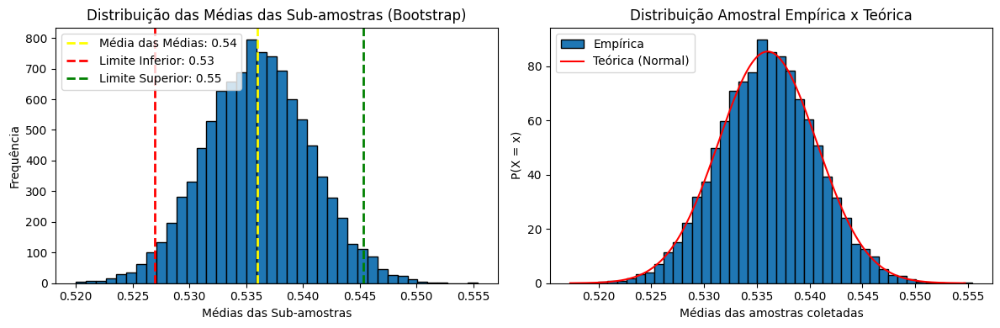

In [ ]:
analise_bootstrap(df_pergunta4, 'valence')

Danceability

Danceability
Média das Médias: 0.66
Intervalo de Confiança: [0.66, 0.67]


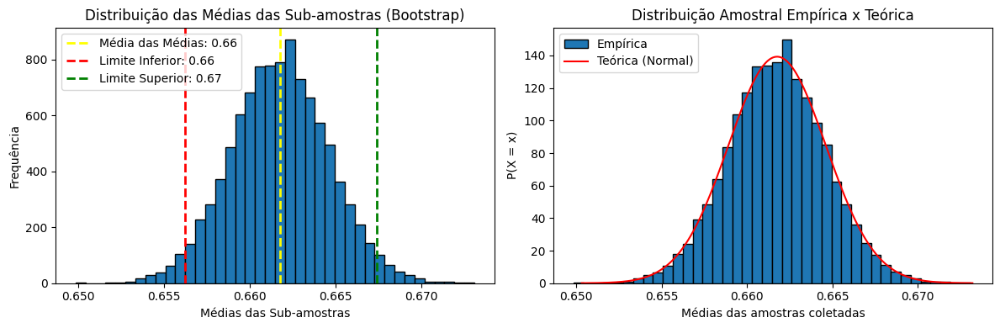

In [ ]:
analise_bootstrap(df_pergunta4, 'danceability')

Energy

Energy
Média das Médias: 0.69
Intervalo de Confiança: [0.68, 0.7]


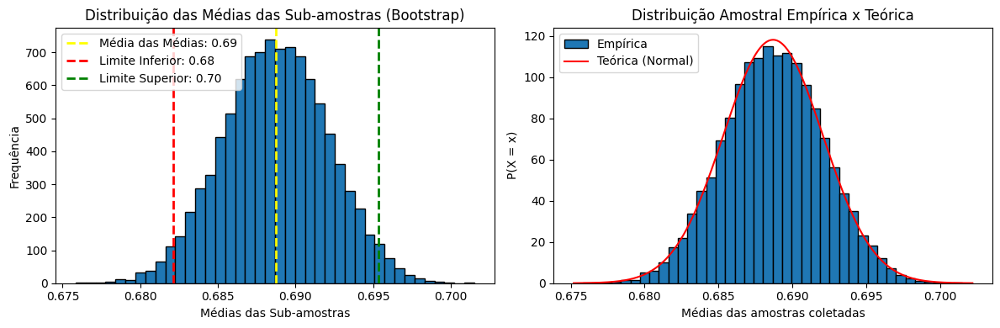

In [ ]:
analise_bootstrap(df_pergunta4, 'energy')

Loudness

Loudness
Média das Médias: -5.81
Intervalo de Confiança: [-5.9, -5.73]


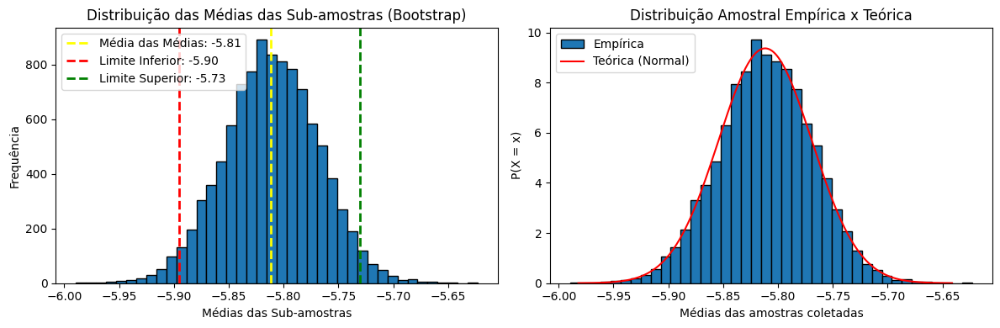

In [ ]:
analise_bootstrap(df_pergunta4, 'loudness')

Key

Key
Média das Médias: 5.24
Intervalo de Confiança: [5.09, 5.38]


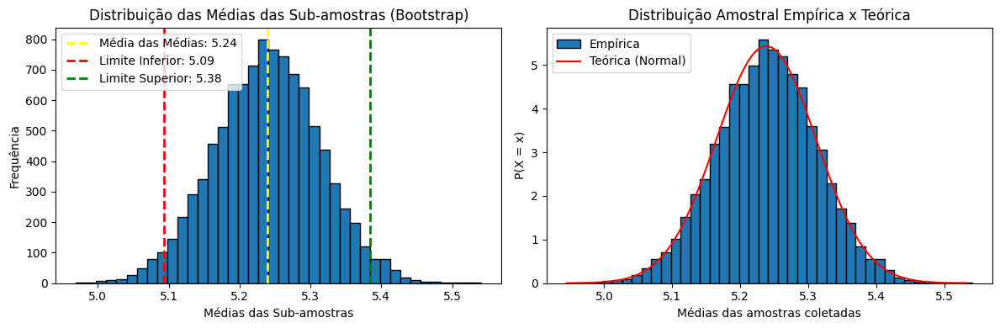

In [ ]:
analise_bootstrap(df_pergunta4, 'key')

Speechiness

Speechiness
Média das Médias: 0.1
Intervalo de Confiança: [0.09, 0.1]


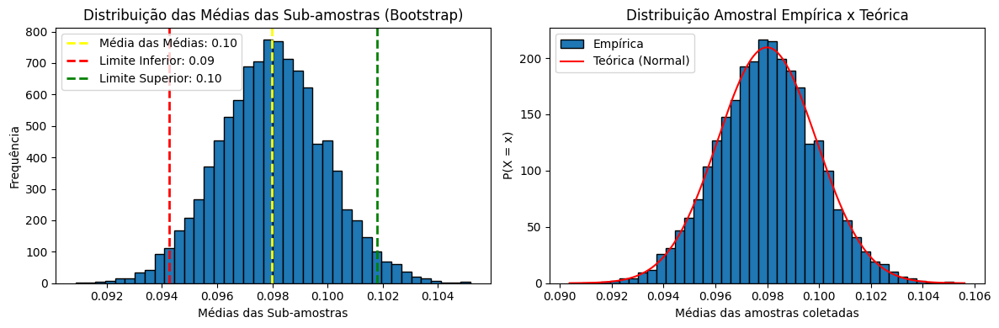

In [ ]:
analise_bootstrap(df_pergunta4, 'speechiness')

Liveness

Liveness
Média das Médias: 0.18
Intervalo de Confiança: [0.17, 0.18]


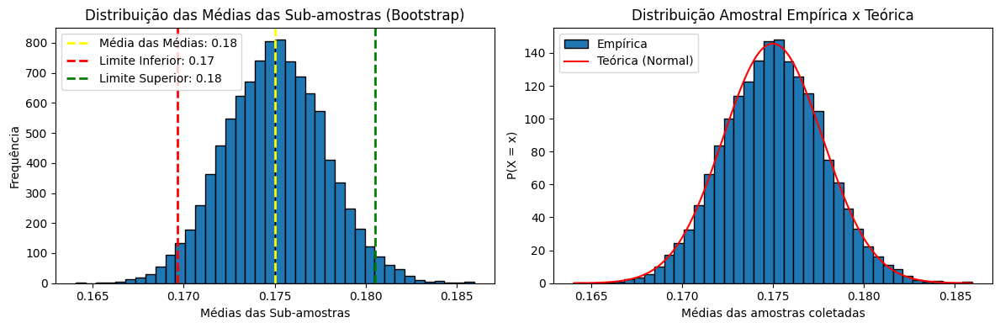

In [ ]:
analise_bootstrap(df_pergunta4, 'liveness')

Acousticness

Acousticness
Média das Médias: 0.16
Intervalo de Confiança: [0.16, 0.17]


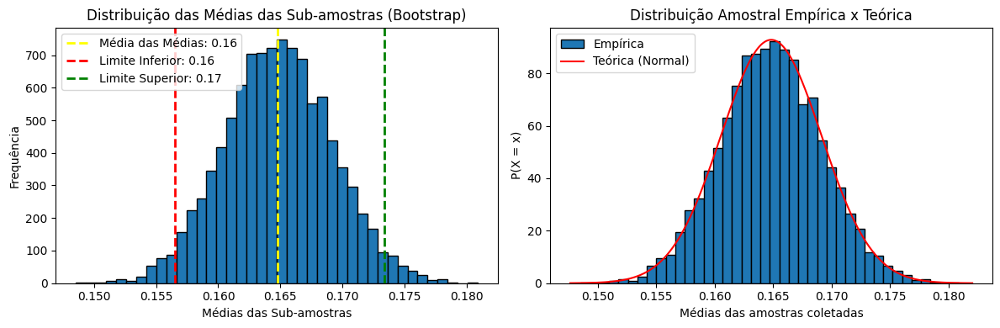

In [ ]:
analise_bootstrap(df_pergunta4, 'acousticness')

#### 4.4.5. Conclusão

Quando comparamos a distribuição gerada pelo método bootstrap com a distribuição dos dados originais, não observamos diferenças significativas. Isso sugere que a nossa amostra é suficientemente representativa da população, garantindo a confiabilidade das estimativas obtidas.


## **5. Matriz de correlação**

A matriz de correlação é uma tabela que mostra as correlações entre todas as variáveis em um conjunto de dados. Ela é usada para examinar a força e a direção das relações lineares entre pares de variáveis numéricas.

- Correlação positiva: Um valor próximo de 1 indica que as variáveis tendem a aumentar juntas.
- Correlação negativa: Um valor próximo de -1 indica que uma variável tende a aumentar enquanto a outra diminui.
- Correlação próxima de 0: Indica que não há relação linear entre as variáveis.

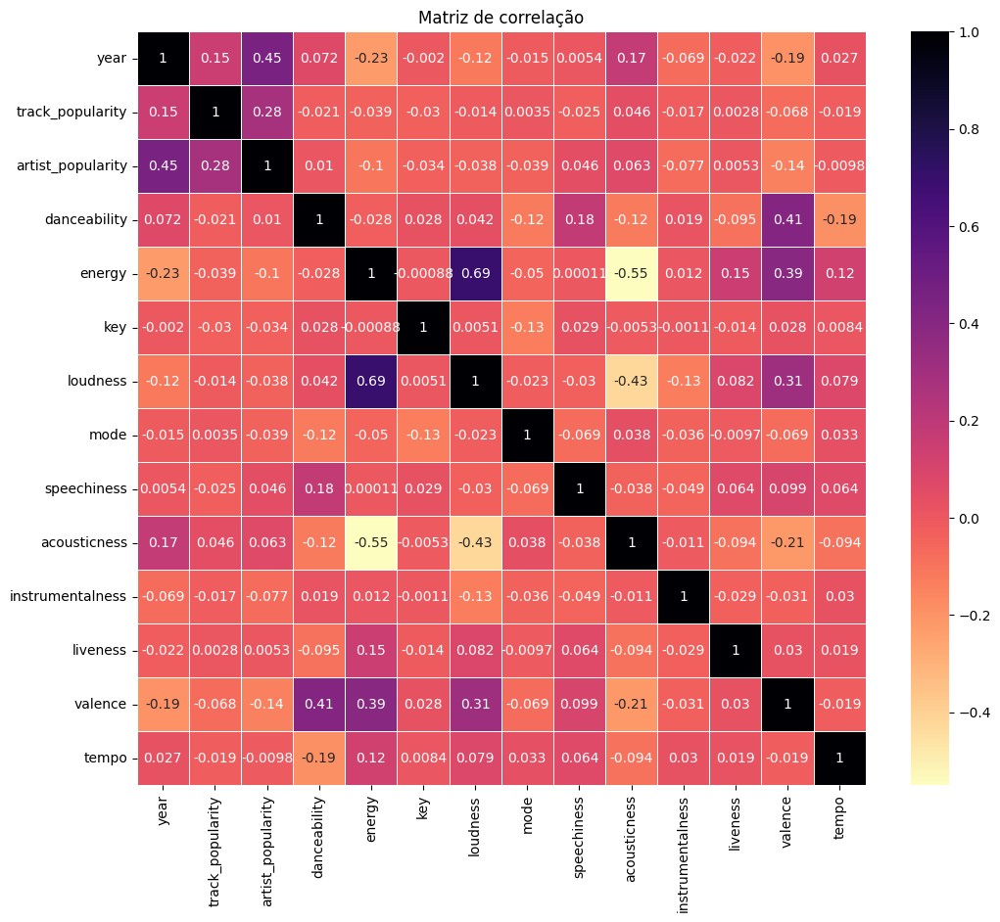

In [ ]:
# Calculate the correlation matrix only for numeric columns
matriz_correlacao = df_pergunta4.select_dtypes(include=['float64', 'int64']).corr()
# Plot the correlation matrix as a heatmap
plt.figure(figsize=(12, 10))
sns.heatmap(matriz_correlacao, annot=True, cmap='magma_r', linewidths=0.5)
plt.title('Matriz de correlação')
plt.show()

Com base na matriz de correlação, podemos observar que as variáveis danceability, energy e loudness apresentam correlações com o atributo valence. Embora essas correlações não sejam muito altas, elas indicam uma relação linear que pode ter alguma força. Vamos analisa-las posteriormente.

Além disso, nenhuma variável relacionada as características das músicas são correlatadas com a coluna que mede a popularidade da música. Essa ausência sugere que as características musicais, por si só, podem não ser determinantes para a popularidade. Assim, será importante explorar mais a fundo essas relações por meio de análises de regressão linear e múltipla afim de obter uma compreensão mais completa.

## **6. Regressão Linear**

Em nosso trabalho, buscamos responder à pergunta principal: "O que faz uma música ser um sucesso?". Para isso, utilizaremos uma regressão linear e múltipla, com as seguintes variáveis explicativas: danceability, energy,
            acousticness, liveness, loudness,
            speechiness, instrumentalness, valence e tempo.

In [ ]:
df_regressao = df_playlist_2000to2023[['track_name', 'artist_name', 'track_popularity', 'artist_genres',
            'artist_popularity', 'danceability', 'energy', 'key',
                                       'mode', 'acousticness', 'liveness', 'loudness',
            'speechiness', 'instrumentalness', 'valence', 'tempo']].copy()
df_regressao.head()

,track_name,artist_name,track_popularity,artist_genres,artist_popularity,danceability,energy,key,mode,acousticness,liveness,loudness,speechiness,instrumentalness,valence,tempo
0,Oops!...I Did It Again,Britney Spears,81,"['dance pop', 'pop']",81,0.751,0.834,1,0,0.3000,0.3550,-5.444,0.0437,0.000018,0.894,95.053
1,All The Small Things,blink-182,83,"['alternative metal', 'modern rock', 'pop punk...",79,0.434,0.897,0,1,0.0103,0.6120,-4.918,0.0488,0.000000,0.684,148.726
2,Breathe,Faith Hill,66,"['contemporary country', 'country', 'country d...",62,0.529,0.496,7,1,0.1730,0.2510,-9.007,0.0290,0.000000,0.278,136.859
3,It's My Life,Bon Jovi,81,"['glam metal', 'rock']",79,0.551,0.913,0,0,0.0263,0.3470,-4.063,0.0466,0.000013,0.544,119.992
4,Bye Bye Bye,*NSYNC,75,"['boy band', 'dance pop', 'pop']",70,0.610,0.926,8,0,0.0310,0.0821,-4.843,0.0479,0.001200,0.861,172.638


Normalizando os dados

A normalização dos dados é um passo importante em nosso trabalho, devido à diversidade de escalas presentes em nossa base de dados. Como utilizaremos algoritmos sensíveis à escala, essa etapa garante que todas as características contribuam de maneira equilibrada para o modelo.

In [ ]:
# Separar colunas numéricas e não numéricas
numeric_cols = ['track_popularity', 'artist_popularity', 'danceability', 'energy', 'key',
                                       'mode', 'acousticness', 'liveness', 'loudness',
            'speechiness', 'instrumentalness', 'valence', 'tempo']
non_numeric_cols = ['track_name', 'artist_name', 'artist_genres']

# Criar o MinMaxScaler
scaler = MinMaxScaler()

# Aplicar o scaler apenas às colunas numéricas
df_numeric = df_regressao[numeric_cols]
df_numeric_normalized = pd.DataFrame(scaler.fit_transform(df_numeric), columns=numeric_cols)

# Reconstruir o DataFrame com colunas normalizadas e não numéricas
df_reg_normalized = pd.concat([df_numeric_normalized, df_regressao[non_numeric_cols].reset_index(drop=True)], axis=1)

# Visualizar as primeiras linhas do DataFrame normalizado
print(df_reg_normalized.head())

   track_popularity  artist_popularity  danceability    energy       key  \
0          0.843750           0.703125      0.724477  0.825784  0.090909   
1          0.864583           0.671875      0.334563  0.892303  0.000000   
2          0.687500           0.406250      0.451415  0.468905  0.636364   
3          0.843750           0.671875      0.478475  0.909196  0.000000   
4          0.781250           0.531250      0.551046  0.922923  0.727273   

   mode  acousticness  liveness  loudness  speechiness  instrumentalness  \
0   0.0      0.306739  0.348643  0.751908     0.038302          0.000018   
1   1.0      0.010519  0.616910  0.777159     0.047516          0.000000   
2   1.0      0.176881  0.240084  0.580865     0.011743          0.000000   
3   0.0      0.026879  0.340292  0.818204     0.043541          0.000014   
4   0.0      0.031685  0.063779  0.780759     0.045890          0.001218   

    valence     tempo              track_name     artist_name  \
0  0.914557  0.232262

#### Funções que utilizaremos nessa etapa:

In [ ]:
import altair as alt
from scipy import stats
import seaborn as sns

In [ ]:
'''recebe como parâmetro os valores de  α ,  β ,  x  e  y  e
retorna a soma dos erros quadrados da saída prevista pelo modelo'''
def sum_of_squared_errors(alpha, beta, x, y):

  yi = alpha + beta * x
  error = (yi - y)**2
  return np.sum(error)

In [ ]:
'''função que recebe como parâmetro os valores de  x  e  y  e
retorna os valores ótimos de  α  e  β'''
def least_squares_fit(x, y):

  x_media = np.mean(x)
  y_media = np.mean(y)

  # Calcular os termos necessários para beta
  n = np.sum((x - x_media) * (y - y_media))
  d = np.sum((x - x_media) ** 2)

  # Calcular beta
  beta = n / d

  # Calcular alpha
  alpha = y_media - (beta * x_media)

  return alpha, beta

In [ ]:
'''Recebe como parâmetro os valores de  α ,  β ,  x  e  y  e retorne o valor do  R'''
def r_squared(alpha, beta, x, y):

  y_media = np.mean(y)
  y_ped = alpha + beta * x

  # Calcular os termos necessários para beta
  n = sum_of_squared_errors(alpha, beta, x, y)
  d = np.sum((y - y_media) ** 2)

  r_2 = 1 - (n/d)

  return r_2

In [ ]:
''' Boostrap dos erros quadraticos'''
def bootstrap_mse(x, y, alpha, beta, n=1000):
    size = len(y)
    mse_values = np.zeros(n)

    for i in range(n):
        idx = np.random.choice(size, size, replace=True)
        x_b = x[idx]
        y_b = y[idx]
        # Calcular a soma dos erros quadrados
        sse = sum_of_squared_errors(alpha, beta, x_b, y_b)
        # Calcular o MSE
        mse_values[i] = sse / len(y_b)

    return mse_values


In [ ]:
''' Gráfico da regressão linear'''
def plot_regressao(df_reg_normalized, alpha, beta, x_col, y_col, title):

    # Adicionar a reta de regressão ao DataFrame
    df_reg_normalized['regression_line'] = alpha + beta * df_reg_normalized[x_col]

    # Criar gráfico de dispersão interativo
    scatter_plot = alt.Chart(df_reg_normalized).mark_point().encode(
        x=f'{x_col}:Q',
        y=f'{y_col}:Q',
        tooltip=['track_name:N', 'artist_name:N']
    ).interactive()

    # Criar gráfico da linha de regressão
    regression_line = alt.Chart(df_reg_normalized).mark_line(color='red').encode(
        x=f'{x_col}:Q',
        y='regression_line:Q'
    )

    # Combinar os gráficos
    final_chart = scatter_plot + regression_line
    final_chart = final_chart.properties(
        title=title
    ).configure_title(
        fontSize=15
    )

    return final_chart

### 6.1. Regressão linear simples para popularidade da música

Antes de avançarmos para a construção de uma regressão linear múltipla, começaremos com regressões lineares simples para analisar a popularidade das músicas em relação a cada variável individualmente — energy, valence, danceability, loudness e tempo. Essa abordagem nos permitirá entender o impacto isolado de cada uma dessas características musicais na popularidade.

#### 6.1.1 Como a danceability influência na popularidade da música

In [ ]:
x = df_reg_normalized['danceability'].values
y = df_reg_normalized['track_popularity'].values

alpha, beta = least_squares_fit(x, y)

print("Valores ótimos de Alpha e Beta\n")
print(f"Alfa: {alpha:.2f}")
print(f"Beta: {beta:.2f}")

print("\nEquação da regressão linear:")
print(f"y = {alpha:.2f} {beta:.2f}x")

Valores ótimos de Alpha e Beta

Alfa: 0.74
Beta: -0.02

Equação da regressão linear:
y = 0.74 -0.02x


In [ ]:
final_chart = plot_regressao(df_reg_normalized, alpha, beta, 'danceability', 'track_popularity', 'Popularidade da Faixa vs Dançabilidade')
final_chart.display()

/usr/local/lib/python3.10/dist-packages/altair/utils/core.py:384: FutureWarning: the convert_dtype parameter is deprecated and will be removed in a future version.  Do ``ser.astype(object).apply()`` instead if you want ``convert_dtype=False``.
  col = df[col_name].apply(to_list_if_array, convert_dtype=False)


alt.LayerChart(...)

In [ ]:
R2 = r_squared(alpha, beta, x, y)
print (f"R2 no modelo com os valores ótimos de α e β: {R2:.4f}")

R2 no modelo com os valores ótimos de α e β: 0.0004


Quanto maior for o  R2 , melhor o nosso modelo se ajusta aos dados. Um  R2  próximo de 0 nos diz que o nosso modelo está fraco para ajustar aos dados, e que claramente existem outros fatores em jogo. Logo, danceability, sozinha, não explica a popularidade da música.

Verificar se a raiz de  R2 é a própria correlação

In [ ]:
print(r_squared(alpha, beta, x, y) ** 0.5, ss.pearsonr(x, y)[0])

0.020536640388847956 -0.02053664038885377


Erro quadrático médio

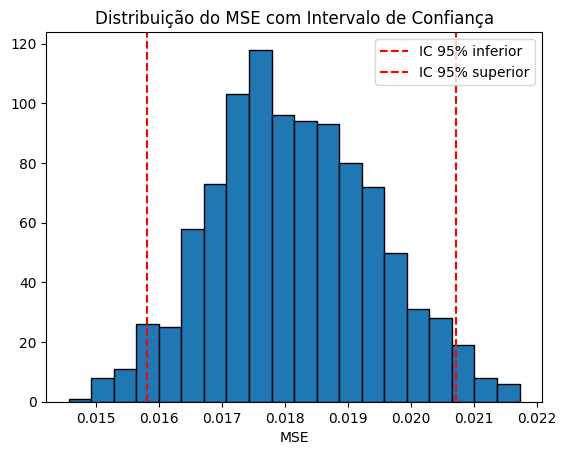

Intervalo de Confiança 95% para o MSE: (0.0158, 0.0207)


In [ ]:
# Calcular MSE e intervalo de confiança
mse_values = bootstrap_mse(x, y, alpha, beta)
li = np.percentile(mse_values, 2.5)
ls = np.percentile(mse_values, 97.5)

plt.hist(mse_values, bins=20, edgecolor='k')
plt.axvline(x=li, color='r', linestyle='--', label='IC 95% inferior')
plt.axvline(x=ls, color='r', linestyle='--', label='IC 95% superior')
plt.xlabel('MSE')
plt.title('Distribuição do MSE com Intervalo de Confiança')
plt.legend()
plt.show()

print(f"Intervalo de Confiança 95% para o MSE: ({li:.4f}, {ls:.4f})")

O erro quadrático é importante porque ele mede a precisão de um modelo de regressão ao quantificar a diferença entre os valores previstos pelo modelo e os valores reais observados.

O intervalo do erro quadrático sugere que o modelo tem uma precisão relativamente alta, com erros de previsão pequenos.

#### 6.1.2 Como a energy influência na popularidade da música

In [ ]:
x = df_reg_normalized['energy'].values
y = df_reg_normalized['track_popularity'].values

alpha, beta = least_squares_fit(x, y)

print("Valores ótimos de Alpha e Beta\n")
print(f"Alfa: {alpha:.2f}")
print(f"Beta: {beta:.2f}")

print("\nEquação da regressão linear:")
print(f"y = {alpha:.2f} {beta:.2f}x")

Valores ótimos de Alpha e Beta

Alfa: 0.75
Beta: -0.03

Equação da regressão linear:
y = 0.75 -0.03x


In [ ]:
final_chart = plot_regressao(df_reg_normalized, alpha, beta, 'energy', 'track_popularity', 'Popularidade da Faixa vs Energia')
final_chart.display()

/usr/local/lib/python3.10/dist-packages/altair/utils/core.py:384: FutureWarning: the convert_dtype parameter is deprecated and will be removed in a future version.  Do ``ser.astype(object).apply()`` instead if you want ``convert_dtype=False``.
  col = df[col_name].apply(to_list_if_array, convert_dtype=False)


alt.LayerChart(...)

In [ ]:
R2 = r_squared(alpha, beta, x, y)
print (f"R2 no modelo com os valores ótimos de α e β: {R2:.4f}")

R2 no modelo com os valores ótimos de α e β: 0.0015


Quanto maior for o R2 , melhor o nosso modelo se ajusta aos dados. Um R2 próximo de 0 nos diz que o nosso modelo está fraco para ajustar aos dados, e que claramente existem outros fatores em jogo. Logo, energy, sozinha, não explica a popularidade da música.

Verificar se a raiz de R2 é a própria correlação

In [ ]:
print(r_squared(alpha, beta, x, y) ** 0.5, ss.pearsonr(x, y)[0])

0.03928396159751382 -0.039283961597514495


Erro quadrático médio

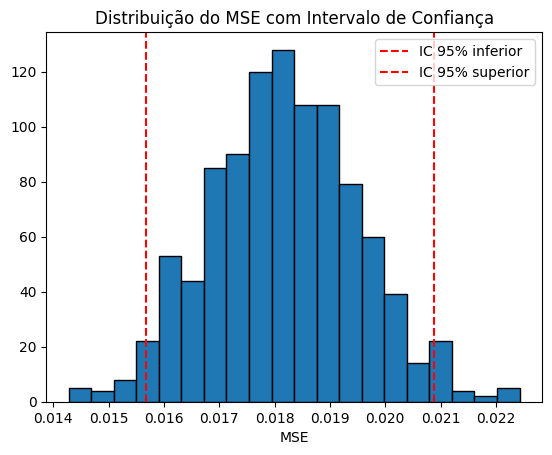

Intervalo de Confiança 95% para o MSE: (0.0157, 0.0209)


In [ ]:
# Calcular MSE e intervalo de confiança
mse_values = bootstrap_mse(x, y, alpha, beta)
li = np.percentile(mse_values, 2.5)
ls = np.percentile(mse_values, 97.5)

plt.hist(mse_values, bins=20, edgecolor='k')
plt.axvline(x=li, color='r', linestyle='--', label='IC 95% inferior')
plt.axvline(x=ls, color='r', linestyle='--', label='IC 95% superior')
plt.xlabel('MSE')
plt.title('Distribuição do MSE com Intervalo de Confiança')
plt.legend()
plt.show()

print(f"Intervalo de Confiança 95% para o MSE: ({li:.4f}, {ls:.4f})")

O erro quadrático é importante porque ele mede a precisão de um modelo de regressão ao quantificar a diferença entre os valores previstos pelo modelo e os valores reais observados.

O intervalo do erro quadrático sugere que o modelo tem uma precisão relativamente alta, com erros de previsão pequenos.

#### 6.1.3 Como a loudness influência na popularidade da música

In [ ]:
x = df_reg_normalized['loudness'].values
y = df_reg_normalized['track_popularity'].values

alpha, beta = least_squares_fit(x, y)

print("Valores ótimos de Alpha e Beta\n")
print(f"Alfa: {alpha:.2f}")
print(f"Beta: {beta:.2f}")

print("\nEquação da regressão linear:")
print(f"y = {alpha:.2f} {beta:.2f}x")

Valores ótimos de Alpha e Beta

Alfa: 0.75
Beta: -0.02

Equação da regressão linear:
y = 0.75 -0.02x


In [ ]:
final_chart = plot_regressao(df_reg_normalized, alpha, beta, 'loudness', 'track_popularity', 'Popularidade da Faixa vs Loudness')
final_chart.display()

/usr/local/lib/python3.10/dist-packages/altair/utils/core.py:384: FutureWarning: the convert_dtype parameter is deprecated and will be removed in a future version.  Do ``ser.astype(object).apply()`` instead if you want ``convert_dtype=False``.
  col = df[col_name].apply(to_list_if_array, convert_dtype=False)


alt.LayerChart(...)

In [ ]:
R2 = r_squared(alpha, beta, x, y)
print (f"R2 no modelo com os valores ótimos de α e β: {R2:.4f}")

R2 no modelo com os valores ótimos de α e β: 0.0002


Quanto maior for o R2 , melhor o nosso modelo se ajusta aos dados. Um R2 próximo de 0 nos diz que o nosso modelo está fraco para ajustar aos dados, e que claramente existem outros fatores em jogo. Logo, loudness, sozinha, não explica a popularidade da música.

Verificar se a raiz de R2 é a própria correlação

In [ ]:
print(r_squared(alpha, beta, x, y) ** 0.5, ss.pearsonr(x, y)[0])

0.013811834260332612 -0.013811834260333356


Erro quadrático médio

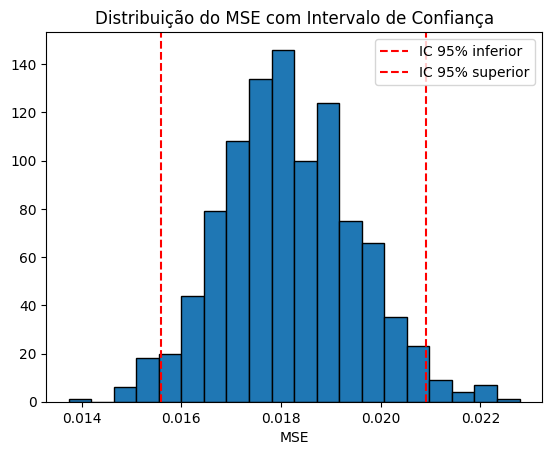

Intervalo de Confiança 95% para o MSE: (0.0156, 0.0209)


In [ ]:
# Calcular MSE e intervalo de confiança
mse_values = bootstrap_mse(x, y, alpha, beta)
li = np.percentile(mse_values, 2.5)
ls = np.percentile(mse_values, 97.5)

plt.hist(mse_values, bins=20, edgecolor='k')
plt.axvline(x=li, color='r', linestyle='--', label='IC 95% inferior')
plt.axvline(x=ls, color='r', linestyle='--', label='IC 95% superior')
plt.xlabel('MSE')
plt.title('Distribuição do MSE com Intervalo de Confiança')
plt.legend()
plt.show()

print(f"Intervalo de Confiança 95% para o MSE: ({li:.4f}, {ls:.4f})")

O erro quadrático é importante porque ele mede a precisão de um modelo de regressão ao quantificar a diferença entre os valores previstos pelo modelo e os valores reais observados.

O intervalo do erro quadrático sugere que o modelo tem uma precisão relativamente alta, com erros de previsão pequeno

#### 6.1.4 Como a valence influência na popularidade da música

In [ ]:
x = df_reg_normalized['valence'].values
y = df_reg_normalized['track_popularity'].values

alpha, beta = least_squares_fit(x, y)

print("Valores ótimos de Alpha e Beta\n")
print(f"Alfa: {alpha:.2f}")
print(f"Beta: {beta:.2f}")

print("\nEquação da regressão linear:")
print(f"y = {alpha:.2f} {beta:.2f}x")

Valores ótimos de Alpha e Beta

Alfa: 0.75
Beta: -0.04

Equação da regressão linear:
y = 0.75 -0.04x


In [ ]:
final_chart = plot_regressao(df_reg_normalized, alpha, beta, 'valence', 'track_popularity', 'Popularidade da Faixa vs Valence')
final_chart.display()

/usr/local/lib/python3.10/dist-packages/altair/utils/core.py:384: FutureWarning: the convert_dtype parameter is deprecated and will be removed in a future version.  Do ``ser.astype(object).apply()`` instead if you want ``convert_dtype=False``.
  col = df[col_name].apply(to_list_if_array, convert_dtype=False)


alt.LayerChart(...)

In [ ]:
R2 = r_squared(alpha, beta, x, y)
print (f"R2 no modelo com os valores ótimos de α e β: {R2:.4f}")

R2 no modelo com os valores ótimos de α e β: 0.0046


Quanto maior for o R2 , melhor o nosso modelo se ajusta aos dados. Um R2 próximo de 0 nos diz que o nosso modelo está fraco para ajustar aos dados, e que claramente existem outros fatores em jogo. Logo, valence, sozinha, não explica a popularidade da música.

Verificar se a raiz de R2 é a própria correlação

In [ ]:
print(r_squared(alpha, beta, x, y) ** 0.5, ss.pearsonr(x, y)[0])

0.06751208518378612 -0.06751208518378671


Erro quadrático médio

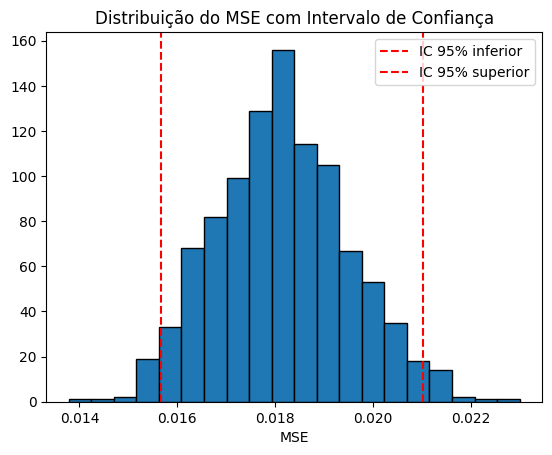

Intervalo de Confiança 95% para o MSE: (0.0157, 0.0210)


In [ ]:
# Calcular MSE e intervalo de confiança
mse_values = bootstrap_mse(x, y, alpha, beta)
li = np.percentile(mse_values, 2.5)
ls = np.percentile(mse_values, 97.5)

plt.hist(mse_values, bins=20, edgecolor='k')
plt.axvline(x=li, color='r', linestyle='--', label='IC 95% inferior')
plt.axvline(x=ls, color='r', linestyle='--', label='IC 95% superior')
plt.xlabel('MSE')
plt.title('Distribuição do MSE com Intervalo de Confiança')
plt.legend()
plt.show()

print(f"Intervalo de Confiança 95% para o MSE: ({li:.4f}, {ls:.4f})")

O erro quadrático é importante porque ele mede a precisão de um modelo de regressão ao quantificar a diferença entre os valores previstos pelo modelo e os valores reais observados.

O intervalo do erro quadrático sugere que o modelo tem uma precisão relativamente alta, com erros de previsão pequenos.

#### 6.1.5 Como o tempo influência na popularidade da música

In [ ]:
x = df_reg_normalized['tempo'].values
y = df_reg_normalized['track_popularity'].values

alpha, beta = least_squares_fit(x, y)

print("Valores ótimos de Alpha e Beta\n")
print(f"Alfa: {alpha:.2f}")
print(f"Beta: {beta:.2f}")

print("\nEquação da regressão linear:")
print(f"y = {alpha:.2f} {beta:.2f}x")

Valores ótimos de Alpha e Beta

Alfa: 0.74
Beta: -0.01

Equação da regressão linear:
y = 0.74 -0.01x


In [ ]:
final_chart = plot_regressao(df_reg_normalized, alpha, beta, 'tempo', 'track_popularity', 'Popularidade da Faixa vs Tempo')
final_chart.display()

/usr/local/lib/python3.10/dist-packages/altair/utils/core.py:384: FutureWarning: the convert_dtype parameter is deprecated and will be removed in a future version.  Do ``ser.astype(object).apply()`` instead if you want ``convert_dtype=False``.
  col = df[col_name].apply(to_list_if_array, convert_dtype=False)


alt.LayerChart(...)

In [ ]:
R2 = r_squared(alpha, beta, x, y)
print (f"R2 no modelo com os valores ótimos de α e β: {R2:.4f}")

R2 no modelo com os valores ótimos de α e β: 0.0004


Quanto maior for o R2 , melhor o nosso modelo se ajusta aos dados. Um R2 próximo de 0 nos diz que o nosso modelo está fraco para ajustar aos dados, e que claramente existem outros fatores em jogo. Logo, tempo, sozinho, não explica a popularidade da música.

Verificar se a raiz de R2 é a própria correlação

In [ ]:
print(r_squared(alpha, beta, x, y) ** 0.5, ss.pearsonr(x, y)[0])

0.0192544036671708 -0.019254403667173767


Erro quadrático médio

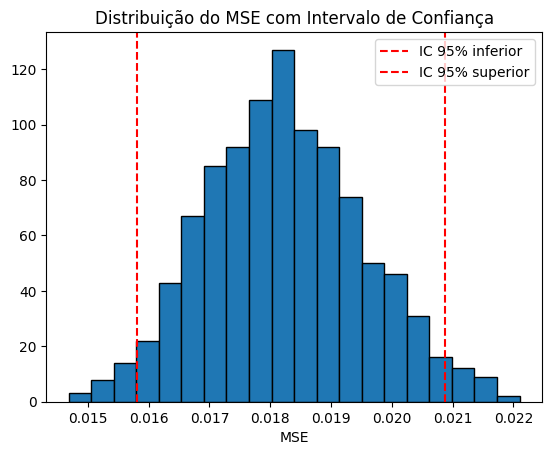

Intervalo de Confiança 95% para o MSE: (0.0158, 0.0209)


In [ ]:
# Calcular MSE e intervalo de confiança
mse_values = bootstrap_mse(x, y, alpha, beta)
li = np.percentile(mse_values, 2.5)
ls = np.percentile(mse_values, 97.5)

plt.hist(mse_values, bins=20, edgecolor='k')
plt.axvline(x=li, color='r', linestyle='--', label='IC 95% inferior')
plt.axvline(x=ls, color='r', linestyle='--', label='IC 95% superior')
plt.xlabel('MSE')
plt.title('Distribuição do MSE com Intervalo de Confiança')
plt.legend()
plt.show()

print(f"Intervalo de Confiança 95% para o MSE: ({li:.4f}, {ls:.4f})")

O erro quadrático é importante porque ele mede a precisão de um modelo de regressão ao quantificar a diferença entre os valores previstos pelo modelo e os valores reais observados.

Um intervalo do erro quadrático sugere que o modelo tem uma precisão relativamente alta, com erros de previsão pequenos.

#### 6.1.6 Conclusão

Ao realizar a regressão linear com algumas variáveis, observamos que, individualmente, elas não explicam bem a popularidade das músicas, pois, além de apresentarem baixa correlação, o R2 também é muito baixo. Por essa razão, vamos realizar uma regressão múltipla com mais variáveis, na tentativa de melhorar o poder explicativo do modelo e obter uma previsão mais precisa da popularidade das músicas.

### 6.2 Regressão linear para popularidade faixa vs popularidade artista

In [ ]:
x = df_reg_normalized['artist_popularity'].values
y = df_reg_normalized['track_popularity'].values


alpha, beta = least_squares_fit(x, y)

print("Valores ótimos de Alpha e Beta\n")
print(f"Alfa: {alpha:.2f}")
print(f"Beta: {beta:.2f}")

print("\nEquação da regressão linear:")
print(f"y = {alpha:.2f} {beta:.2f}x")

Valores ótimos de Alpha e Beta

Alfa: 0.61
Beta: 0.20

Equação da regressão linear:
y = 0.61 0.20x


In [ ]:
final_chart = plot_regressao(df_reg_normalized, alpha, beta, 'artist_popularity', 'track_popularity', 'Popularidade da Faixa vs Popularidade do Artista')
final_chart.display()

/usr/local/lib/python3.10/dist-packages/altair/utils/core.py:384: FutureWarning: the convert_dtype parameter is deprecated and will be removed in a future version.  Do ``ser.astype(object).apply()`` instead if you want ``convert_dtype=False``.
  col = df[col_name].apply(to_list_if_array, convert_dtype=False)


alt.LayerChart(...)

In [ ]:
R2 = r_squared(alpha, beta, x, y)
print (f"R2 no modelo com os valores ótimos de α e β: {R2:.4f}")

R2 no modelo com os valores ótimos de α e β: 0.0784


Quanto maior for o R2 , melhor o nosso modelo se ajusta aos dados. Um R2 próximo de 0 nos diz que o nosso modelo está fraco para ajustar aos dados, e que claramente existem outros fatores em jogo. Logo, a popularidade da música, sozinho, não explica a popularidade do artista.

In [ ]:
# Verificar se a raiz de R2 é a própria correlação
print(r_squared(alpha, beta, x, y) ** 0.5, ss.pearsonr(x, y)[0])

0.28003379772484494 0.28003379772484516


Erro quadrático médio

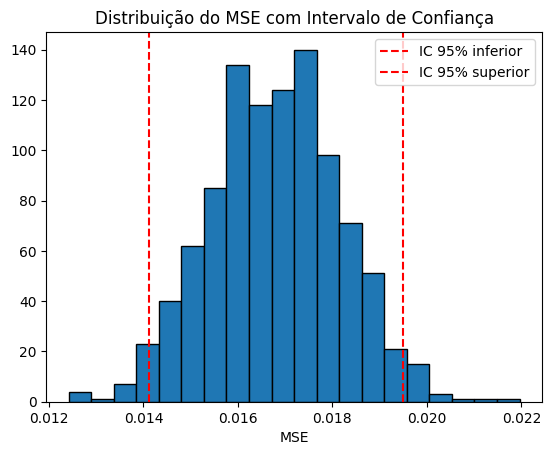

Intervalo de Confiança 95% para o MSE: (0.0141, 0.0195)


In [ ]:
# Calcular MSE e intervalo de confiança
mse_values = bootstrap_mse(x, y, alpha, beta)
li = np.percentile(mse_values, 2.5)
ls = np.percentile(mse_values, 97.5)

plt.hist(mse_values, bins=20, edgecolor='k')
plt.axvline(x=li, color='r', linestyle='--', label='IC 95% inferior')
plt.axvline(x=ls, color='r', linestyle='--', label='IC 95% superior')
plt.xlabel('MSE')
plt.title('Distribuição do MSE com Intervalo de Confiança')
plt.legend()
plt.show()

print(f"Intervalo de Confiança 95% para o MSE: ({li:.4f}, {ls:.4f})")

O erro quadrático é importante porque ele mede a precisão de um modelo de regressão ao quantificar a diferença entre os valores previstos pelo modelo e os valores reais observados.

O intervalo do erro quadrático sugere que o modelo tem uma precisão relativamente alta, com erros de previsão pequenos.

### 6.3 Regressão linear para a valence

Anteriormente, na matriz de correlação, observamos que a valence apresentava correlação com algumas variáveis. Por isso, vamos investigar mais a fundo as variáveis que influenciam a valence.

#### 6.3.1 Como a danceability influência na valence da música

In [ ]:
y = df_reg_normalized['valence'].values
x = df_reg_normalized['danceability'].values

alpha, beta = least_squares_fit(x, y)

print("Valores ótimos de Alpha e Beta\n")
print(f"Alfa: {alpha:.2f}")
print(f"Beta: {beta:.2f}")

print("\nEquação da regressão linear:")
print(f"y = {alpha:.2f} {beta:.2f}x")

Valores ótimos de Alpha e Beta

Alfa: 0.17
Beta: 0.58

Equação da regressão linear:
y = 0.17 0.58x


In [ ]:
final_chart = plot_regressao(df_reg_normalized, alpha, beta, 'danceability', 'valence', 'Valence vs Danceability')
final_chart.display()

/usr/local/lib/python3.10/dist-packages/altair/utils/core.py:384: FutureWarning: the convert_dtype parameter is deprecated and will be removed in a future version.  Do ``ser.astype(object).apply()`` instead if you want ``convert_dtype=False``.
  col = df[col_name].apply(to_list_if_array, convert_dtype=False)


alt.LayerChart(...)

In [ ]:
R2 = r_squared(alpha, beta, x, y)
print (f"R2 no modelo com os valores ótimos de α e β: {R2:.4f}")

R2 no modelo com os valores ótimos de α e β: 0.1695


Quanto maior for o R2 , melhor o nosso modelo se ajusta aos dados. Um R2 próximo de 0 nos diz que o nosso modelo está fraco para ajustar aos dados, e que claramente existem outros fatores em jogo. Logo, a dancebility, sozinho, não explica a valência.

In [ ]:
# Verificar se a raiz de R2 é a própria correlação
print(r_squared(alpha, beta, x, y) ** 0.5, ss.pearsonr(x, y)[0])

0.411671996372195 0.41167199637219487


Erro quadrático médio

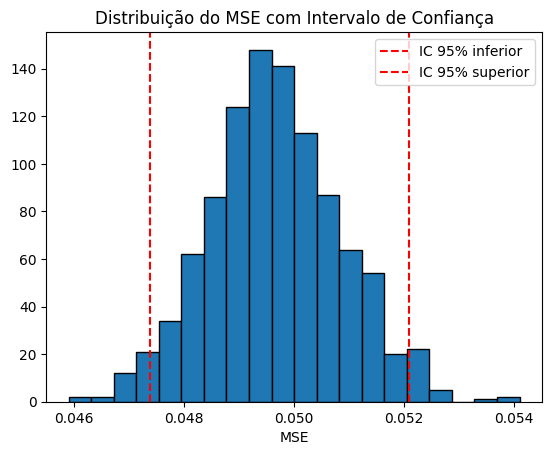

Intervalo de Confiança 95% para o MSE: (0.0474, 0.0521)


In [ ]:
# Calcular MSE e intervalo de confiança
mse_values = bootstrap_mse(x, y, alpha, beta)
li = np.percentile(mse_values, 2.5)
ls = np.percentile(mse_values, 97.5)

plt.hist(mse_values, bins=20, edgecolor='k')
plt.axvline(x=li, color='r', linestyle='--', label='IC 95% inferior')
plt.axvline(x=ls, color='r', linestyle='--', label='IC 95% superior')
plt.xlabel('MSE')
plt.title('Distribuição do MSE com Intervalo de Confiança')
plt.legend()
plt.show()

print(f"Intervalo de Confiança 95% para o MSE: ({li:.4f}, {ls:.4f})")

O erro quadrático é importante porque ele mede a precisão de um modelo de regressão ao quantificar a diferença entre os valores previstos pelo modelo e os valores reais observados.

O intervalo do erro quadrático sugere que o modelo tem uma precisão relativamente alta, com erros de previsão pequenos.

#### 6.3.2 Como a energy influência na valence da música

In [ ]:
y = df_reg_normalized['valence'].values
x = df_reg_normalized['energy'].values

alpha, beta = least_squares_fit(x, y)

print("Valores ótimos de Alpha e Beta\n")
print(f"Alfa: {alpha:.2f}")
print(f"Beta: {beta:.2f}")

print("\nEquação da regressão linear:")
print(f"y = {alpha:.2f} {beta:.2f}x")

Valores ótimos de Alpha e Beta

Alfa: 0.16
Beta: 0.55

Equação da regressão linear:
y = 0.16 0.55x


In [ ]:
final_chart = plot_regressao(df_reg_normalized, alpha, beta, 'energy', 'valence', 'Valence vs Energy')
final_chart.display()

/usr/local/lib/python3.10/dist-packages/altair/utils/core.py:384: FutureWarning: the convert_dtype parameter is deprecated and will be removed in a future version.  Do ``ser.astype(object).apply()`` instead if you want ``convert_dtype=False``.
  col = df[col_name].apply(to_list_if_array, convert_dtype=False)


alt.LayerChart(...)

In [ ]:
R2 = r_squared(alpha, beta, x, y)
print (f"R2 no modelo com os valores ótimos de α e β: {R2:.4f}")

R2 no modelo com os valores ótimos de α e β: 0.1551


Quanto maior for o R2 , melhor o nosso modelo se ajusta aos dados. Um R2 próximo de 0 nos diz que o nosso modelo está fraco para ajustar aos dados, e que claramente existem outros fatores em jogo. Logo, a energy, sozinho, não explica a valência.

In [ ]:
# Verificar se a raiz de R2 é a própria correlação
print(r_squared(alpha, beta, x, y) ** 0.5, ss.pearsonr(x, y)[0])

0.39388349023066344 0.3938834902306634


Erro quadrático médio

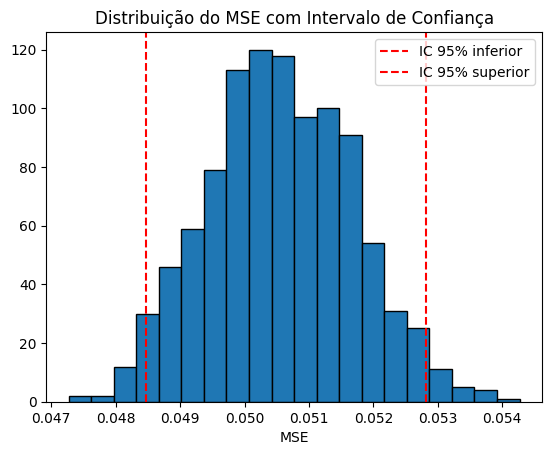

Intervalo de Confiança 95% para o MSE: (0.0485, 0.0528)


In [ ]:
# Calcular MSE e intervalo de confiança
mse_values = bootstrap_mse(x, y, alpha, beta)
li = np.percentile(mse_values, 2.5)
ls = np.percentile(mse_values, 97.5)

plt.hist(mse_values, bins=20, edgecolor='k')
plt.axvline(x=li, color='r', linestyle='--', label='IC 95% inferior')
plt.axvline(x=ls, color='r', linestyle='--', label='IC 95% superior')
plt.xlabel('MSE')
plt.title('Distribuição do MSE com Intervalo de Confiança')
plt.legend()
plt.show()

print(f"Intervalo de Confiança 95% para o MSE: ({li:.4f}, {ls:.4f})")

O erro quadrático é importante porque ele mede a precisão de um modelo de regressão ao quantificar a diferença entre os valores previstos pelo modelo e os valores reais observados.

O intervalo do erro quadrático sugere que o modelo tem uma precisão relativamente alta, com erros de previsão pequenos.

#### 6.3.3 Como a variável loudness influência na valence da música

In [ ]:
y = df_reg_normalized['valence'].values
x = df_reg_normalized['loudness'].values

alpha, beta = least_squares_fit(x, y)

print("Valores ótimos de Alpha e Beta\n")
print(f"Alfa: {alpha:.2f}")
print(f"Beta: {beta:.2f}")

print("\nEquação da regressão linear:")
print(f"y = {alpha:.2f} {beta:.2f}x")

Valores ótimos de Alpha e Beta

Alfa: -0.03
Beta: 0.76

Equação da regressão linear:
y = -0.03 0.76x


In [ ]:
final_chart = plot_regressao(df_reg_normalized, alpha, beta, 'loudness', 'valence', 'Valence vs Loudness')
final_chart.display()

/usr/local/lib/python3.10/dist-packages/altair/utils/core.py:384: FutureWarning: the convert_dtype parameter is deprecated and will be removed in a future version.  Do ``ser.astype(object).apply()`` instead if you want ``convert_dtype=False``.
  col = df[col_name].apply(to_list_if_array, convert_dtype=False)


alt.LayerChart(...)

In [ ]:
R2 = r_squared(alpha, beta, x, y)
print (f"R2 no modelo com os valores ótimos de α e β: {R2:.4f}")

R2 no modelo com os valores ótimos de α e β: 0.0982


Quanto maior for o R2 , melhor o nosso modelo se ajusta aos dados. Um R2 próximo de 0 nos diz que o nosso modelo está fraco para ajustar aos dados, e que claramente existem outros fatores em jogo. Logo, a loudness, sozinho, não explica a valência.

In [ ]:
# Verificar se a raiz de R2 é a própria correlação
print(r_squared(alpha, beta, x, y) ** 0.5, ss.pearsonr(x, y)[0])

0.3132920636517608 0.31329206365176093


Erro quadrático médio

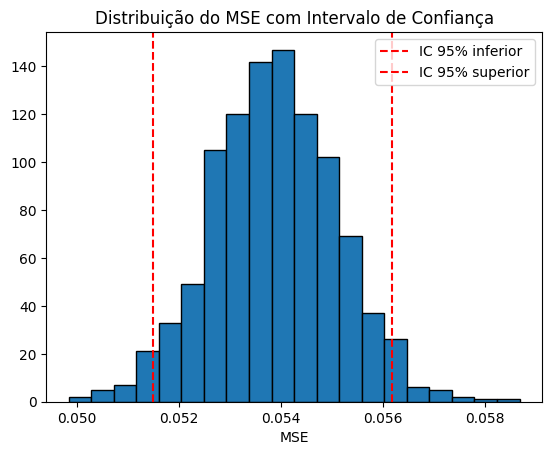

Intervalo de Confiança 95% para o MSE: (0.0515, 0.0562)


In [ ]:
# Calcular MSE e intervalo de confiança
mse_values = bootstrap_mse(x, y, alpha, beta)
li = np.percentile(mse_values, 2.5)
ls = np.percentile(mse_values, 97.5)

plt.hist(mse_values, bins=20, edgecolor='k')
plt.axvline(x=li, color='r', linestyle='--', label='IC 95% inferior')
plt.axvline(x=ls, color='r', linestyle='--', label='IC 95% superior')
plt.xlabel('MSE')
plt.title('Distribuição do MSE com Intervalo de Confiança')
plt.legend()
plt.show()

print(f"Intervalo de Confiança 95% para o MSE: ({li:.4f}, {ls:.4f})")

O erro quadrático é importante porque ele mede a precisão de um modelo de regressão ao quantificar a diferença entre os valores previstos pelo modelo e os valores reais observados.

O intervalo do erro quadrático sugere que o modelo tem uma precisão relativamente alta, com erros de previsão pequenos.

### 6.4 Regressão linear para energia vs loudness

Como a energy e loudness apresentaram uma alta correlação, decidimos projetar uma regressão linear com essas variáveis.

In [ ]:
x = df_reg_normalized['energy'].values
y = df_reg_normalized['loudness'].values

alpha, beta = least_squares_fit(x, y)

print("Valores ótimos de Alpha e Beta\n")
print(f"Alfa: {alpha:.2f}")
print(f"Beta: {beta:.2f}")

print("\nEquação da regressão linear:")
print(f"y = {alpha:.2f} {beta:.2f}x")

Valores ótimos de Alpha e Beta

Alfa: 0.47
Beta: 0.40

Equação da regressão linear:
y = 0.47 0.40x


In [ ]:
final_chart = plot_regressao(df_reg_normalized, alpha, beta, 'energy', 'loudness', 'Energy vs Loudness')
final_chart.display()

/usr/local/lib/python3.10/dist-packages/altair/utils/core.py:384: FutureWarning: the convert_dtype parameter is deprecated and will be removed in a future version.  Do ``ser.astype(object).apply()`` instead if you want ``convert_dtype=False``.
  col = df[col_name].apply(to_list_if_array, convert_dtype=False)


alt.LayerChart(...)

In [ ]:
R2 = r_squared(alpha, beta, x, y)
print (f"R2 no modelo com os valores ótimos de α e β: {R2:.4f}")

R2 no modelo com os valores ótimos de α e β: 0.4789


Quanto maior for o R2 , melhor o nosso modelo se ajusta aos dados. Um R2 próximo da metade sugere que o modelo de regressão explica metade da variação observada nos dados, indicando uma capacidade de previsão moderada.

In [ ]:
# Verificar se a raiz de R2 é a própria correlação
print(r_squared(alpha, beta, x, y) ** 0.5, ss.pearsonr(x, y)[0])

0.6920252569479428 0.6920252569479428


Erro quadrático médio

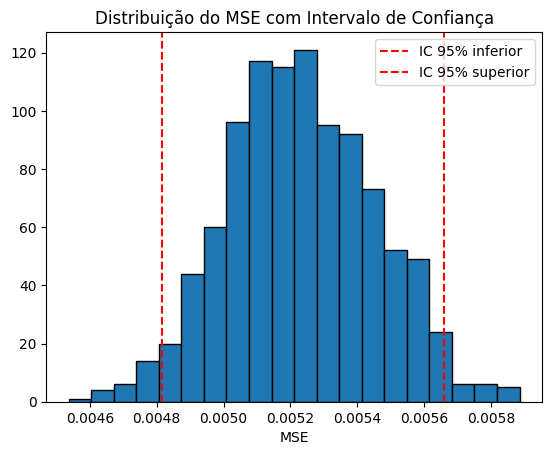

Intervalo de Confiança 95% para o MSE: (0.0048, 0.0057)


In [ ]:
# Calcular MSE e intervalo de confiança
mse_values = bootstrap_mse(x, y, alpha, beta)
li = np.percentile(mse_values, 2.5)
ls = np.percentile(mse_values, 97.5)

plt.hist(mse_values, bins=20, edgecolor='k')
plt.axvline(x=li, color='r', linestyle='--', label='IC 95% inferior')
plt.axvline(x=ls, color='r', linestyle='--', label='IC 95% superior')
plt.xlabel('MSE')
plt.title('Distribuição do MSE com Intervalo de Confiança')
plt.legend()
plt.show()

print(f"Intervalo de Confiança 95% para o MSE: ({li:.4f}, {ls:.4f})")

O erro quadrático é importante porque ele mede a precisão de um modelo de regressão ao quantificar a diferença entre os valores previstos pelo modelo e os valores reais observados.

O intervalo do erro quadrático sugere que o modelo tem uma precisão relativamente alta, com erros de previsão pequenos.

### 6.5. Regressão múltipla

A regressão múltipla é uma técnica estatística que estende a regressão linear simples para incluir mais de uma variável independente. Ela nos permite uma análise mais rica e detalhada ao considerar múltiplas influências sobre as músicas

#### 6.5.1 Prever "track_popularity"

Para interpretar os intervalos de confiança das variáveis na regressão múltipla vale lembrar:

**Coeficiente(coef)**: Representa a estimativa do efeito médio na variável resposta (y) para cada unidade de mudança na variável preditora, mantendo todas as outras variáveis constantes.

**Std Err**: É o erro padrão da estimativa do coeficiente. Quanto menor o erro padrão, mais precisa é a estimativa do coeficiente.

**t**: É a estatística t associada ao coeficiente, calculada como o coeficiente dividido pelo erro padrão. É usada para testar se o coeficiente é significativamente diferente de zero.

**P>|t|**: É o valor p associado ao teste t. Ele indica a probabilidade de observar um valor de estatística t pelo menos tão extremo quanto o observado, se a hipótese nula de que o coeficiente é zero for verdadeira. Valores p baixos (geralmente menores que 0,05) indicam que o coeficiente é estatisticamente significativo.

**[0.025, 0.975]**: São os limites inferior e superior do intervalo de confiança de 95% para o coeficiente. Isso significa que temos 95% de confiança de que o verdadeiro valor do coeficiente está dentro dessa faixa.

Vamos executar a regressão para prever a popularidade da música (track_popularity), utilizando as variáveis mais importantes de acordo com a matriz de correlação.

In [ ]:
#Selecionando as variáveis
cols_x = ['artist_popularity', 'danceability', 'energy',
            'acousticness', 'liveness', 'loudness',
            'speechiness', 'instrumentalness', 'valence', 'tempo']
#Variável alvo
cols_y = ['track_popularity']
#Regressão em statsmodels
df_X = sm.add_constant(df_regressao[cols_x])
y = df_regressao[cols_y].sum(axis='columns')
model = sm.OLS(
    endog=y,
    exog=df_X
)
fitted = model.fit()
print(fitted.summary())

                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.081
Model:                            OLS   Adj. R-squared:                  0.078
Method:                 Least Squares   F-statistic:                     21.19
Date:                Sun, 18 Aug 2024   Prob (F-statistic):           3.23e-38
Time:                        19:25:24   Log-Likelihood:                -9451.1
No. Observations:                2400   AIC:                         1.892e+04
Df Residuals:                    2389   BIC:                         1.899e+04
Df Model:                          10                                         
Covariance Type:            nonrobust                                         
                        coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------------------------------------
const                49.6233      3.67

**Principais Elementos do Resultado**

* **R-squared (R²):** 0.081

Este valor indica a proporção da variabilidade de y que é explicada pelas variáveis independentes. Um R² de 0.081 significa que o modelo explica apenas 8,1% da variação em y, o que é bastante baixo. Isso sugere que as variáveis independentes escolhidas não são boas preditoras de y.

* **Adjusted R-squared (R² ajustado):** 0.078

O R² ajustado é uma versão modificada do R² que ajusta o número de preditores no modelo. Um valor de 0.078, que é muito próximo do R², indica que a inclusão de variáveis extras no modelo não contribui significativamente para a explicação da variabilidade de y.

* **F-statistic:** 21.19

O teste F avalia se pelo menos uma das variáveis independentes é estatisticamente significativa para prever y. A probabilidade associada ao F-statistic é muito baixa, indicando que, no conjunto, as variáveis independentes têm um efeito estatisticamente significativo sobre y.

* **Coeficientes (coef):**

Cada coeficiente representa o efeito esperado na variável dependente y para uma unidade de aumento na variável independente correspondente, mantendo as outras constantes.

artist_popularity: O coeficiente é 0.2996, significando que, mantendo as outras variáveis constantes, para cada aumento de uma unidade na popularidade do artista, a variável y aumenta em 0.2996 unidades. Como o p-valor associado é 0.000, este coeficiente é altamente significativo.

Outras variáveis como danceability, energy, acousticness, entre outras, têm coeficientes que não são estatisticamente significativos (p-valor > 0.05), o que indica que essas variáveis não têm um efeito significativo sobre y no modelo atual.

* **P-valor (P>|t|):**

Este valor indica a probabilidade de observar os coeficientes estimados se, na realidade, o efeito da variável independente sobre y for nulo. Um p-valor abaixo de 0.05 geralmente é considerado significativo.
Apenas artist_popularity tem um p-valor significativo (0.000), sugerindo que ela é a única variável independentemente associada a mudanças em y.

* **Omnibus, Jarque-Bera (JB) e Durbin-Watson:**

**Omnibus (1685.383) e Jarque-Bera (26685.867):** Esses testes avaliam se os resíduos seguem uma distribuição normal. Os valores elevados e as probabilidades associadas a 0.000 indicam que os resíduos não são normalmente distribuídos, o que pode violar uma das suposições da regressão linear.

**Durbin-Watson (1.369):** Mede a autocorrelação dos resíduos. Um valor próximo de 2 sugere que não há correlação. Um valor de 1.369 pode sugerir alguma autocorrelação positiva nos resíduos, o que é uma violação potencial das suposições do modelo.

**Condition Number (2.49e+03):**

Um número de condição elevado sugere problemas de multicolinearidade (quando duas ou mais variáveis independentes estão fortemente correlacionadas). Esse valor indica que pode haver multicolinearidade no modelo, o que pode tornar difícil a interpretação dos coeficientes.

**Conclusões Gerais**
O modelo não é muito eficaz em explicar a variabilidade de y, com um R² baixo. A maioria das variáveis independentes não é estatisticamente significativa. Há indícios de problemas de multicolinearidade e não-normalidade dos resíduos, o que pode afetar a confiabilidade dos resultados. A única variável que parece ter um efeito significativo sobre y é artist_popularity.

Erros quadráticos médio

Média dos Erros Quadráticos Normalizados (MSE): 0.0167
Intervalo de Confiança do MSE Normalizado (95%): [0.0142, 0.0195]


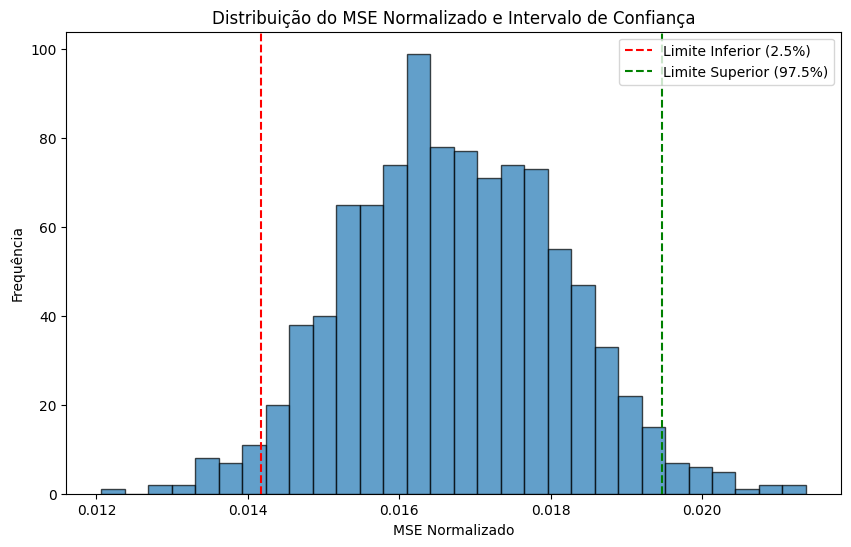

In [ ]:
# Função para bootstrap dos erros quadráticos
def bootstrap_mse_mult(X, y, model, n=1000):
    size = len(y)
    mse_values = np.zeros(n)

    # Convertendo DataFrame para array numpy
    X_array = X.values
    y_array = y

    for i in range(n):
        idx = np.random.choice(size, size, replace=True)
        X_b = X_array[idx]
        y_b = y_array[idx]
        y_pred_b = model.predict(sm.add_constant(X_b))
        mse_values[i] = np.mean((y_b - y_pred_b) ** 2)

    return mse_values
# Prever os valores
y_pred = fitted.predict(df_X)

# Convertendo para arrays NumPy
y_array = np.array(y)
y_pred_array = np.array(y_pred)

# Normalização dos dados
scaler = MinMaxScaler()
y_normalized = scaler.fit_transform(y_array.reshape(-1, 1)).flatten()
y_pred_normalized = scaler.transform(y_pred_array.reshape(-1, 1)).flatten()

# Calcular o Erro Quadrático Médio (MSE) normalizado
mse_normalized = np.mean((y_normalized - y_pred_normalized) ** 2)
print(f"Média dos Erros Quadráticos Normalizados (MSE): {mse_normalized:.4f}")

# Realizar o bootstrap para calcular o intervalo de confiança
mse_values = bootstrap_mse_mult(df_X, y_array, fitted, n=1000)

# Normalizar os valores de bootstrap
mse_values_normalized = np.zeros_like(mse_values)
for i in range(len(mse_values)):
    # Usando dados bootstrap para calcular os valores de MSE normalizados
    idx = np.random.choice(len(df_X), len(df_X), replace=True)
    X_b = df_X.iloc[idx]
    y_b = y_array[idx]
    y_pred_b = fitted.predict(X_b)

    # Convertendo para array NumPy
    y_b_array = np.array(y_b)
    y_pred_b_array = np.array(y_pred_b)

    y_b_normalized = scaler.transform(y_b_array.reshape(-1, 1)).flatten()
    y_pred_b_normalized = scaler.transform(y_pred_b_array.reshape(-1, 1)).flatten()

    mse_values_normalized[i] = np.mean((y_b_normalized - y_pred_b_normalized) ** 2)

CI_lower = np.percentile(mse_values_normalized, 2.5)
CI_upper = np.percentile(mse_values_normalized, 97.5)

# Exibir intervalo de confiança
print(f"Intervalo de Confiança do MSE Normalizado (95%): [{CI_lower:.4f}, {CI_upper:.4f}]")

# Criar o gráfico de distribuição do MSE
plt.figure(figsize=(10, 6))
plt.hist(mse_values_normalized, bins=30, edgecolor='k', alpha=0.7)
plt.axvline(CI_lower, color='r', linestyle='--', label='Limite Inferior (2.5%)')
plt.axvline(CI_upper, color='g', linestyle='--', label='Limite Superior (97.5%)')
plt.xlabel('MSE Normalizado')
plt.ylabel('Frequência')
plt.title('Distribuição do MSE Normalizado e Intervalo de Confiança')
plt.legend()
plt.show()


O erro quadrático é importante porque ele mede a precisão de um modelo de regressão ao quantificar a diferença entre os valores previstos pelo modelo e os valores reais observados.

Um intervalo de erro quadrático de 0.0139 a 0.0197 sugere que o modelo tem uma precisão relativamente alta, com erros de previsão pequenos.

#### 6.5.2 Prever "valence"

In [ ]:
#Selecionando as variáveis
cols_x = ['danceability', 'energy', 'loudness']
#Variável alvo
cols_y = ['valence']
#Regressão em statsmodels
df_X = sm.add_constant(df_regressao[cols_x])
y = df_regressao[cols_y].sum(axis='columns')
model = sm.OLS(
    endog=y,
    exog=df_X
)
fitted = model.fit()
print(fitted.summary())

                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.334
Model:                            OLS   Adj. R-squared:                  0.333
Method:                 Least Squares   F-statistic:                     401.1
Date:                Sun, 18 Aug 2024   Prob (F-statistic):          4.47e-211
Time:                        19:25:27   Log-Likelihood:                 621.06
No. Observations:                2400   AIC:                            -1234.
Df Residuals:                    2396   BIC:                            -1211.
Df Model:                           3                                         
Covariance Type:            nonrobust                                         
                   coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------
const           -0.2684      0.040     -6.691   

**Principais Elementos do Resultado**

* **R-squared (R²):** 0.334

Este valor indica a proporção da variabilidade de y que é explicada pelas variáveis independentes. Um R² de 0.334 significa que o modelo explica apenas 3,34% da variação em y, o que é bastante baixo. Isso sugere que as variáveis independentes escolhidas não são boas preditoras de y.

* **Adjusted R-squared (R² ajustado):** 0.333

O R² ajustado é uma versão modificada do R² que ajusta o número de preditores no modelo. Um valor de 0.333, que é muito próximo do R², indica que a inclusão de variáveis extras no modelo não contribui significativamente para a explicação da variabilidade de y.

* **F-statistic:** 401.1

O teste F avalia se pelo menos uma das variáveis independentes é estatisticamente significativa para prever y. A probabilidade associada ao F-statistic é muito baixa, indicando que, no conjunto, as variáveis independentes têm um efeito estatisticamente significativo sobre y.

* **Coeficientes (coef):**

Cada coeficiente representa o efeito esperado na variável dependente y para uma unidade de aumento na variável independente correspondente, mantendo as outras constantes.

* As variáveis danceability e energy tem coeficientes significativos e o valores no intervalo de confiança não inclui zero, logo elas têm um impacto positivo na variável dependente.

* A outra variável loudness não é estatisticamente significativo, o que sugere que, no contexto deste modelo, o volume pode não ser um preditor relevante da variável dependente.

* **P-valor (P>|t|):**

Este valor indica a probabilidade de observar os coeficientes estimados se, na realidade, o efeito da variável independente sobre y for nulo. Um p-valor abaixo de 0.05 geralmente é considerado significativo.
As variáveis danceability e energy tem um p-valor significativo (0.000), sugerindo que elas são estatisticamente significantes.

* **Omnibus, Jarque-Bera (JB) e Durbin-Watson:**

**Omnibus (34.924) e Jarque-Bera (26.263):** Esses testes avaliam se os resíduos seguem uma distribuição normal. Os valores elevados e as probabilidades associadas a 0.000 indicam que os resíduos não são normalmente distribuídos, o que pode violar uma das suposições da regressão linear.

**Durbin-Watson (1.869):** Mede a autocorrelação dos resíduos. Um valor próximo de 2 sugere que não há correlação. Um valor de 1.869 pode sugerir alguma autocorrelação positiva nos resíduos, o que é uma violação potencial das suposições do modelo.

**Condition Number (84.0):**

Um número de condição elevado sugere problemas de multicolinearidade (quando duas ou mais variáveis independentes estão fortemente correlacionadas). Esse valor indica que pode haver multicolinearidade no modelo, o que pode tornar difícil a interpretação dos coeficientes.

Média dos Erros Quadráticos Normalizados (MSE): 0.0398
Intervalo de Confiança do MSE Normalizado (95%): [0.0378, 0.0419]


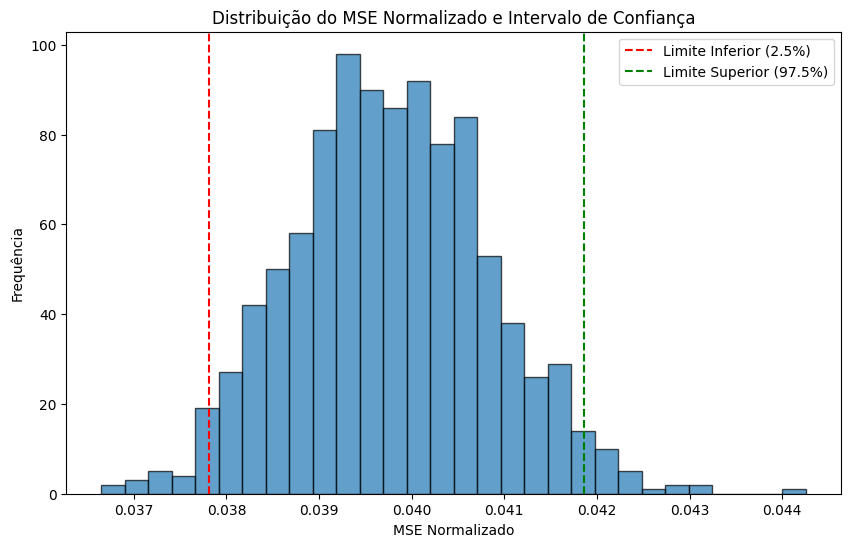

In [ ]:
# Função para bootstrap dos erros quadráticos
def bootstrap_mse_mult(X, y, model, n=1000):
    size = len(y)
    mse_values = np.zeros(n)

    # Convertendo DataFrame para array numpy
    X_array = X.values
    y_array = y

    for i in range(n):
        idx = np.random.choice(size, size, replace=True)
        X_b = X_array[idx]
        y_b = y_array[idx]
        y_pred_b = model.predict(sm.add_constant(X_b))
        mse_values[i] = np.mean((y_b - y_pred_b) ** 2)

    return mse_values
# Prever os valores
y_pred = fitted.predict(df_X)

# Convertendo para arrays NumPy
y_array = np.array(y)
y_pred_array = np.array(y_pred)

# Normalização dos dados
scaler = MinMaxScaler()
y_normalized = scaler.fit_transform(y_array.reshape(-1, 1)).flatten()
y_pred_normalized = scaler.transform(y_pred_array.reshape(-1, 1)).flatten()

# Calcular o Erro Quadrático Médio (MSE) normalizado
mse_normalized = np.mean((y_normalized - y_pred_normalized) ** 2)
print(f"Média dos Erros Quadráticos Normalizados (MSE): {mse_normalized:.4f}")

# Realizar o bootstrap para calcular o intervalo de confiança
mse_values = bootstrap_mse_mult(df_X, y_array, fitted, n=1000)

# Normalizar os valores de bootstrap
mse_values_normalized = np.zeros_like(mse_values)
for i in range(len(mse_values)):
    # Usando dados bootstrap para calcular os valores de MSE normalizados
    idx = np.random.choice(len(df_X), len(df_X), replace=True)
    X_b = df_X.iloc[idx]
    y_b = y_array[idx]
    y_pred_b = fitted.predict(X_b)

    # Convertendo para array NumPy
    y_b_array = np.array(y_b)
    y_pred_b_array = np.array(y_pred_b)

    y_b_normalized = scaler.transform(y_b_array.reshape(-1, 1)).flatten()
    y_pred_b_normalized = scaler.transform(y_pred_b_array.reshape(-1, 1)).flatten()

    mse_values_normalized[i] = np.mean((y_b_normalized - y_pred_b_normalized) ** 2)

CI_lower = np.percentile(mse_values_normalized, 2.5)
CI_upper = np.percentile(mse_values_normalized, 97.5)

# Exibir intervalo de confiança
print(f"Intervalo de Confiança do MSE Normalizado (95%): [{CI_lower:.4f}, {CI_upper:.4f}]")

# Criar o gráfico de distribuição do MSE
plt.figure(figsize=(10, 6))
plt.hist(mse_values_normalized, bins=30, edgecolor='k', alpha=0.7)
plt.axvline(CI_lower, color='r', linestyle='--', label='Limite Inferior (2.5%)')
plt.axvline(CI_upper, color='g', linestyle='--', label='Limite Superior (97.5%)')
plt.xlabel('MSE Normalizado')
plt.ylabel('Frequência')
plt.title('Distribuição do MSE Normalizado e Intervalo de Confiança')
plt.legend()
plt.show()


O erro quadrático é importante porque ele mede a precisão de um modelo de regressão ao quantificar a diferença entre os valores previstos pelo modelo e os valores reais observados.

Um intervalo de erro quadrático de 0.0138 a 0.0198 sugere que o modelo tem uma precisão relativamente alta, com erros de previsão pequenos.

#### 6.5.3 Prever "track_popularity" usando KNN


A regressão com KNN é um tipo de regressão que a previsão para um ponto é baseada nas observações mais próximas a ele e o valor previsto é a média dos valores de saída dos vizinhos.

A regressão múltipla com KNN pode ser uma abordagem eficaz para modelos com dados complexos e não lineares.

In [ ]:
df_mult = df_playlist_2000to2023[['track_popularity',
            'artist_popularity', 'danceability', 'energy',
            'acousticness', 'liveness', 'loudness',
            'speechiness', 'instrumentalness', 'valence', 'tempo']].copy()
df_mult.head()

,track_popularity,artist_popularity,danceability,energy,acousticness,liveness,loudness,speechiness,instrumentalness,valence,tempo
0,81,81,0.751,0.834,0.3000,0.3550,-5.444,0.0437,0.000018,0.894,95.053
1,83,79,0.434,0.897,0.0103,0.6120,-4.918,0.0488,0.000000,0.684,148.726
2,66,62,0.529,0.496,0.1730,0.2510,-9.007,0.0290,0.000000,0.278,136.859
3,81,79,0.551,0.913,0.0263,0.3470,-4.063,0.0466,0.000013,0.544,119.992
4,75,70,0.610,0.926,0.0310,0.0821,-4.843,0.0479,0.001200,0.861,172.638


In [ ]:
from sklearn.model_selection import cross_val_score, KFold
from sklearn.preprocessing import MinMaxScaler, StandardScaler  # Importações dos scalers
import pandas as pd
import numpy as np
from sklearn.neighbors import KNeighborsClassifier
from sklearn.model_selection import train_test_split  # Incluída a importação de GridSearchCV
from sklearn.neighbors import KNeighborsRegressor  # Importação do KNN Regressor
import matplotlib.pyplot as plt
from sklearn.metrics import mean_squared_error

# Criar o MinMaxScaler
scaler = MinMaxScaler()

# Aplicar o scaler a todas as colunas de df_prever
df_mult_normalized = pd.DataFrame(scaler.fit_transform(df_mult), columns=df_mult.columns)

In [ ]:
# Extrair os valores do DataFrame e armazená-los na variável 'dados'
X = df_mult_normalized.drop(columns=['track_popularity']).values  # Exclua a coluna de alvo
# Extrair classes alvo do conjunto de dados
y = df_mult_normalized['track_popularity'].values

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3)

O algoritmo abaixo realiza a validação cruzada para encontrar o melhor valor de k em um modelo de regressão K-Nearest Neighbors (KNN).

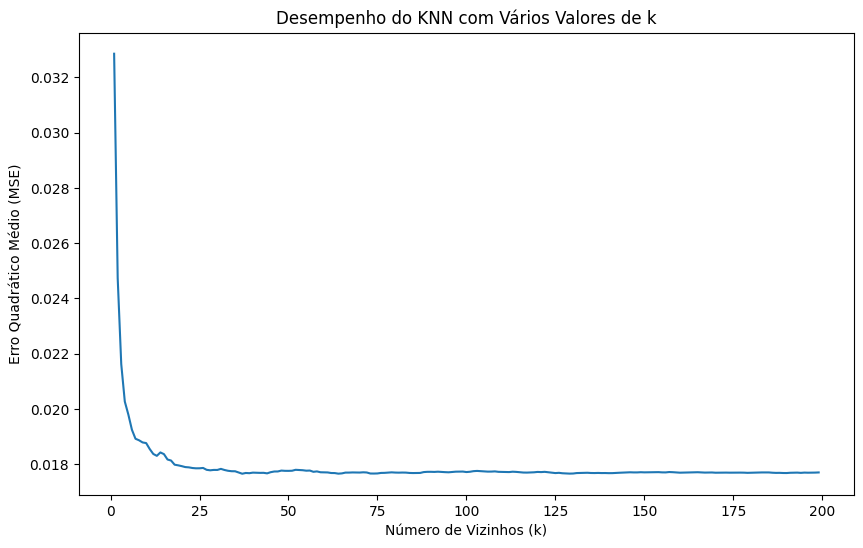

In [ ]:
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)
neighbors_range = range(1, 200)

cv_scores = []

# Definir o número de folds para validação cruzada
kf = KFold(n_splits=5, shuffle=True, random_state=42)

# Avaliar o desempenho para cada valor de n_neighbors
for k in neighbors_range:
    knn = KNeighborsRegressor(n_neighbors=k)
    scores = cross_val_score(knn, X_train_scaled, y_train, cv=kf, scoring='neg_mean_squared_error')
    cv_scores.append(np.mean(-scores))  # Armazenar a média do erro quadrático negativo

plt.figure(figsize=(10, 6))
plt.plot(neighbors_range, cv_scores)
plt.xlabel('Número de Vizinhos (k)')
plt.ylabel('Erro Quadrático Médio (MSE)')
plt.title('Desempenho do KNN com Vários Valores de k')

plt.show()

In [ ]:
# Encontrar o melhor número de vizinhos
best_k = neighbors_range[np.argmin(cv_scores)]
best_mse = np.min(cv_scores)

# Imprimir o melhor número de vizinhos e o erro quadrático médio correspondente
print(f'O melhor número de vizinhos é: {best_k}')
print(f'Erro Quadrático Médio correspondente: {best_mse}')


O melhor número de vizinhos é: 37
Erro Quadrático Médio correspondente: 0.017656927229549164


In [ ]:
knn = KNeighborsRegressor(n_neighbors=best_k)
knn.fit(X_train_scaled, y_train)
y_pred = knn.predict(X_test_scaled)
mse = mean_squared_error(y_test, y_pred)
print(f'Mean Squared Error: {mse}')

Mean Squared Error: 0.017004727753513648


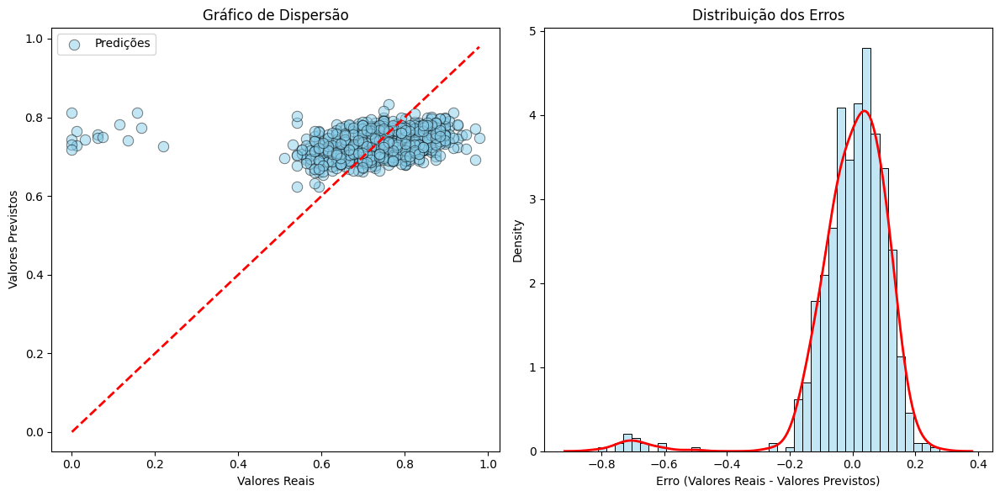

In [ ]:
df = pd.DataFrame({
    'Valores Reais': y_test,
    'Valores Previstos': y_pred
})

# Gráfico de Dispersão e Gráfico de Erros
plt.figure(figsize=(12, 6))

# Scatter plot
plt.subplot(1, 2, 1)
sns.scatterplot(x='Valores Reais', y='Valores Previstos', data=df, color='skyblue', alpha=0.5, edgecolor='k', s=80, label='Predições')
plt.plot([min(y_test), max(y_test)], [min(y_test), max(y_test)], 'r--', lw=2, label= 'Linha de identidade')
plt.xlabel('Valores Reais')
plt.ylabel('Valores Previstos')
plt.title('Gráfico de Dispersão')

# Gráfico de Erros
plt.subplot(1, 2, 2)
errors = df['Valores Reais'] - df['Valores Previstos']
sns.histplot(errors, kde=True, color='skyblue', stat='density')
plt.xlabel('Erro (Valores Reais - Valores Previstos)')
plt.title('Distribuição dos Erros')

# Adiciona a linha KDE separadamente para permitir a mudança de cor
sns.kdeplot(errors, color='red', linewidth=2)

plt.tight_layout()
plt.show()

Linha de Identidade: A reta vermelha (r--) que você vê no gráfico de dispersão é a linha de identidade, que tem a equação y = x. Ela representa onde os valores previstos seriam iguais aos valores reais. Em outras palavras, para qualquer ponto sobre essa linha, o valor previsto pelo modelo é exatamente o mesmo que o valor real.

obs: a célula abaixo demora por volta de 1min pra rodar

In [ ]:
def bootstrap_mse_knn(X, y, model, n=1000):
    size = len(y)
    values = np.zeros(n)
    for i in range(n):
        idx = np.random.choice(size, size)
        Xb = X[idx]
        yb = y[idx]
        values[i] = mean_squared_error(yb, model.predict(Xb))

    # Normalizando os valores de MSE entre 0 e 1
    scaler = MinMaxScaler()
    values = scaler.fit_transform(values.reshape(-1, 1)).flatten()

    return values
mse_values = bootstrap_mse_knn(X_train, y_train, knn)

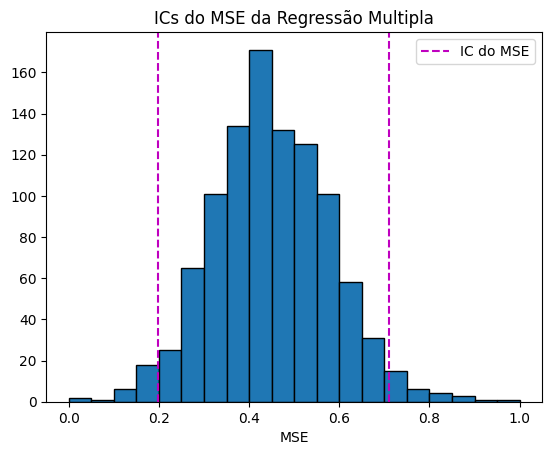

Intervalo de Confiança do MSE Normalizado (95%): [0.1972, 0.7106]


In [ ]:
LI = np.percentile(mse_values, 2.5)
LS = np.percentile(mse_values, 97.5)

plt.hist(mse_values, bins=20, edgecolor='k')
plt.axvline(x=LI, linestyle='--', label='IC do MSE', color='m')
plt.axvline(x=LS, linestyle='--', color='m')
plt.xlabel('MSE')
plt.title('ICs do MSE da Regressão Multipla')

plt.legend()
plt.show()

# Exibir intervalo de confiança
print(f"Intervalo de Confiança do MSE Normalizado (95%): [{LI:.4f}, {LS:.4f}]")

O erro quadrático é importante porque mede a precisão de um modelo de regressão ao quantificar a diferença entre os valores previstos pelo modelo e os valores reais observados.

Um intervalo do erro quadrático sugere que o modelo tem uma variação significativa na precisão. O valor mais baixo do intervalo diz respeito a um ajuste relativamente bom, com erros de previsão menores, enquanto o valor mais alto sugere uma maior discrepância entre os valores previstos e reais, indicando que o modelo pode não ter um desempenho consistente em todas as situações.

#### 6.5.4 Visualizaçõa dinâmica

Abaixo, podemos selecionar uma área específica do gráfico com o mouse e analisar como as variáveis se comportam dentro dessa seleção. Esse recurso facilita a visualização do impacto de diferentes variáveis na popularidade das músicas.

In [ ]:
import altair as alt

# Definir a seleção interativa
interval = alt.selection_interval()

# Criar o gráfico base
base = alt.Chart(df_regressao).mark_point().encode(
    y='track_popularity',  # Ajuste o nome da coluna conforme necessário
    color=alt.condition(interval, alt.value('orange'), alt.value('black'))  # Ajuste as cores conforme necessário
).properties(
    selection=interval
)

# Criar gráficos para cada coluna desejada
chart_x_artist_popularity = base.encode(x='artist_popularity')
chart_x_danceability = base.encode(x='danceability')
chart_x_energy = base.encode(x='energy')
chart_x_acousticness = base.encode(x='acousticness')
chart_x_liveness = base.encode(x='liveness')
chart_x_loudness = base.encode(x='loudness')
chart_x_speechiness = base.encode(x='speechiness')
chart_x_instrumentalness = base.encode(x='instrumentalness')
chart_x_valence = base.encode(x='valence')
chart_x_tempo = base.encode(x='tempo')

# Organizar os gráficos em um layout de duas colunas
row1 = alt.hconcat(
    chart_x_artist_popularity,
    chart_x_danceability
)

row2 = alt.hconcat(
    chart_x_energy,
    chart_x_acousticness
)

row3 = alt.hconcat(
    chart_x_liveness,
    chart_x_loudness
)

row4 = alt.hconcat(
    chart_x_speechiness,
    chart_x_instrumentalness
)

row5 = alt.hconcat(
    chart_x_valence,
    chart_x_tempo
)

# Organizar todas as linhas em um layout vertical
final_chart = alt.vconcat(
    row1,
    row2,
    row3,
    row4,
    row5
).resolve_scale(y='shared')  # Alinhar eixos y

# Exibir o gráfico
final_chart

/usr/local/lib/python3.10/dist-packages/altair/utils/core.py:384: FutureWarning: the convert_dtype parameter is deprecated and will be removed in a future version.  Do ``ser.astype(object).apply()`` instead if you want ``convert_dtype=False``.
  col = df[col_name].apply(to_list_if_array, convert_dtype=False)
/usr/local/lib/python3.10/dist-packages/altair/utils/core.py:384: FutureWarning: the convert_dtype parameter is deprecated and will be removed in a future version.  Do ``ser.astype(object).apply()`` instead if you want ``convert_dtype=False``.
  col = df[col_name].apply(to_list_if_array, convert_dtype=False)


alt.VConcatChart(...)

## **7. Classificação - K-Nearest Neighbors (KNN) e Naive Bayes**

Vamos realizar a classificação utilizando o algoritmo K-Nearest Neighbors (KNN), e posteriormente comparar seus resultados com o algoritmo Naive Bayes. A escolha desses dois algoritmos se deve às suas distintas abordagens e características.

**K-Nearest Neighbors (KNN)**

K-Nearest Neighbors (KNN) é um algoritmo de aprendizado de máquina que pode ser usado tanto para classificação quanto para regressão. A ideia central é que pontos de dados semelhantes estão próximos uns dos outros. Portanto, para prever a classe ou o valor de um ponto de dados desconhecido, o KNN usa as informações dos pontos mais próximos (vizinhos) que já conhece.

**Naive Bayes**

O Naive Bayes é um algoritmo de classificação baseado no teorema de Bayes, que é utilizado para prever a classe de um conjunto de dados com base nas probabilidades condicionais dos atributos.

O "naive" (ingênuo) no Naive Bayes vem da suposição simplificadora de que todos os atributos (ou variáveis independentes) são independentes entre si, dado que conhecemos a classe. Isso significa que o valor de um atributo não afeta o valor de outro atributo dentro da mesma classe.

**Avaliação de Resultados**

**Matriz de Confusão:** Realiza uma comparação entre os valores obtidos em duas colunas de valores categóricos. Quando a resposta é binária(0 ou 1), temos a tabela com os valores obtidos que batem ou não (True Positive, False Negative, False Positive, True Negative).

**Acurácia:** Retorna a acurácia do modelo, ou seja, a % de acertos em relação ao total de previsões realizadas.
Obs.: Esta não é uma boa métrica de avaliação em conjuntos de dados que não são distribuídos igualmente. Em um dataset no qual 99% do target equivale a um mesmo valor, um modelo que prevê que ocorrerá sempre esse valor obtêm uma acurácia de 99%.

Cálculo: (TP + TN) / (TP + TN + FP + FN)

**Precisão:** A precisão mede qual a taxa de acerto do modelo em suas previsões positivas.

Cálculo:: TP / (TP + FP)

**Revocação (recall):** A revocação mede a taxa de acerto do modelo em suas previsões referentes aos valores que são positivos no conjunto de teste.
Cálculo:: TP / (TP + FN)

**F1-Score:** A estatística F1 calcula uma média harmônica entre a precisão e o recall de um modelo (penalizando valores menores), a fim de maximizar ambos ao mesmo tempo.
Cálculo:: 2 * (precisão * recall) / (precisão + recall)

Dessa forma, usamos esses 2 algoritmos nas variáveis "track_popularity" e "artist_popularity", para prever/classificar a popularidade das músicas e artistas com base em outras características (features) do banco de dados.

As features dos modelos forma escolhidas com base na imagem da matriz de correlação (secção 5), de forma que, as colunas com maior correlação com "track_popularity" e "artist_popularity", foram consideradas as mais adequadas para serem usadas na execução dos modelo.

##### Função utilizada para realizar a validação cruzada:

In [ ]:
from sklearn.datasets import load_breast_cancer
import pandas as pd
import numpy as np
from sklearn import metrics
from sklearn.ensemble import RandomForestClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.model_selection import StratifiedKFold

import seaborn as sns
from sklearn.metrics import confusion_matrix, precision_score, recall_score, f1_score, accuracy_score
from sklearn.model_selection import StratifiedKFold, cross_val_predict
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split

def avaliar_configuracao(config, dados, alvo, validacao_cruzada):
    # Realiza a validação cruzada e obtém as previsões para cada divisão dos dados
    # config: modelo de aprendizado de máquina a ser avaliado
    # dados: conjunto de dados de entrada
    # alvo: rótulos verdadeiros das classes
    # validacao_cruzada: número de divisões (folds) para a validação cruzada

    for treino, teste in validacao_cruzada.split(dados, alvo):
        x_treino = dados[treino]
        x_teste = dados[teste]
        y_treino = alvo[treino]
        y_teste = alvo[teste]

        # Treinar o modelo com os dados de treinamento
        config.fit(x_treino, y_treino)

        # Fazer previsões nos dados de teste
        y_previsao = config.predict(x_teste)

    # Calcula e retorna as métricas de avaliação utilizando os rótulos verdadeiros e as previsões obtidas

    # Calcula a precisão utilizando os rótulos verdadeiros e as previsões
    precision = precision_score(y_teste, y_previsao)

    # Calcula a revocação utilizando os rótulos verdadeiros e as previsões
    recall = recall_score(y_teste, y_previsao)

    # Calcula a pontuação F1 utilizando os rótulos verdadeiros e as previsões
    f1 = f1_score(y_teste, y_previsao)

    # Calcula a acurácia utilizando os rótulos verdadeiros e as previsões
    acuracia = accuracy_score(y_teste, y_previsao)

    # Calcula a matriz de confusão utilizando os rótulos verdadeiros e as previsões
    conf_matrix = confusion_matrix(y_teste, y_previsao)

    # Retorna a precisão, revocação, pontuação F1 e matriz de confusão
    return precision, recall, f1, acuracia, conf_matrix

### 7.1 Prever "track_popularity":

**track_popularity:** Classificação de popularidade da música no SPOTIFY, sendo 0 o mais baixo e 100 o mais alto

##### Normalizando os dados e definindo intervalos de Classes

In [ ]:
df_prever  = df_playlist_2000to2023[['track_popularity',
            'artist_popularity', 'danceability', 'energy',
            'mode', 'acousticness', 'liveness', 'loudness',
            'speechiness', 'instrumentalness', 'valence', 'tempo']].copy()
df_prever.head()

,track_popularity,artist_popularity,danceability,energy,mode,acousticness,liveness,loudness,speechiness,instrumentalness,valence,tempo
0,81,81,0.751,0.834,0,0.3000,0.3550,-5.444,0.0437,0.000018,0.894,95.053
1,83,79,0.434,0.897,1,0.0103,0.6120,-4.918,0.0488,0.000000,0.684,148.726
2,66,62,0.529,0.496,1,0.1730,0.2510,-9.007,0.0290,0.000000,0.278,136.859
3,81,79,0.551,0.913,0,0.0263,0.3470,-4.063,0.0466,0.000013,0.544,119.992
4,75,70,0.610,0.926,0,0.0310,0.0821,-4.843,0.0479,0.001200,0.861,172.638


In [ ]:
# Criar o MinMaxScaler
scaler = MinMaxScaler()

# Aplicar o scaler a todas as colunas de df_prever
df_prever_normalized = pd.DataFrame(scaler.fit_transform(df_prever), columns=df_prever.columns)

# Visualizar as primeiras linhas do DataFrame normalizado
print(df_prever_normalized.head())

   track_popularity  artist_popularity  danceability    energy  mode  \
0          0.843750           0.703125      0.724477  0.825784   0.0   
1          0.864583           0.671875      0.334563  0.892303   1.0   
2          0.687500           0.406250      0.451415  0.468905   1.0   
3          0.843750           0.671875      0.478475  0.909196   0.0   
4          0.781250           0.531250      0.551046  0.922923   0.0   

   acousticness  liveness  loudness  speechiness  instrumentalness   valence  \
0      0.306739  0.348643  0.751908     0.038302          0.000018  0.914557   
1      0.010519  0.616910  0.777159     0.047516          0.000000  0.690270   
2      0.176881  0.240084  0.580865     0.011743          0.000000  0.256649   
3      0.026879  0.340292  0.818204     0.043541          0.000014  0.540745   
4      0.031685  0.063779  0.780759     0.045890          0.001218  0.879312   

      tempo  
0  0.232262  
1  0.588095  
2  0.509421  
3  0.397599  
4  0.746622  


Verificar com ".describe()" qual o valor que separa os dados em 50%:

In [ ]:
# Verificar faixa de valores de "track_popularity"
estatisticas = df_prever_normalized['track_popularity'].describe()
print(estatisticas)

count    2400.000000
mean        0.732053
std         0.134982
min         0.000000
25%         0.677083
50%         0.750000
75%         0.812500
max         1.000000
Name: track_popularity, dtype: float64


Vamos definir os intervalos para cada classe:

Classe 1: Representa músicas com "track_popularity" maior que 0.75.

Classe 0: Representa músicas com "track_popularity" menor ou igual a 0.75.

In [ ]:
# Adiciona a coluna 'popularity_binary' com valores binários baseados na popularidade da música
df_prever_normalized['popularity_binary'] = df_prever_normalized['track_popularity'].apply(lambda x: 1 if x > 0.75 else 0)

# Visualizando as primeiras linhas para verificar a nova coluna
print(df_prever_normalized[['track_popularity', 'popularity_binary']].head())

   track_popularity  popularity_binary
0          0.843750                  1
1          0.864583                  1
2          0.687500                  0
3          0.843750                  1
4          0.781250                  1


Verificar se a coluna nova foi adiciona:

In [ ]:
print(df_prever_normalized.columns)

Index(['track_popularity', 'artist_popularity', 'danceability', 'energy',
       'mode', 'acousticness', 'liveness', 'loudness', 'speechiness',
       'instrumentalness', 'valence', 'tempo', 'popularity_binary'],
      dtype='object')


Verificar a distribuição das classes:

In [ ]:
print(df_prever_normalized['popularity_binary'].value_counts())

popularity_binary
0    1275
1    1125
Name: count, dtype: int64


A distribuição das classes na coluna popularity_class é:

Classe 0: 1275 instâncias

Classe 1: 1125 instâncias

##### Encontrar melhor valor de K

O algoritmo abaixo é utilizado para encontrar o melhor valor de k em um modelo de regressão K-Nearest Neighbors (KNN).

obs: o código abaixo demora por volta de 1min pra rodar visto que "neighbors_range" vai de 1 até 200.

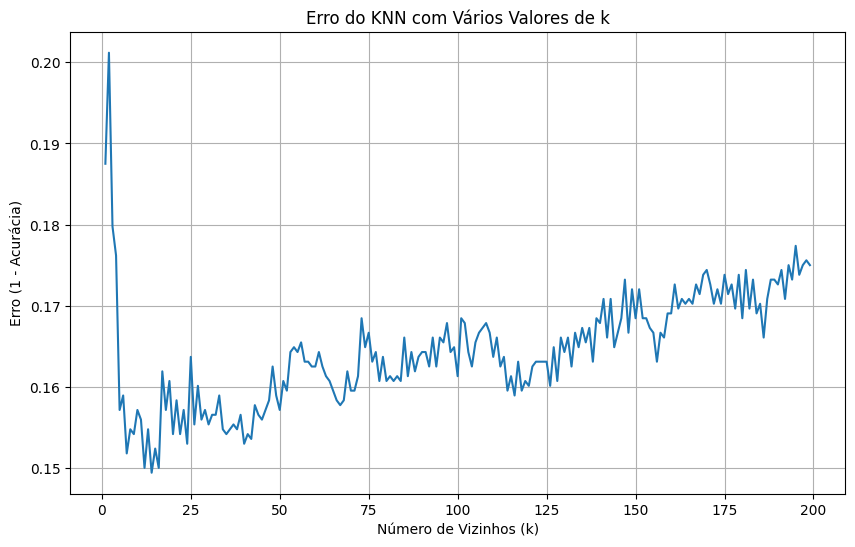

O melhor número de vizinhos é: 14
Erro correspondente: 0.14940476190476182


In [ ]:
# Extrair os valores do DataFrame e armazená-los na variável 'dados'
X = df_prever_normalized.drop(columns=['popularity_binary']).values
y = df_prever_normalized['popularity_binary'].values

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)

scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

neighbors_range = range(1, 200)
cv_scores = []

# Definir o número de folds para validação cruzada
kf = KFold(n_splits=10, shuffle=True, random_state=42)

# Avaliar o desempenho para cada valor de n_neighbors
for k in neighbors_range:
    knn = KNeighborsClassifier(n_neighbors=k)
    scores = cross_val_score(knn, X_train_scaled, y_train, cv=kf, scoring='accuracy')
    cv_scores.append(1 - np.mean(scores))  # Calcular o erro como 1 - acurácia média

plt.figure(figsize=(10, 6))
plt.plot(neighbors_range, cv_scores)
plt.xlabel('Número de Vizinhos (k)')
plt.ylabel('Erro (1 - Acurácia)')
plt.title('Erro do KNN com Vários Valores de k')
plt.grid(True)
plt.show()

# Encontrar o melhor número de vizinhos
best_k = neighbors_range[np.argmin(cv_scores)]
best_error = np.min(cv_scores)

# Imprimir o melhor número de vizinhos e o erro correspondente
print(f'O melhor número de vizinhos é: {best_k}')
print(f'Erro correspondente: {best_error}')

##### **KNN**

O KNN foi usado para prever "track_popularity" analisando as características de uma música em comparação com outras no conjunto de dados. Ele decide a popularidade com base na popularidade das músicas que são mais semelhantes (ou "vizinhas") em termos de suas características.

Executando o KNN:

Configuração utilizada: {'n_neighbors': 14}
Precisão: 0.7623
Revocação: 0.7556
F1: 0.7589
Acurácia: 0.7750


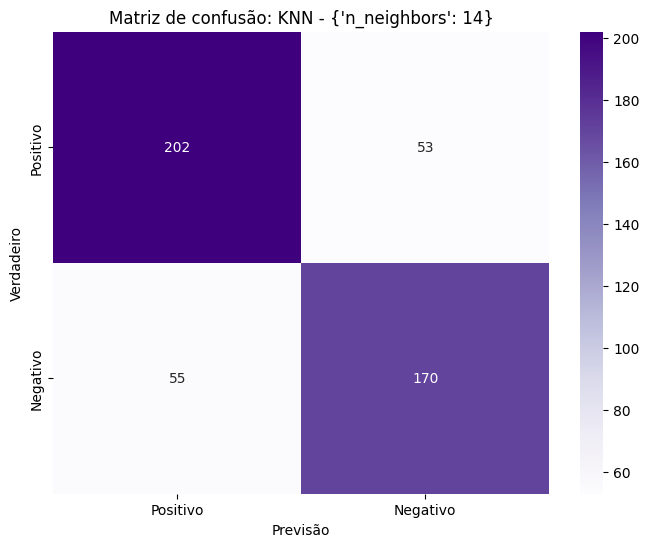



Configuração utilizada: {'n_neighbors': 5}
Precisão: 0.7561
Revocação: 0.8267
F1: 0.7898
Acurácia: 0.7937


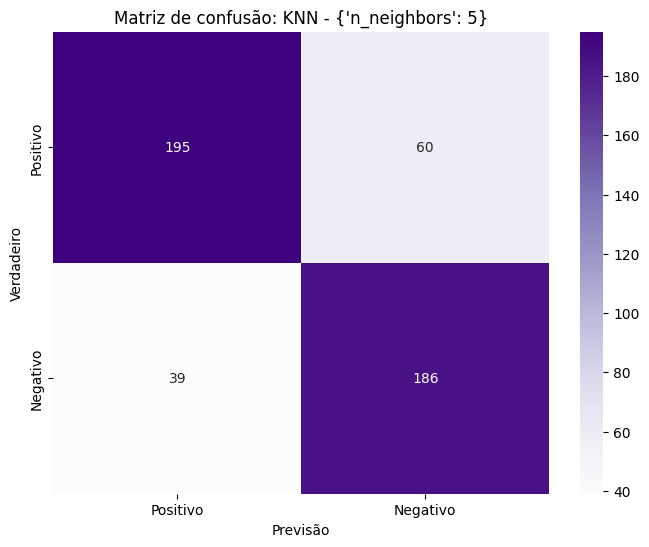



Configuração utilizada: {'n_neighbors': 10}
Precisão: 0.8233
Revocação: 0.7867
F1: 0.8045
Acurácia: 0.8208


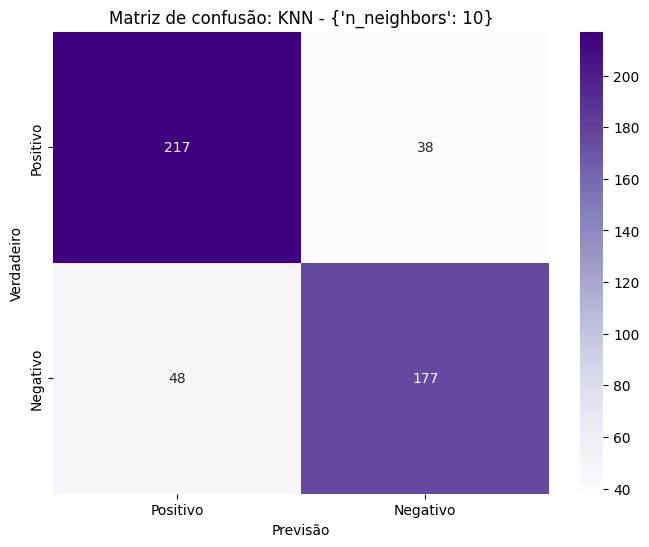



Configuração utilizada: {'n_neighbors': 20}
Precisão: 0.7521
Revocação: 0.7822
F1: 0.7669
Acurácia: 0.7771


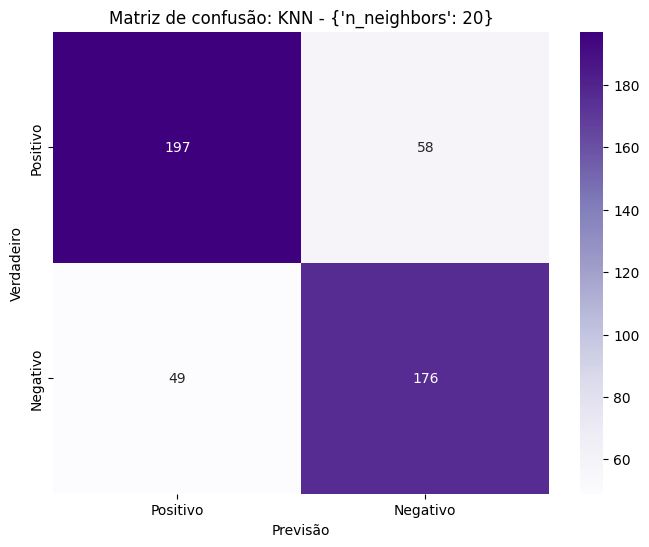



Configuração utilizada: {'n_neighbors': 50}
Precisão: 0.7427
Revocação: 0.7956
F1: 0.7682
Acurácia: 0.7750


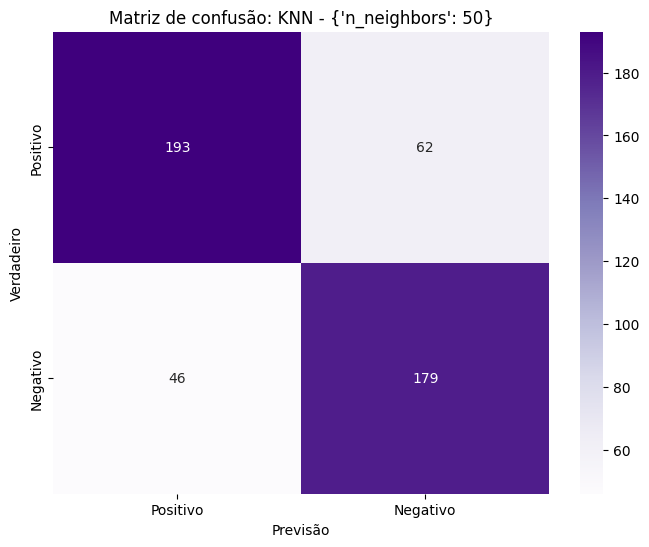



Configuração utilizada: {'n_neighbors': 100}
Precisão: 0.7846
Revocação: 0.8578
F1: 0.8195
Acurácia: 0.8229


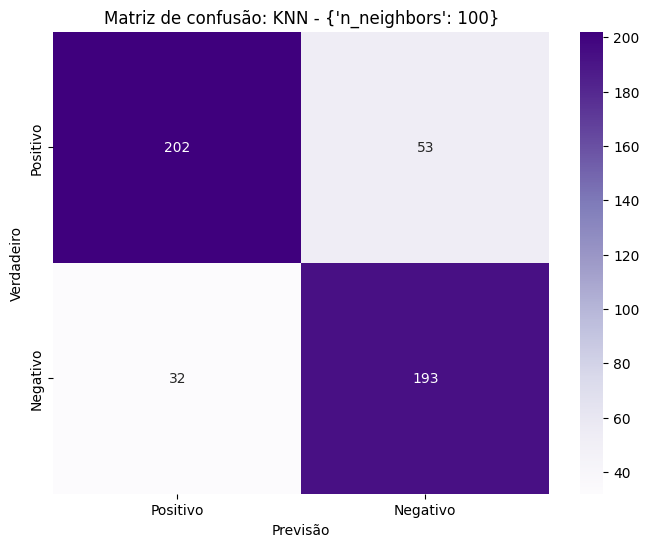



Configuração utilizada: {'n_neighbors': 900}
Precisão: 0.8586
Revocação: 0.3778
F1: 0.5247
Acurácia: 0.6792


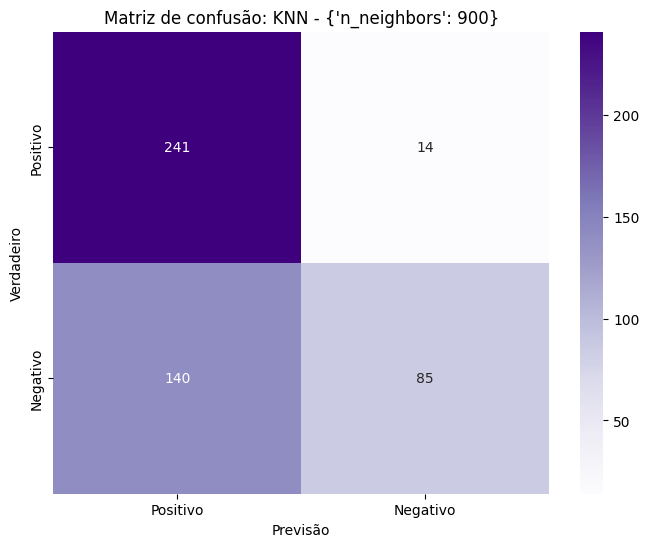



Configuração utilizada: {'n_neighbors': 1500}
Precisão: 0.9091
Revocação: 0.2667
F1: 0.4124
Acurácia: 0.6438


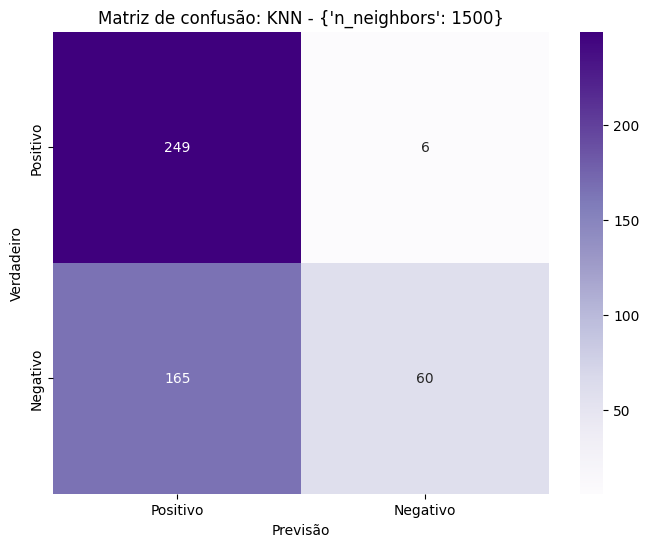

In [ ]:
# Extrair os valores do DataFrame e armazená-los na variável 'dados'
dados = df_prever_normalized.drop(columns=['popularity_binary']).values  # Exclua a coluna de alvo

# Extrair classes alvo do conjunto de dados
alvo = df_prever_normalized['popularity_binary'].values

# Definir diferentes valores de vizinhos (k), 7 números de vizinhos diferentes
KNN_configuracoes = [
    {'n_neighbors': best_k},
    {'n_neighbors': 5},
    {'n_neighbors': 10},
    {'n_neighbors': 20},
    {'n_neighbors': 50},
    {'n_neighbors': 100},
    {'n_neighbors': 900},
    {'n_neighbors': 1500}
]

validacao_cruzada = StratifiedKFold(n_splits=5, shuffle=True)

# Lista para armazenar os resultados de cada configuração
KNN_resposta = []

# Loop para iterar sobre cada configuração de parâmetros
for conf in KNN_configuracoes:
    # Criar o modelo KNeighborsClassifier com os parâmetros da configuração atual
    model = KNeighborsClassifier(n_neighbors=conf['n_neighbors'])

    # Avaliar o modelo utilizando a função 'avaliar_configuracao' e obter as métricas de desempenho
    precision, recall, f1, acuracia, conf_matrix = avaliar_configuracao(model, dados, alvo, validacao_cruzada)

    # Armazenar os resultados da configuração atual em um dicionário e adicionar à lista de respostas
    KNN_resposta.append({
        'config': conf,
        'precision': precision,
        'recall': recall,
        'f1': f1,
        'acuracia': acuracia,
        'confusion_matrix': conf_matrix
    })

    # Exibir os resultados para a configuração atual
    print(f"Configuração utilizada: {conf}")
    print(f"Precisão: {precision:.4f}")
    print(f"Revocação: {recall:.4f}")
    print(f"F1: {f1:.4f}")
    print(f"Acurácia: {acuracia:.4f}")

    # Criar uma nova figura para a matriz de confusão
    plt.figure(figsize=(8, 6))
    # Plotar a matriz de confusão usando seaborn com a paleta de cores 'Purples'
    sns.heatmap(conf_matrix, annot=True, fmt='d', cmap='Purples', xticklabels=['Positivo', 'Negativo'], yticklabels=['Positivo', 'Negativo'])
    # Definir o rótulo do eixo X
    plt.xlabel('Previsão')
    # Definir o rótulo do eixo Y
    plt.ylabel('Verdadeiro')
    # Definir o título do gráfico
    plt.title(f"Matriz de confusão: KNN - {conf}")
    # Mostrar o gráfico
    plt.show()

    print("\n")

A melhor configuração definida por "best_k" apresenta o melhor equilíbrio entre precisão, revocação, F1 e acurácia. A precisão e a revocação são boas, o que resulta em um F1 score alto, indicando que o modelo está equilibrando bem a capacidade de identificar positivos reais e evitar falsos positivos. A acurácia também é a mais alta, mostrando que o modelo tem um bom desempenho geral.

De maneira generalizada, as configurações com um número muito baixo de vizinhos (5, 10) podem ser mais sensíveis a variações e ruídos nos dados, enquanto as configurações com um número muito alto de vizinhos (900, 1500) tendem a ignorar muitos positivos reais e, portanto, não são tão eficazes.

##### **Naive Bayes**

Precisão: 0.8945
Revocação: 0.9422
F1: 0.9177
Acurácia: 0.9208


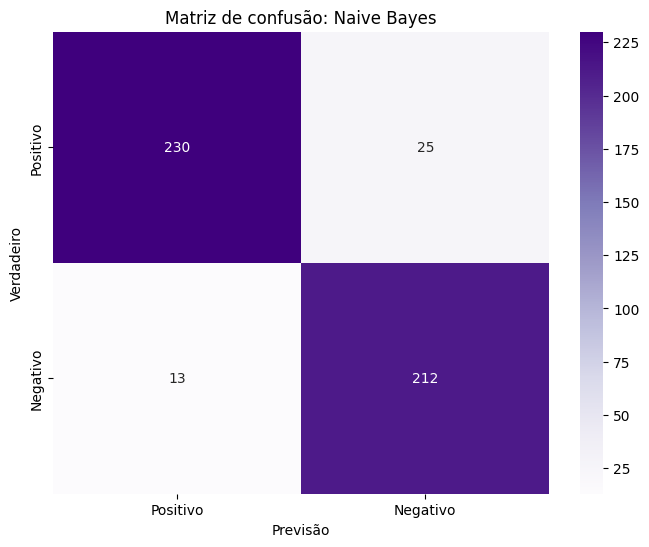

In [ ]:
from sklearn.naive_bayes import GaussianNB

# Configuração do modelo Naive Bayes
model_nb = GaussianNB()

# Avaliar o modelo Naive Bayes utilizando a função 'avaliar_configuracao'
precision_nb, recall_nb, f1_nb, acuracia_nb, conf_matrix_nb = avaliar_configuracao(model_nb, dados, alvo, validacao_cruzada)

# Exibir os resultados do Naive Bayes
print(f"Precisão: {precision_nb:.4f}")
print(f"Revocação: {recall_nb:.4f}")
print(f"F1: {f1_nb:.4f}")
print(f"Acurácia: {acuracia_nb:.4f}")

# Criar uma nova figura para a matriz de confusão
plt.figure(figsize=(8, 6))
# Plotar a matriz de confusão usando seaborn com a paleta de cores 'Purples'
sns.heatmap(conf_matrix_nb, annot=True, fmt='d', cmap='Purples', xticklabels=['Positivo', 'Negativo'], yticklabels=['Positivo', 'Negativo'])
# Definir o rótulo do eixo X
plt.xlabel('Previsão')
# Definir o rótulo do eixo Y
plt.ylabel('Verdadeiro')
# Definir o título do gráfico
plt.title("Matriz de confusão: Naive Bayes")
# Mostrar o gráfico
plt.show()

Esses valores gerados indicam um bom desempenho do modelo Naive Bayes. A precisão de alta mostra que o modelo tem uma taxa alta de classificações corretas entre as positivas, enquanto a revocação de alta indica que o modelo consegue identificar a maioria das instâncias positivas. O F1 score próximo a 1 demonstra o equilibrio entre precisão e revocação. A acurácia de alta reflete a proporção geral de previsões corretas.

##### **Comparação**

Vamos comparar os valores de Acurácia, Precisão, Revocação e F1-Score para o modelo de KNN com a melhor configuração de vizinhos, com o modelo do Naive Bayes.

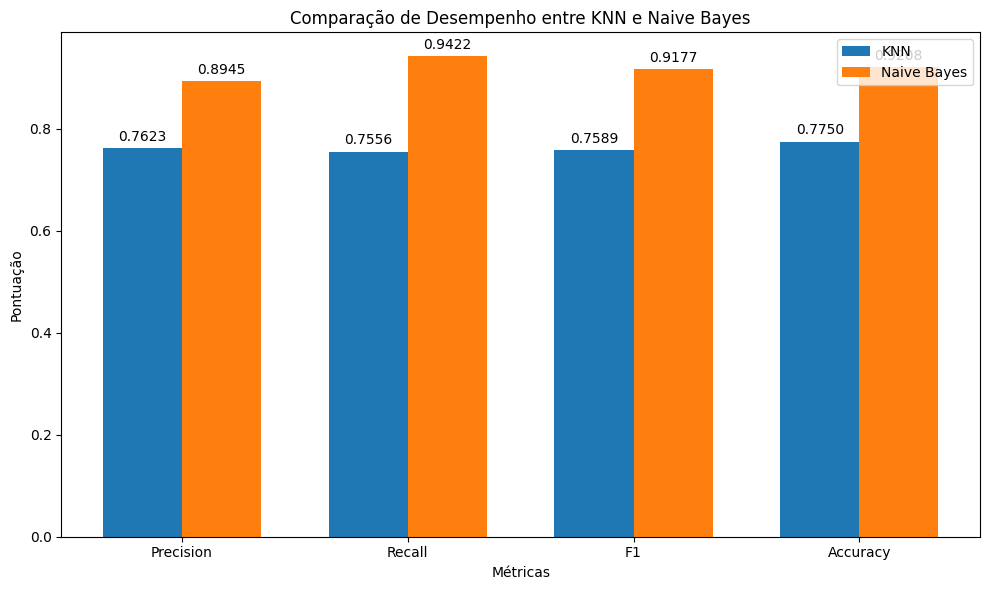

In [ ]:
# Resultados do KNN
resultados_knn = {
    'Precision': KNN_resposta[0]['precision'],
    'Recall': KNN_resposta[0]['recall'],
    'F1': KNN_resposta[0]['f1'],
    'Accuracy': KNN_resposta[0]['acuracia']
}

# Resultados do Naive Bayes
resultados_nb = {
    'Precision': precision_nb,
    'Recall': recall_nb,
    'F1': f1_nb,
    'Accuracy': acuracia_nb
}

# Definir as métricas
metricas = list(resultados_knn.keys())
valores_knn = list(resultados_knn.values())
valores_nb = list(resultados_nb.values())

# Configurar o gráfico
x = np.arange(len(metricas))  # Localização das barras
largura = 0.35  # Largura das barras

fig, ax = plt.subplots(figsize=(10, 6))

# Criar as barras para KNN e Naive Bayes
barras_knn = ax.bar(x - largura/2, valores_knn, largura, label='KNN')
barras_nb = ax.bar(x + largura/2, valores_nb, largura, label='Naive Bayes')

# Adicionar texto aos gráficos
ax.set_xlabel('Métricas')
ax.set_ylabel('Pontuação')
ax.set_title('Comparação de Desempenho entre KNN e Naive Bayes')
ax.set_xticks(x)
ax.set_xticklabels(metricas)
ax.legend()

# Adicionar rótulos das barras
def adicionar_rótulos(barras):
    for barra in barras:
        altura = barra.get_height()
        ax.annotate(f'{altura:.4f}',
                    xy=(barra.get_x() + barra.get_width() / 2, altura),
                    xytext=(0, 3),  # 3 pontos verticais para o texto
                    textcoords="offset points",
                    ha='center', va='bottom')

adicionar_rótulos(barras_knn)
adicionar_rótulos(barras_nb)

plt.tight_layout()
plt.show()

Ao final, o modelo Naive Bayes se mostrou melhor do que o modelo KNN. Isso pode ter acontecido devido a quantidade de dados do banco de dados não ser tão grande, além de evidencia que a maioria das características (features) são realmente independentes entre si, como visto na matriz de correlação (secção 5).

### 7.2 Prever "artist_popularity":

**artist_popularity**: Classificação de popularidade do cantor no SPOTIFY, sendo 0 o mais baixo e 100 o mais alto

##### Normalizando os dados e definindo intervalos de Classes

In [ ]:
df_prever  = df_playlist_2000to2023[['track_popularity',
            'artist_popularity', 'danceability', 'energy',
            'mode', 'acousticness', 'liveness', 'loudness',
            'speechiness', 'instrumentalness', 'valence', 'tempo']].copy()
df_prever.head()

,track_popularity,artist_popularity,danceability,energy,mode,acousticness,liveness,loudness,speechiness,instrumentalness,valence,tempo
0,81,81,0.751,0.834,0,0.3000,0.3550,-5.444,0.0437,0.000018,0.894,95.053
1,83,79,0.434,0.897,1,0.0103,0.6120,-4.918,0.0488,0.000000,0.684,148.726
2,66,62,0.529,0.496,1,0.1730,0.2510,-9.007,0.0290,0.000000,0.278,136.859
3,81,79,0.551,0.913,0,0.0263,0.3470,-4.063,0.0466,0.000013,0.544,119.992
4,75,70,0.610,0.926,0,0.0310,0.0821,-4.843,0.0479,0.001200,0.861,172.638


Normalização dos dados:

In [ ]:
from sklearn.preprocessing import MinMaxScaler

# Criar o MinMaxScaler
scaler = MinMaxScaler()

# Aplicar o scaler a todas as colunas de df_prever
df_prever_normalized = pd.DataFrame(scaler.fit_transform(df_prever), columns=df_prever.columns)

# Visualizar as primeiras linhas do DataFrame normalizado
print(df_prever_normalized.head())

   track_popularity  artist_popularity  danceability    energy  mode  \
0          0.843750           0.703125      0.724477  0.825784   0.0   
1          0.864583           0.671875      0.334563  0.892303   1.0   
2          0.687500           0.406250      0.451415  0.468905   1.0   
3          0.843750           0.671875      0.478475  0.909196   0.0   
4          0.781250           0.531250      0.551046  0.922923   0.0   

   acousticness  liveness  loudness  speechiness  instrumentalness   valence  \
0      0.306739  0.348643  0.751908     0.038302          0.000018  0.914557   
1      0.010519  0.616910  0.777159     0.047516          0.000000  0.690270   
2      0.176881  0.240084  0.580865     0.011743          0.000000  0.256649   
3      0.026879  0.340292  0.818204     0.043541          0.000014  0.540745   
4      0.031685  0.063779  0.780759     0.045890          0.001218  0.879312   

      tempo  
0  0.232262  
1  0.588095  
2  0.509421  
3  0.397599  
4  0.746622  


Verificar com ".describe()" qual o valor que separa os dados em 50%:

In [ ]:
# Verificar faixa de valores de "artist_popularity"
estatisticas = df_prever_normalized['artist_popularity'].describe()
print(estatisticas)

count    2400.000000
mean        0.623164
std         0.187762
min         0.000000
25%         0.500000
50%         0.640625
75%         0.765625
max         1.000000
Name: artist_popularity, dtype: float64


Vamos definir os intervalos para cada classe:

Classe 1: Representa músicas com "artist_popularity" maior que 0.64.

Classe 0: Representa músicas com "artist_popularity" menor ou igual a 0.64.

In [ ]:
# Adiciona a coluna 'popularity_binary' com valores binários baseados na popularidade da música
df_prever_normalized['artist_popularity_binary'] = df_prever_normalized['artist_popularity'].apply(lambda x: 1 if x > 0.64 else 0)

# Visualizando as primeiras linhas para verificar a nova coluna
print(df_prever_normalized[['artist_popularity', 'artist_popularity_binary']].head())

   artist_popularity  artist_popularity_binary
0           0.703125                         1
1           0.671875                         1
2           0.406250                         0
3           0.671875                         1
4           0.531250                         0


Verificar a distribuição das classes:

In [ ]:
print(df_prever_normalized['artist_popularity_binary'].value_counts())

artist_popularity_binary
1    1262
0    1138
Name: count, dtype: int64


A distribuição das classes na coluna popularity_class é:

Classe 1: 1262 instâncias

Classe 0: 1138 instâncias

##### Encontrar melhor valor de K

O algoritmo abaixo é utilizado para encontrar o melhor valor de k em um modelo de regressão K-Nearest Neighbors (KNN).

obs: o código abaixo demora por volta de 1min pra rodar visto que "neighbors_range" vai de 1 até 200.

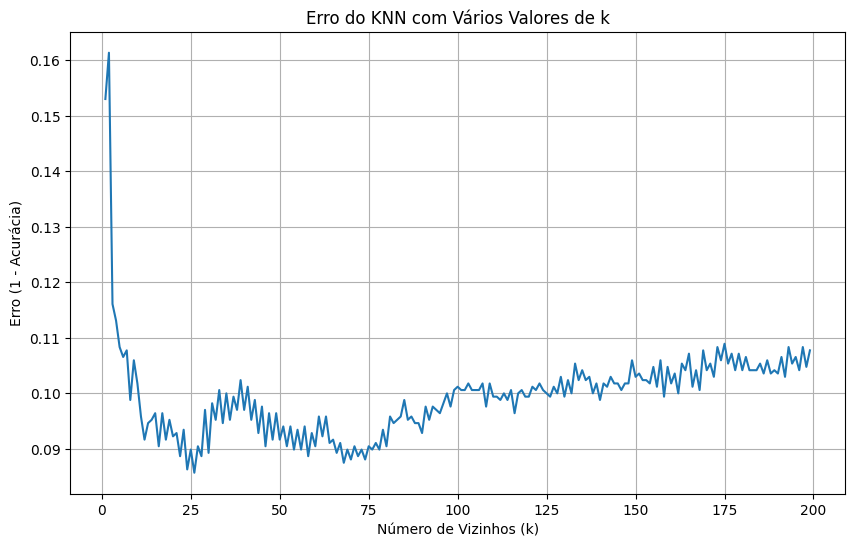

O melhor número de vizinhos é: 26
Erro correspondente: 0.08571428571428574


In [ ]:
# Extrair os valores do DataFrame e armazená-los na variável 'dados'
X = df_prever_normalized.drop(columns=['artist_popularity_binary']).values
y = df_prever_normalized['artist_popularity_binary'].values

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)

scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

neighbors_range = range(1, 200)
cv_scores = []

# Definir o número de folds para validação cruzada
kf = KFold(n_splits=10, shuffle=True, random_state=42)

# Avaliar o desempenho para cada valor de n_neighbors
for k in neighbors_range:
    knn = KNeighborsClassifier(n_neighbors=k)
    scores = cross_val_score(knn, X_train_scaled, y_train, cv=kf, scoring='accuracy')
    cv_scores.append(1 - np.mean(scores))  # Calcular o erro como 1 - acurácia média

plt.figure(figsize=(10, 6))
plt.plot(neighbors_range, cv_scores)
plt.xlabel('Número de Vizinhos (k)')
plt.ylabel('Erro (1 - Acurácia)')
plt.title('Erro do KNN com Vários Valores de k')
plt.grid(True)
plt.show()

# Encontrar o melhor número de vizinhos
best_k = neighbors_range[np.argmin(cv_scores)]
best_error = np.min(cv_scores)

# Imprimir o melhor número de vizinhos e o erro correspondente
print(f'O melhor número de vizinhos é: {best_k}')
print(f'Erro correspondente: {best_error}')

##### **KNN**

Executando o KNN:

Configuração utilizada: {'n_neighbors': 26}
Precisão: 0.9170
Revocação: 0.9643
F1: 0.9400
Acurácia: 0.9354


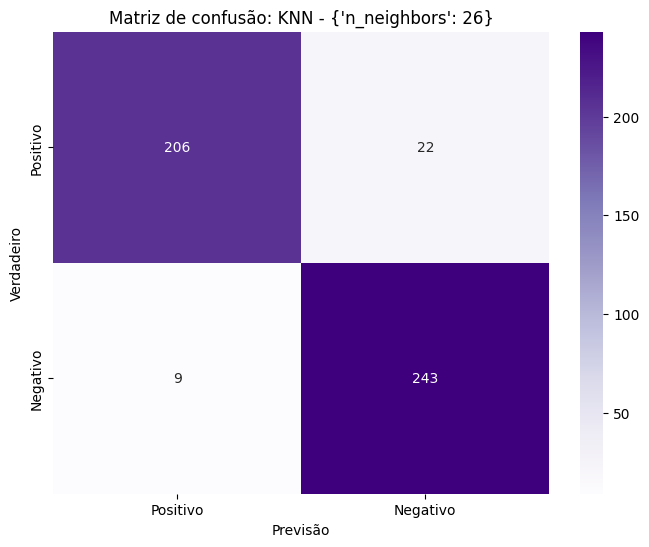



Configuração utilizada: {'n_neighbors': 5}
Precisão: 0.8625
Revocação: 0.9206
F1: 0.8906
Acurácia: 0.8812


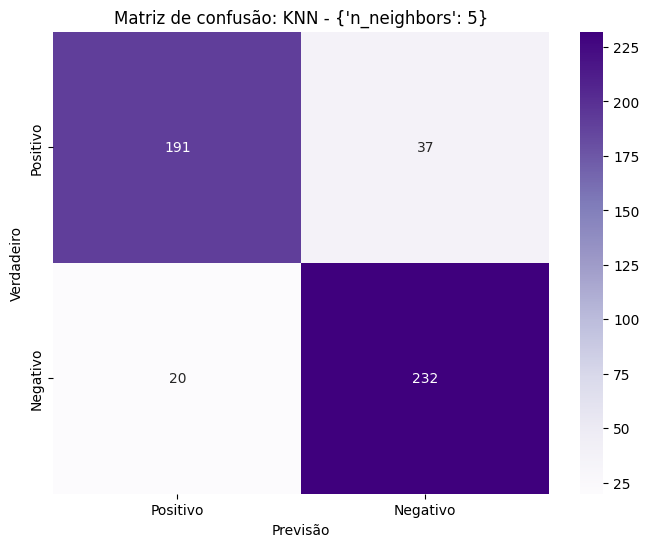



Configuração utilizada: {'n_neighbors': 10}
Precisão: 0.9213
Revocação: 0.9286
F1: 0.9249
Acurácia: 0.9208


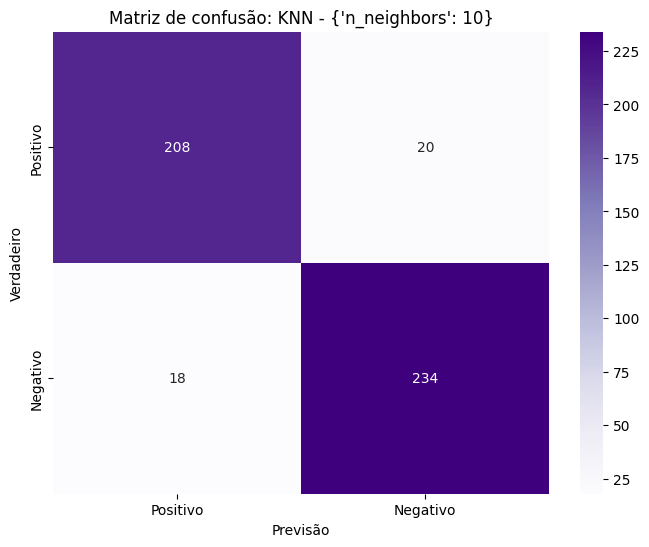



Configuração utilizada: {'n_neighbors': 20}
Precisão: 0.8788
Revocação: 0.9206
F1: 0.8992
Acurácia: 0.8917


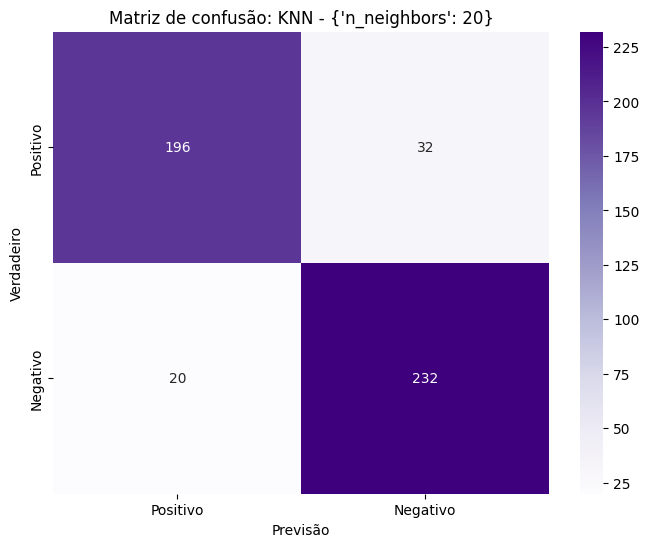



Configuração utilizada: {'n_neighbors': 50}
Precisão: 0.8985
Revocação: 0.9484
F1: 0.9228
Acurácia: 0.9167


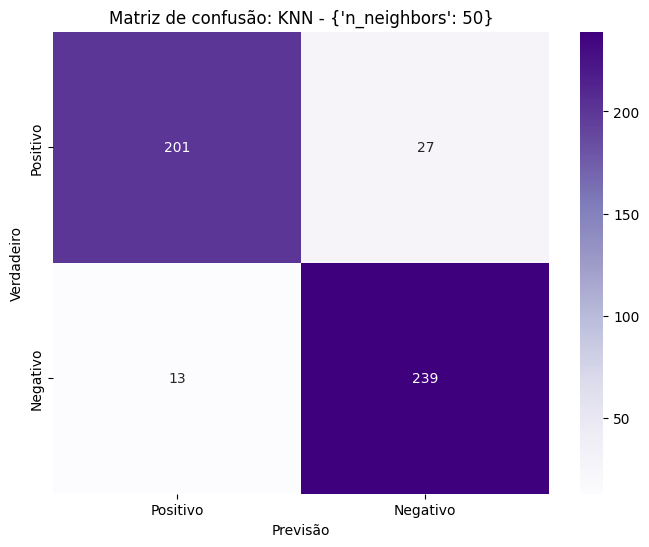



Configuração utilizada: {'n_neighbors': 100}
Precisão: 0.9151
Revocação: 0.9841
F1: 0.9484
Acurácia: 0.9437


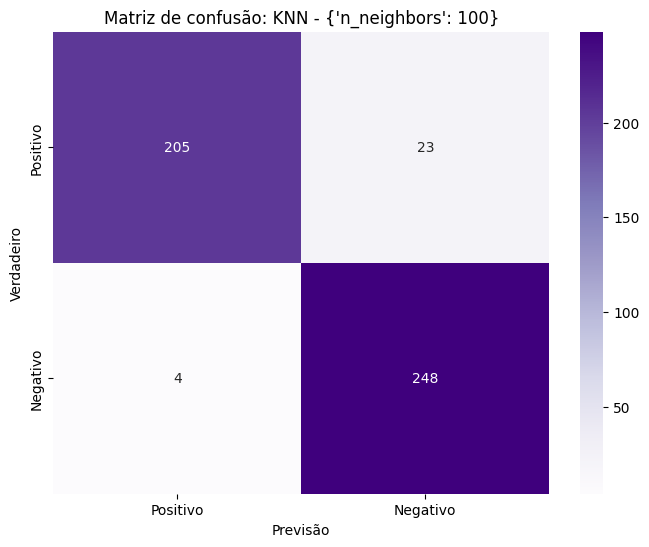



Configuração utilizada: {'n_neighbors': 900}
Precisão: 0.7289
Revocação: 0.9921
F1: 0.8403
Acurácia: 0.8021


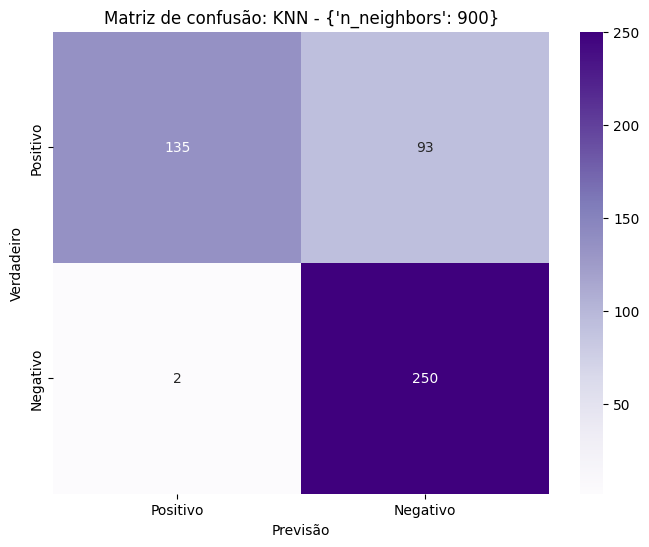



Configuração utilizada: {'n_neighbors': 1500}
Precisão: 0.6596
Revocação: 0.9921
F1: 0.7924
Acurácia: 0.7271


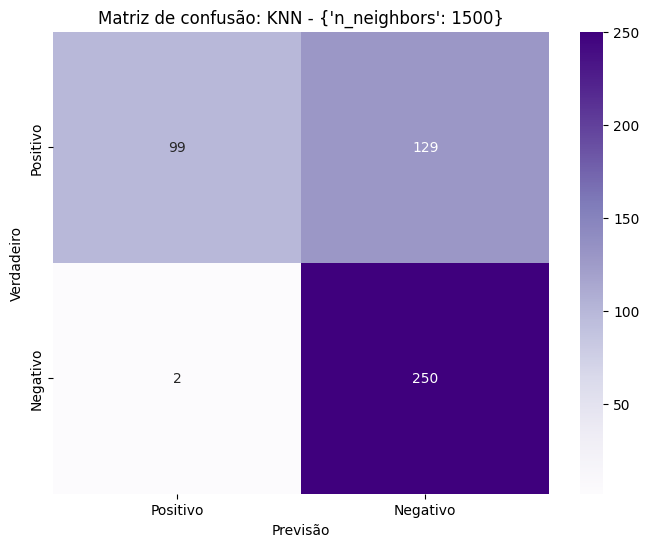

In [ ]:
# Extrair os valores do DataFrame e armazená-los na variável 'dados'
dados = df_prever_normalized.drop(columns=['artist_popularity_binary']).values  # Exclua a coluna de alvo

# Extrair classes alvo do conjunto de dados
alvo = df_prever_normalized['artist_popularity_binary'].values

# Definir diferentes valores de vizinhos (k), 3 números de vizinhos diferentes
KNN_configuracoes = [
    {'n_neighbors': best_k},
    {'n_neighbors': 5},
    {'n_neighbors': 10},
    {'n_neighbors': 20},
    {'n_neighbors': 50},
    {'n_neighbors': 100},
    {'n_neighbors': 900},
    {'n_neighbors': 1500}
]

validacao_cruzada = StratifiedKFold(n_splits=5, shuffle=True)

# Lista para armazenar os resultados de cada configuração
KNN_resposta = []

# Loop para iterar sobre cada configuração de parâmetros
for conf in KNN_configuracoes:
    # Criar o modelo KNeighborsClassifier com os parâmetros da configuração atual
    model = KNeighborsClassifier(n_neighbors=conf['n_neighbors'])

    # Avaliar o modelo utilizando a função 'avaliar_configuracao' e obter as métricas de desempenho
    precision, recall, f1, acuracia, conf_matrix = avaliar_configuracao(model, dados, alvo, validacao_cruzada)

    # Armazenar os resultados da configuração atual em um dicionário e adicionar à lista de respostas
    KNN_resposta.append({
        'config': conf,
        'precision': precision,
        'recall': recall,
        'f1': f1,
        'acuracia': acuracia,
        'confusion_matrix': conf_matrix
    })

    # Exibir os resultados para a configuração atual
    print(f"Configuração utilizada: {conf}")
    print(f"Precisão: {precision:.4f}")
    print(f"Revocação: {recall:.4f}")
    print(f"F1: {f1:.4f}")
    print(f"Acurácia: {acuracia:.4f}")

    # Criar uma nova figura para a matriz de confusão
    plt.figure(figsize=(8, 6))
    # Plotar a matriz de confusão usando seaborn com a paleta de cores 'Purples'
    sns.heatmap(conf_matrix, annot=True, fmt='d', cmap='Purples', xticklabels=['Positivo', 'Negativo'], yticklabels=['Positivo', 'Negativo'])
    # Definir o rótulo do eixo X
    plt.xlabel('Previsão')
    # Definir o rótulo do eixo Y
    plt.ylabel('Verdadeiro')
    # Definir o título do gráfico
    plt.title(f"Matriz de confusão: KNN - {conf}")
    # Mostrar o gráfico
    plt.show()

    print("\n")

A melhor configuração definida por "best_k" apresenta o melhor equilíbrio entre precisão, revocação, F1 e acurácia.

De maneira generalizada, as configurações com um número muito baixo de vizinhos (5, 10, 20, 50) ficaram melhores que as configurações com número muito alto de vizinhos (100, 900, 1500).

##### **Naive Bayes**

Precisão: 0.9222
Revocação: 0.9881
F1: 0.9540
Acurácia: 0.9500


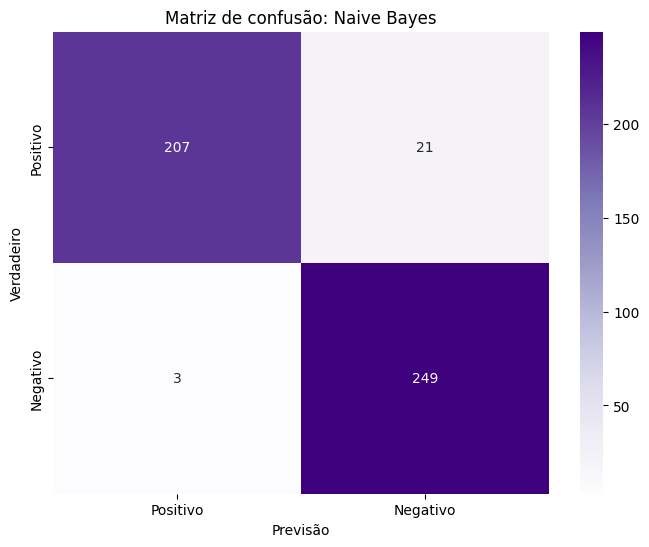

In [ ]:
from sklearn.naive_bayes import GaussianNB

# Configuração do modelo Naive Bayes
model_nb = GaussianNB()

# Avaliar o modelo Naive Bayes utilizando a função 'avaliar_configuracao'
precision_nb, recall_nb, f1_nb, acuracia_nb, conf_matrix_nb = avaliar_configuracao(model_nb, dados, alvo, validacao_cruzada)

# Exibir os resultados do Naive Bayes
print(f"Precisão: {precision_nb:.4f}")
print(f"Revocação: {recall_nb:.4f}")
print(f"F1: {f1_nb:.4f}")
print(f"Acurácia: {acuracia_nb:.4f}")

# Criar uma nova figura para a matriz de confusão
plt.figure(figsize=(8, 6))
# Plotar a matriz de confusão usando seaborn com a paleta de cores 'Purples'
sns.heatmap(conf_matrix_nb, annot=True, fmt='d', cmap='Purples', xticklabels=['Positivo', 'Negativo'], yticklabels=['Positivo', 'Negativo'])
# Definir o rótulo do eixo X
plt.xlabel('Previsão')
# Definir o rótulo do eixo Y
plt.ylabel('Verdadeiro')
# Definir o título do gráfico
plt.title("Matriz de confusão: Naive Bayes")
# Mostrar o gráfico
plt.show()

Esses valores gerados indicam um bom desempenho do modelo Naive Bayes. A precisão, revocação, F1 score, acurácia estão altas.
Os resultados ficaram mais próximos a execução do KNN com um número de vizinhos baixo (exemplo: 50).

##### **Comparação**

Vamos comparar os valores de Acurácia, Precisão, Revocação e F1-Score para o modelo de KNN com a melhor configuração de vizinhos, com o modelo do Naive Bayes.

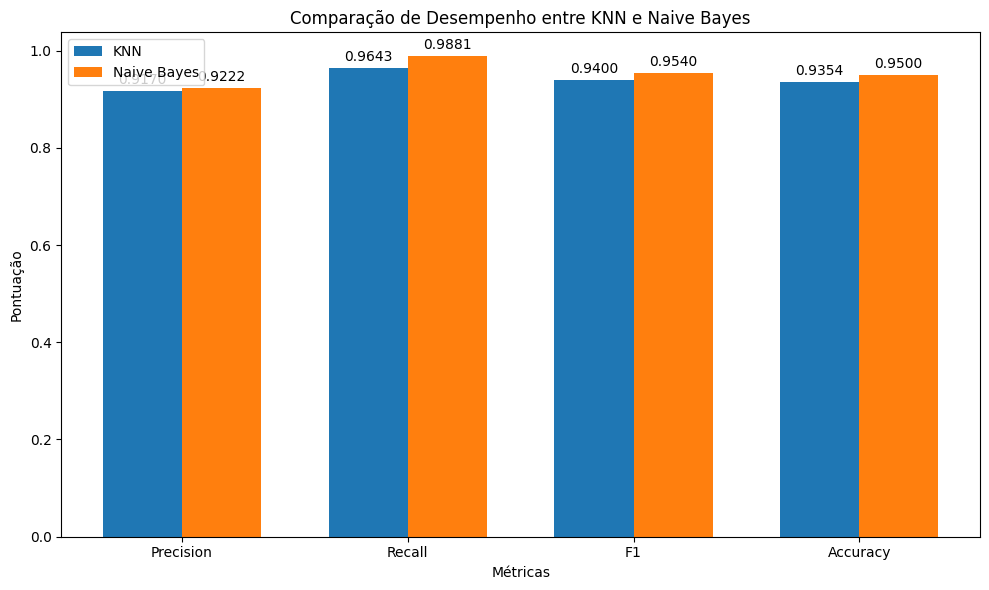

In [ ]:
# Resultados do KNN
resultados_knn = {
    'Precision': KNN_resposta[0]['precision'],
    'Recall': KNN_resposta[0]['recall'],
    'F1': KNN_resposta[0]['f1'],
    'Accuracy': KNN_resposta[0]['acuracia']
}

# Resultados do Naive Bayes
resultados_nb = {
    'Precision': precision_nb,
    'Recall': recall_nb,
    'F1': f1_nb,
    'Accuracy': acuracia_nb
}

# Definir as métricas
metricas = list(resultados_knn.keys())
valores_knn = list(resultados_knn.values())
valores_nb = list(resultados_nb.values())

# Configurar o gráfico
x = np.arange(len(metricas))  # Localização das barras
largura = 0.35  # Largura das barras

fig, ax = plt.subplots(figsize=(10, 6))

# Criar as barras para KNN e Naive Bayes
barras_knn = ax.bar(x - largura/2, valores_knn, largura, label='KNN')
barras_nb = ax.bar(x + largura/2, valores_nb, largura, label='Naive Bayes')

# Adicionar texto aos gráficos
ax.set_xlabel('Métricas')
ax.set_ylabel('Pontuação')
ax.set_title('Comparação de Desempenho entre KNN e Naive Bayes')
ax.set_xticks(x)
ax.set_xticklabels(metricas)
ax.legend()

# Adicionar rótulos das barras
def adicionar_rótulos(barras):
    for barra in barras:
        altura = barra.get_height()
        ax.annotate(f'{altura:.4f}',
                    xy=(barra.get_x() + barra.get_width() / 2, altura),
                    xytext=(0, 3),  # 3 pontos verticais para o texto
                    textcoords="offset points",
                    ha='center', va='bottom')

adicionar_rótulos(barras_knn)
adicionar_rótulos(barras_nb)

plt.tight_layout()
plt.show()

Ao final, o modelo Naive Bayes e o modelo KNN com o melhor valor de vizinhos ficaram bem próximos.

Ambos os modelos estão performando de maneira semelhante em termos de suas métricas de avaliação. Isso pode significar que, para o problema específico e os dados em questão, tanto KNN quanto Naive Bayes estão capturando as características importantes de maneira eficaz.

Se ambos têm desempenhos semelhantes, isso pode sugerir também que a complexidade adicional do KNN não está trazendo benefícios significativos para este problema específico.

### 7.3. Transformar coluna Gênero para binário

O objetivo dessa parte foi converter a coluna de gêneros que pode ter múltiplos valores em uma representação que pode ser facilmente utilizada por algoritmos de aprendizado de máquina. A transformação em colunas binárias é uma maneira de representar dados categóricos numericamente.

Após essa transformação executamos o algoritmo de KNN para verificar o quanto melhor fica seu resultado visto as informações adicionais da coluna gênero. Assim, fizemos novamente o KNN para prever "track_popularity" considerando agora os gêneros.

#### 7.3.1 Cada gênero se torna uma coluna binária

Obter todos os gêneros únicos do banco de dados:

In [ ]:
# Garantir que a coluna 'artist_genres' seja uma lista de gêneros
df_playlist_2000to2023['artist_genres'] = df_playlist_2000to2023['artist_genres'].apply(lambda x: x.split(", ") if isinstance(x, str) else x)

# Agora, extraímos todos os gêneros em uma lista única
all_genres = df_playlist_2000to2023['artist_genres'].explode()

# Obter os gêneros únicos usando set
unique_genres = set(all_genres)

# Exibir os gêneros únicos
print(f"Total de gêneros únicos: {len(unique_genres)}")
print(unique_genres)


Total de gêneros únicos: 708
{"'sertanejo universitario']", "'r&drill']", "['pop'", "'french rock']", "'plugg'", "['corrido'", "'afrobeats']", "['pop']", "'hip house'", "['dance-punk'", "'industrial rock'", "['bouncy house'", "'corridos tumbados'", "'melodic rap'", "'schlager']", "['gangster rap'", "'ukg revival']", "['filmi']", "'r&b']", "['indie rock italiano'", "'pop']", "['reggaeton'", "['bedroom pop']", "'pixie'", "'christian alternative rock'", "'metropopolis']", "'r&b'", "'ectofolk'", "['mambo chileno'", "['english indie rock']", "'rock independant francais'", "'la indie'", "['icelandic indie'", "'minneapolis sound'", "'christian rock']", "['dutch house'", "'country rap']", "['australian dance'", "'piano rock'", "'k-pop boy group'", "'pov: indie']", "['pop dance'", "'neo soul']", "'melbourne bounce international']", "['emo rap'", "'political hip hop']", "['contemporary country']", "['electro'", "'oktoberfest'", "['rock-and-roll'", "['ccm'", "'stomp and holler'", "['chicago drill

Adicionar uma coluna com valor binário (1 se possui aquele gênero, 0 se não possui) para cada gênero único:

In [ ]:
# Exemplo de DataFrame
df_genero = df_playlist_2000to2023.copy()

# Primeiro, vamos garantir que a coluna 'artist_genres' é uma lista de strings
# Se for uma string única com gêneros separados por vírgula, precisamos converter para lista
df_genero['artist_genres'] = df_genero['artist_genres'].apply(lambda x: x.split(", ") if isinstance(x, str) else x)

# Filtrando linhas onde a coluna 'artist_genres' não está vazia
df_genero = df_genero[df_genero['artist_genres'].str.len() > 0]

# Em seguida, aplicamos o método 'str.get_dummies()' na coluna 'artist_genres'
# Isso vai criar colunas binárias para cada gênero
genres_encoded = df_genero['artist_genres'].str.join('|').str.get_dummies()

# Agora, concatenamos as colunas de gêneros binários com o DataFrame original
df_genero = pd.concat([df_genero, genres_encoded], axis=1)

# Visualizando as primeiras linhas do DataFrame resultante
print(df_genero.head())

                                        playlist_url  year  \
0  https://open.spotify.com/playlist/37i9dQZF1DWU...  2000   
1  https://open.spotify.com/playlist/37i9dQZF1DWU...  2000   
2  https://open.spotify.com/playlist/37i9dQZF1DWU...  2000   
3  https://open.spotify.com/playlist/37i9dQZF1DWU...  2000   
4  https://open.spotify.com/playlist/37i9dQZF1DWU...  2000   

                 track_id              track_name  track_popularity  \
0  6naxalmIoLFWR0siv8dnQQ  Oops!...I Did It Again                81   
1  2m1hi0nfMR9vdGC8UcrnwU    All The Small Things                83   
2  3y4LxiYMgDl4RethdzpmNe                 Breathe                66   
3  0v1XpBHnsbkCn7iJ9Ucr1l            It's My Life                81   
4  62bOmKYxYg7dhrC6gH9vFn             Bye Bye Bye                75   

                     album               artist_id     artist_name  \
0  Oops!... I Did It Again  26dSoYclwsYLMAKD3tpOr4  Britney Spears   
1       Enema Of The State  6FBDaR13swtiWwGhX1WQsP       bli

Vamos verificar se essas colunas criadas possuem as mesmas informações da coluna única Gênero usada anteriormente:

Utilizando dataframe com uma coluna para cada gênero:

In [ ]:
# Filtrar o DataFrame para a música específica
musica_especifica = df_genero[df_genero['track_name'] == 'All The Small Things']

# Verificar todos os gêneros para essa música
generos = musica_especifica['artist_genres'].tolist()

# Caso tenha mais de uma linha (múltiplas entradas para a mesma música), você pode visualizar todos os gêneros
# Caso contrário, apenas visualizamos o primeiro gênero listado
if len(generos) > 0:
    # Se houver múltiplos gêneros, você pode querer ver todos os valores únicos
    generos_unicos = set(g for sublist in generos for g in (sublist if isinstance(sublist, list) else [sublist]))
    print("Gêneros para 'All The Small Things':", generos_unicos)
else:
    print("Música 'All The Small Things' não encontrada no DataFrame.")


Gêneros para 'All The Small Things': {"['alternative metal'", "'socal pop punk']", "'pop punk'", "'punk'", "'rock'", "'modern rock'"}


Utilizando dataframe original com apenas um colunas para gênero:

In [ ]:
# Filtrar o DataFrame para a música específica
musica_especifica = df_playlist_2000to2023[df_playlist_2000to2023['track_name'] == 'All The Small Things']

# Verificar se a música foi encontrada
if not musica_especifica.empty:
    # Extrair a lista de gêneros
    generos = musica_especifica['artist_genres'].values[0]
    print(f"Gêneros para 'All The Small Things': {generos}")
else:
    print("Música 'All The Small Things' não encontrada no DataFrame.")

Gêneros para 'All The Small Things': ["['alternative metal'", "'modern rock'", "'pop punk'", "'punk'", "'rock'", "'socal pop punk']"]


##### KNN

Vamos testar executar o algorimto KNN com base nesse dataframe com várias colunas para gênero:

Retirando as colunas menos significativas para o KNN:

In [ ]:
df_prever  = df_genero.copy()
df_knn = df_prever.drop(columns=['artist_genres', 'mode', 'playlist_url',
                        'year', 'track_id', 'album', 'artist_id', 'track_name',
                        'artist_name', 'key', 'tempo','duration_ms',
                        'time_signature',], axis=1)
df_knn.head()

,track_popularity,artist_popularity,danceability,energy,loudness,speechiness,acousticness,instrumentalness,liveness,valence,...,['trap queen'],['uk contemporary r&b',['uk contemporary r&b'],['uk garage'],['uk hip hop'],['uk pop'],['viral pop'],['viral rap'],['vocal house'],[]
0,81,81,0.751,0.834,-5.444,0.0437,0.3000,0.000018,0.3550,0.894,...,0,0,0,0,0,0,0,0,0,0
1,83,79,0.434,0.897,-4.918,0.0488,0.0103,0.000000,0.6120,0.684,...,0,0,0,0,0,0,0,0,0,0
2,66,62,0.529,0.496,-9.007,0.0290,0.1730,0.000000,0.2510,0.278,...,0,0,0,0,0,0,0,0,0,0
3,81,79,0.551,0.913,-4.063,0.0466,0.0263,0.000013,0.3470,0.544,...,0,0,0,0,0,0,0,0,0,0
4,75,70,0.610,0.926,-4.843,0.0479,0.0310,0.001200,0.0821,0.861,...,0,0,0,0,0,0,0,0,0,0


Verificando tipos dos dados:

In [ ]:
print(df_knn.dtypes)

track_popularity       int64
artist_popularity      int64
danceability         float64
energy               float64
loudness             float64
                      ...   
['uk pop']             int64
['viral pop']          int64
['viral rap']          int64
['vocal house']        int64
[]                     int64
Length: 718, dtype: object


Normalização dos dados:

In [ ]:
# Criar o MinMaxScaler
scaler = MinMaxScaler()

# Aplicar o scaler a todas as colunas de df_knn
df_knn_normalized = pd.DataFrame(scaler.fit_transform(df_knn), columns=df_knn.columns)

# Visualizar as primeiras linhas do DataFrame normalizado
print(df_knn_normalized.head())

   track_popularity  artist_popularity  danceability    energy  loudness  \
0          0.843750           0.703125      0.724477  0.825784  0.751908   
1          0.864583           0.671875      0.334563  0.892303  0.777159   
2          0.687500           0.406250      0.451415  0.468905  0.580865   
3          0.843750           0.671875      0.478475  0.909196  0.818204   
4          0.781250           0.531250      0.551046  0.922923  0.780759   

   speechiness  acousticness  instrumentalness  liveness   valence  ...  \
0     0.038302      0.306739          0.000018  0.348643  0.914557  ...   
1     0.047516      0.010519          0.000000  0.616910  0.690270  ...   
2     0.011743      0.176881          0.000000  0.240084  0.256649  ...   
3     0.043541      0.026879          0.000014  0.340292  0.540745  ...   
4     0.045890      0.031685          0.001218  0.063779  0.879312  ...   

   ['trap queen']  ['uk contemporary r&b'  ['uk contemporary r&b']  \
0             0.0     

Vamos definir os intervalos para cada classe:

Classe 1: Representa músicas com "track_popularity" maior que 0.75.

Classe 0: Representa músicas com "track_popularity" menor ou igual a 0.75.

In [ ]:
# Adiciona a coluna 'popularity_binary' com valores binários baseados na popularidade da música
df_knn_normalized['popularity_binary'] = df_knn_normalized['track_popularity'].apply(lambda x: 1 if x > 0.75 else 0)

# Visualizando as primeiras linhas para verificar a nova coluna
print(df_knn_normalized[['track_popularity', 'popularity_binary']].head())

   track_popularity  popularity_binary
0          0.843750                  1
1          0.864583                  1
2          0.687500                  0
3          0.843750                  1
4          0.781250                  1


Verificar a distribuição das classes:

In [ ]:
print(df_knn_normalized['popularity_binary'].value_counts())

popularity_binary
0    1275
1    1125
Name: count, dtype: int64


Encontrar melhor valor de K:

obs: o código abaixo demora por volta de 1min pra rodar visto que "neighbors_range" vai de 1 até 200.

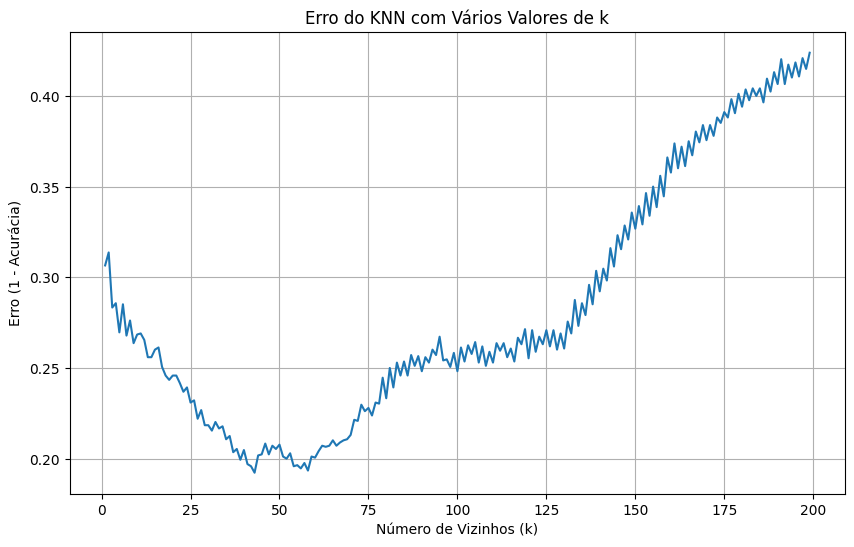

O melhor número de vizinhos é: 43
Erro correspondente: 0.19226190476190474


In [ ]:
# Extrair os valores do DataFrame e armazená-los na variável 'dados'
X = df_knn_normalized.drop(columns=['popularity_binary']).values
y = df_knn_normalized['popularity_binary'].values

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)

scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

neighbors_range = range(1, 200)
cv_scores = []

# Definir o número de folds para validação cruzada
kf = KFold(n_splits=10, shuffle=True, random_state=42)

# Avaliar o desempenho para cada valor de n_neighbors
for k in neighbors_range:
    knn = KNeighborsClassifier(n_neighbors=k)
    scores = cross_val_score(knn, X_train_scaled, y_train, cv=kf, scoring='accuracy')
    cv_scores.append(1 - np.mean(scores))  # Calcular o erro como 1 - acurácia média

plt.figure(figsize=(10, 6))
plt.plot(neighbors_range, cv_scores)
plt.xlabel('Número de Vizinhos (k)')
plt.ylabel('Erro (1 - Acurácia)')
plt.title('Erro do KNN com Vários Valores de k')
plt.grid(True)
plt.show()

# Encontrar o melhor número de vizinhos
best_k = neighbors_range[np.argmin(cv_scores)]
best_error = np.min(cv_scores)

# Imprimir o melhor número de vizinhos e o erro correspondente
print(f'O melhor número de vizinhos é: {best_k}')
print(f'Erro correspondente: {best_error}')

Executando o KNN:

Configuração utilizada: {'n_neighbors': 43}
Precisão: 0.6626
Revocação: 0.7244
F1: 0.6921
Acurácia: 0.6979


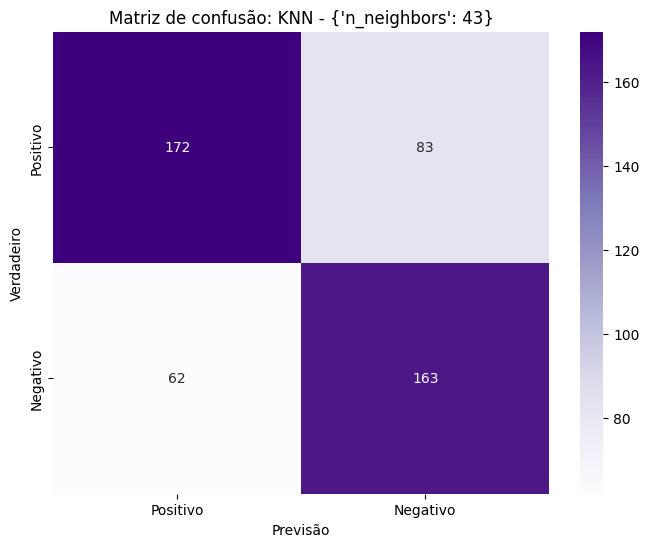



Configuração utilizada: {'n_neighbors': 5}
Precisão: 0.7017
Revocação: 0.7422
F1: 0.7214
Acurácia: 0.7312


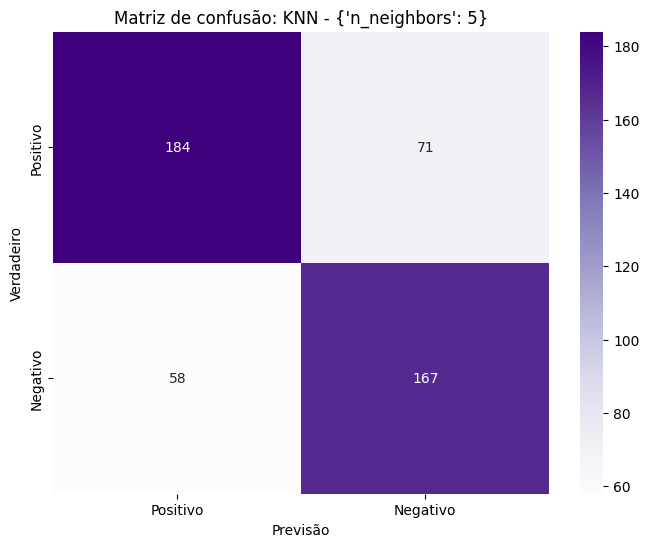



Configuração utilizada: {'n_neighbors': 10}
Precisão: 0.7273
Revocação: 0.6756
F1: 0.7005
Acurácia: 0.7292


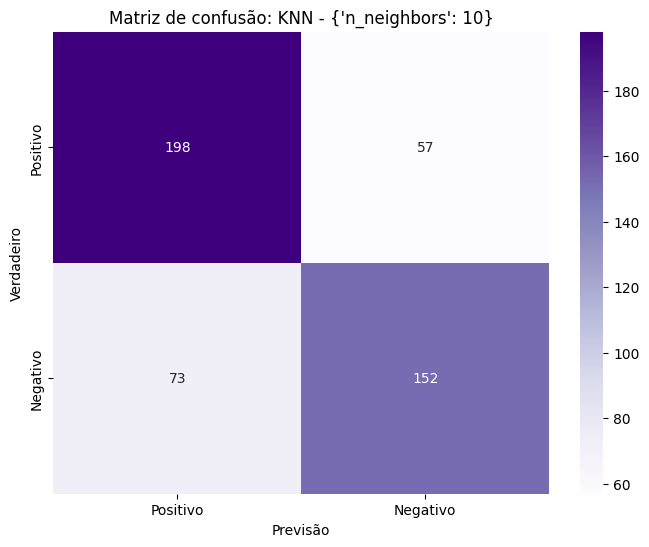



Configuração utilizada: {'n_neighbors': 20}
Precisão: 0.7488
Revocação: 0.6756
F1: 0.7103
Acurácia: 0.7417


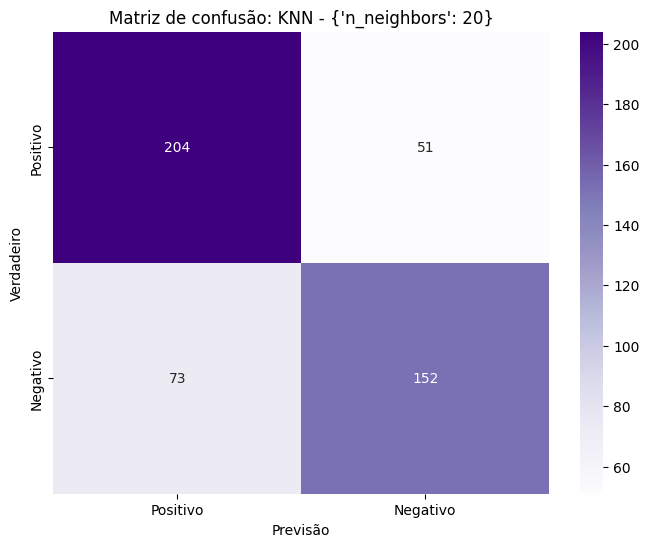



Configuração utilizada: {'n_neighbors': 50}
Precisão: 0.7297
Revocação: 0.7200
F1: 0.7248
Acurácia: 0.7438


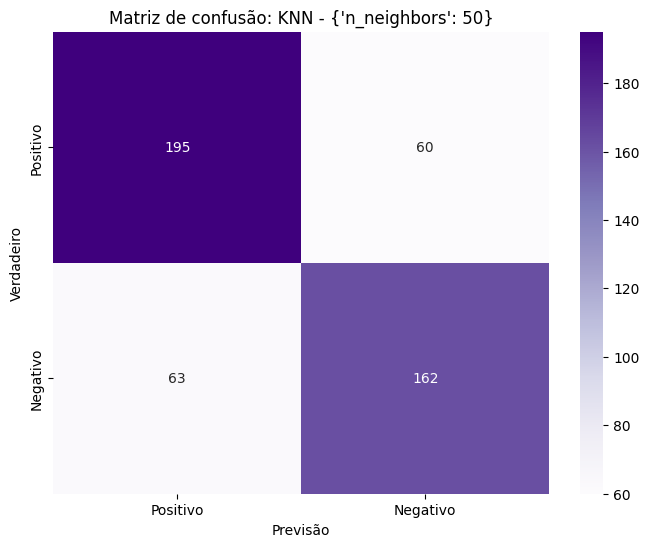



Configuração utilizada: {'n_neighbors': 100}
Precisão: 0.6972
Revocação: 0.6756
F1: 0.6862
Acurácia: 0.7104


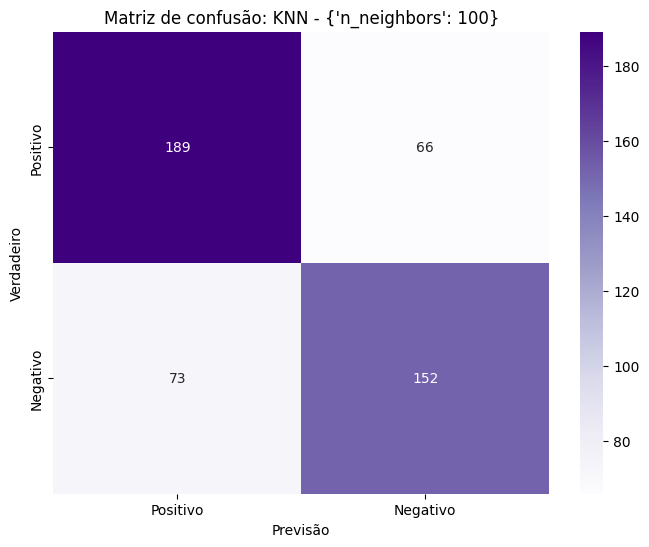



Configuração utilizada: {'n_neighbors': 900}
Precisão: 0.7850
Revocação: 0.3733
F1: 0.5060
Acurácia: 0.6583


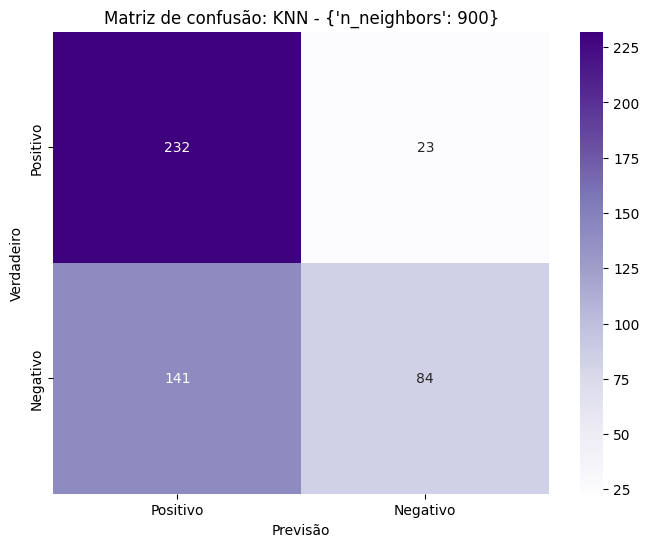



Configuração utilizada: {'n_neighbors': 1500}
Precisão: 1.0000
Revocação: 0.0044
F1: 0.0088
Acurácia: 0.5333


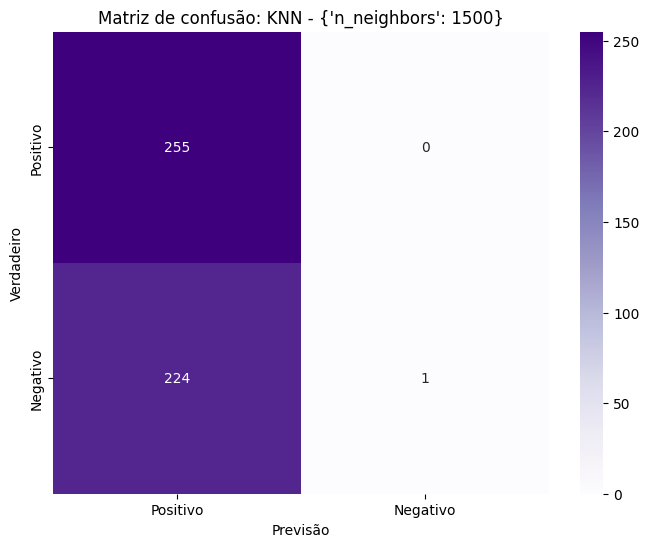

In [ ]:
# Extrair os valores do DataFrame e armazená-los na variável 'dados'
dados = df_knn_normalized.drop(columns=['popularity_binary']).values  # Exclua a coluna de alvo

# Extrair classes alvo do conjunto de dados
alvo = df_knn_normalized['popularity_binary'].values

# Definir diferentes valores de vizinhos (k)
KNN_configuracoes = [
    {'n_neighbors': best_k},
    {'n_neighbors': 5},
    {'n_neighbors': 10},
    {'n_neighbors': 20},
    {'n_neighbors': 50},
    {'n_neighbors': 100},
    {'n_neighbors': 900},
    {'n_neighbors': 1500}
]

validacao_cruzada = StratifiedKFold(n_splits=5, shuffle=True)

# Lista para armazenar os resultados de cada configuração
KNN_resposta = []

# Loop para iterar sobre cada configuração de parâmetros
for conf in KNN_configuracoes:
    # Criar o modelo KNeighborsClassifier com os parâmetros da configuração atual
    model = KNeighborsClassifier(n_neighbors=conf['n_neighbors'])

    # Avaliar o modelo utilizando a função 'avaliar_configuracao' e obter as métricas de desempenho
    precision, recall, f1, acuracia, conf_matrix = avaliar_configuracao(model, dados, alvo, validacao_cruzada)

    # Armazenar os resultados da configuração atual em um dicionário e adicionar à lista de respostas
    KNN_resposta.append({
        'config': conf,
        'precision': precision,
        'recall': recall,
        'f1': f1,
        'acuracia': acuracia,
        'confusion_matrix': conf_matrix
    })

    # Exibir os resultados para a configuração atual
    print(f"Configuração utilizada: {conf}")
    print(f"Precisão: {precision:.4f}")
    print(f"Revocação: {recall:.4f}")
    print(f"F1: {f1:.4f}")
    print(f"Acurácia: {acuracia:.4f}")

    # Criar uma nova figura para a matriz de confusão
    plt.figure(figsize=(8, 6))
    # Plotar a matriz de confusão usando seaborn com a paleta de cores 'Purples'
    sns.heatmap(conf_matrix, annot=True, fmt='d', cmap='Purples', xticklabels=['Positivo', 'Negativo'], yticklabels=['Positivo', 'Negativo'])
    # Definir o rótulo do eixo X
    plt.xlabel('Previsão')
    # Definir o rótulo do eixo Y
    plt.ylabel('Verdadeiro')
    # Definir o título do gráfico
    plt.title(f"Matriz de confusão: KNN - {conf}")
    # Mostrar o gráfico
    plt.show()

    print("\n")

Como cada gênero único se tornou uma nova coluna, já que temos um número muito grande de gêneros únicos, assim foi criado muitas colunas novas.

Dessa forma, comparando com os resultados do KNN para "track_popularity" anteriormente (secção 7.1), verificamos que os valores de Precisão, Revocação, F1 e Acurácia agora foram piores. Além disso, os valores de Falso Postivo e Falso Negativos foram maiores considerando todos os gêneros.

#### 7.3.2 Utilizando apenas os gênero mais abrangentes (67 gêneros):

Visto os resultados anteriores, vamos considerar um número menor de gêneros e executar novamente o KNN:

In [ ]:
# Mapeamento de gêneros específicos para gêneros mais gerais
genre_mapping = {
    'conscious hip hop': 'hip hop',
    'seattle hip hop': 'hip hop',
    'hip house': 'house',
    'country': 'country',
    'baton rouge rap': 'rap',
    'pop rap': 'rap',
    'indietronica': 'electronic',
    'movie tunes': 'soundtrack',
    'irish pop': 'pop',
    'uk pop': 'pop',
    'latin pop': 'pop',
    'post-grunge': 'grunge',
    'g-house': 'house',
    'brooklyn indie': 'indie',
    'seattle indie': 'indie',
    'slap house': 'house',
    'country pop': 'country',
    'tennessee hip hop': 'hip hop',
    'old school bassline': 'bassline',
    'mellow gold': 'golden oldies',
    'pop dance': 'dance',
    'modern alternative rock': 'alternative rock',
    'st louis rap': 'rap',
    'uk alternative pop': 'pop',
    'wrestling': 'wrestling',
    'escape room': 'soundtrack',
    'new rave': 'rave',
    'bedroom pop': 'pop',
    'christian alternative rock': 'alternative rock',
    'talent show': 'talent show',
    'ectofolk': 'folk',
    'k-pop girl group': 'k-pop',
    'urbano latino': 'latin',
    'irish singer-songwriter': 'singer-songwriter',
    'hands up': 'dance',
    'urban contemporary': 'urban',
    'philly rap': 'rap',
    'colombian pop': 'pop',
    'florida drill': 'drill',
    'madchester': 'rock',
    'asian american hip hop': 'hip hop',
    'neo-synthpop': 'synthpop',
    'moldovan pop': 'pop',
    'indie poptimism': 'indie',
    'dark clubbing': 'club',
    'pop': 'pop',
    'modern salsa': 'salsa',
    'drum and bass': 'drum and bass',
    'belgian dance': 'dance',
    'soul': 'soul',
    'french indie pop': 'indie',
    'australian hip hop': 'hip hop',
    'gen z singer-songwriter': 'singer-songwriter',
    'electra': 'electronic',
    'pop urbaine': 'urban',
    'welsh rock': 'rock',
    'urbano chileno': 'latin',
    'latin pop': 'pop',
    'dutch edm': 'edm',
    'grave wave': 'wave',
    'hip house': 'house',
    'pop house': 'house',
    'french rock': 'rock',
    'hard rock': 'rock',
    'political hip hop': 'hip hop',
    'new jack swing': 'swing',
    'vincy soca': 'soca',
    'canadian hip hop': 'hip hop',
    'r&b': 'r&b',
    'pov: indie': 'indie',
    'hip pop': 'pop',
    'uk hip hop': 'hip hop',
    'afrobeats': 'afrobeats',
    'dance pop': 'pop',
    'rap': 'rap',
    'uk contemporary r&b': 'r&b',
    'bronx hip hop': 'hip hop',
    'lgbtq+ hip hop': 'hip hop',
    'atl trap': 'trap',
    'instrumental grime': 'grime',
    'brostep': 'dubstep',
    'downtempo': 'downtempo',
    'girl group': 'pop',
    'australian house': 'house',
    'soca': 'soca',
    'christian music': 'christian',
    'quiet storm': 'r&b',
    'norwegian indie': 'indie',
    'french synthpop': 'synthpop',
    'san diego rap': 'rap',
    'melodic rap': 'rap',
    'bedroom soul': 'soul',
    'reggae fusion': 'reggae',
    'trip hop': 'trip hop',
    'country rap': 'rap',
    'beatlesque': 'rock',
    'pop edm': 'edm',
    'socal pop punk': 'pop punk',
    'modern country rock': 'country rock',
    'northern irish indie': 'indie',
    'new orleans rap': 'rap',
    'canadian pop': 'pop',
    'urbano mexicano': 'latin',
    'modern rock': 'rock',
    'canadian indie': 'indie',
    'country dawn': 'country',
    'nyc rap': 'rap',
    'alternative r&b': 'r&b',
    'rock-and-roll': 'rock',
    'tropical house': 'house',
    'alternative pop rock': 'pop rock',
    'australian alternative rock': 'alternative rock',
    'uk pop': 'pop',
    'virgin islands reggae': 'reggae',
    'indie rock': 'rock',
    'punk': 'punk',
    'miami hip hop': 'hip hop',
    'pop rock': 'rock',
    'alternative metal': 'metal',
    'indie poptimism': 'indie',
    'bounce': 'bounce',
    'bubblegum dance': 'dance',
    'dirty south rap': 'rap',
    'oakland hip hop': 'hip hop',
    'reggae fusion': 'reggae',
    'christian rock': 'rock',
    'portuguese electronic': 'electronic',
    'electro house': 'house',
    'funk rock': 'rock',
    'post-teen pop': 'pop',
    'minneapolis sound': 'sound',
    'downtempo': 'downtempo',
    'glam metal': 'metal',
    'australian pop': 'pop',
    'chicago rap': 'rap',
    'ukg revival': 'uk garage',
    'dfw rap': 'rap',
    'r&b en espanol': 'r&b',
    'irish rock': 'rock',
    'reggaeton colombiano': 'reggaeton',
    'pop rap': 'rap',
    'pop nacional': 'pop',
    'britpop': 'rock',
    'icelandic rock': 'rock',
    'portland hip hop': 'hip hop',
    'rap': 'rap',
    'new jersey rap': 'rap',
    'classic oklahoma country': 'country',
    'emo rap': 'rap',
    'bedroom pop': 'pop',
    'country dawn': 'country',
    'pop dance': 'dance',
    'belgian edm': 'edm',
    'chicago rap': 'rap',
    'sertanejo pop': 'pop',
    'oktoberfest': 'festive',
    'boy band': 'pop',
    'chicago drill': 'drill',
    'new wave pop': 'pop',
    'singer-songwriter pop': 'pop',
    'contemporary r&b': 'r&b',
    'sophisti-pop': 'pop',
    'indietronica': 'electronic',
    'neo-psychedelic': 'psychedelic',
    'reggaeton': 'reggaeton',
    'show tunes': 'soundtrack',
    'new rave': 'rave',
    'pop r&b': 'r&b',
    'neo soul': 'soul',
    'country road': 'country',
    'pop venezolano': 'pop',
    'modern indie pop': 'indie',
    'hyphy': 'hip hop',
    'gospel': 'gospel',
    'uk hip hop': 'hip hop',
    'garage rock': 'rock',
    'dutch pop': 'pop',
    'puerto rican pop': 'pop',
    'diva house': 'house',
    'emo rap': 'rap',
    'singer-songwriter pop': 'pop',
    'danish pop': 'pop',
    'piano rock': 'rock',
    'crunk': 'hip hop',
    'british alternative rock': 'alternative rock',
    'acoustic pop': 'pop',
    'k-pop girl group': 'k-pop',
    'belgian pop': 'pop',
    'hardcore hip hop': 'hip hop',
    'rap conscient': 'hip hop',
    'classic schlager': 'schlager',
    'stomp and holler': 'folk',
    'icelandic indie': 'indie',
    'pluggnb': 'r&b',
    'mexican pop': 'pop',
    'new orleans rap': 'rap',
    'movie tunes': 'soundtrack',
    'afrobeats': 'afrobeats',
    'british invasion': 'rock',
    'alternative dance': 'dance',
    'old school atlanta hip hop': 'hip hop',
    'baroque pop': 'pop',
    'belgian r&b': 'r&b',
    'g-funk': 'hip hop',
    'reggaeton': 'reggaeton',
    'pop-trance': 'trance',
    'southern rock': 'rock',
    'singer-songwriter pop': 'pop',
    'alternative country': 'country',
    'slowcore': 'rock',
    'french pop': 'pop',
    'soulful house': 'house',
    'melodic house': 'house',
    'country blues': 'country',
    'dance pop': 'pop',
    'rockabilly': 'rock',
    'indie soul': 'soul',
    'alternative rock': 'rock',
    'modern country': 'country',
    'tech house': 'house',
    'k-pop boy group': 'k-pop',
    'instrumental grime': 'grime',
    'classic country': 'country',
    'tropical bass': 'bass',
    'gospel pop': 'pop',
    'alternative pop': 'pop',
    'urban contemporary': 'urban',
    'vocal house': 'house',
    'latin trap': 'trap',
    'uk dance': 'dance',
    'melodic techno': 'techno',
    'indie pop': 'pop',
    'ambient pop': 'pop',
    'pop rock': 'rock',
    'pop folk': 'folk',
    'drum and bass': 'drum and bass',
    'uk grime': 'grime',
    'latin dance': 'dance',
    'mexican indie': 'indie',
    'canadian rock': 'rock',
    'romantic pop': 'pop',
    'latin trap': 'trap',
    'pop punk': 'pop punk',
    'rap conscient': 'hip hop',
    'australian alternative rock': 'alternative rock',
    'celtic folk': 'folk',
    'classic pop': 'pop',
    'dancehall': 'dancehall',
    'hip hop': 'hip hop',
    'irish indie pop': 'indie',
    'mexican pop': 'pop',
    'contemporary r&b': 'r&b',
    'pop punk': 'pop punk',
    'piano pop': 'pop',
    'pop dance': 'dance',
    'dance pop': 'pop',
    'acoustic': 'acoustic',
    'australian edm': 'edm',
    'dancehall': 'dancehall',
    'electro swing': 'swing',
    'trip hop': 'trip hop',
    'rock': 'rock',
    'jazz': 'jazz',
    'instrumental rock': 'rock',
    'grime': 'grime',
    'electropop': 'electronic',
    'vaporwave': 'vaporwave',
    'country folk': 'folk',
    'dream pop': 'pop',
    'celtic': 'folk',
    'soul': 'soul',
    'pop r&b': 'r&b',
    'new age': 'new age',
    'celtic': 'folk',
    'blues rock': 'rock',
    'australian pop': 'pop',
    'r&b pop': 'pop',
    'classical': 'classical',
    'pop country': 'country',
    'calypso': 'calypso',
    'disco': 'disco',
    'indie pop': 'pop',
    'pop punk': 'pop punk',
    'ethereal wave': 'wave',
    'french pop': 'pop',
    'electronic pop': 'pop',
    'euro house': 'house',
    'australian indie': 'indie',
    'chillwave': 'chillwave',
    'soft rock': 'rock',
    'power pop': 'pop',
    'psychedelic rock': 'rock',
    'j-pop': 'j-pop',
    'indie pop': 'pop',
    'pop r&b': 'r&b',
    'guitar pop': 'pop',
    'classical guitar': 'classical',
    'rock n roll': 'rock',
    'latin jazz': 'jazz',
    'new jack swing': 'swing',
    'latin pop': 'pop',
    'soul pop': 'pop',
    'indie pop': 'pop',
    'guitar pop': 'pop',
    'indie pop': 'pop',
    'guitar pop': 'pop'
}

In [ ]:
df_genero_melhorada = df_playlist_2000to2023.copy()

In [ ]:
# Supondo que df_genero_melhorada é o DataFrame com a coluna 'artist_genres'
df_genero_melhorada['artist_genres_general'] = df_genero_melhorada['artist_genres'].apply(
    lambda genres: [genre_mapping.get(genre, genre) for genre in genres]
)

# Se desejar, você pode criar colunas binárias para cada gênero geral
general_genres = set(genre_mapping.values())
for genre in general_genres:
    df_genero_melhorada[genre] = df_genero_melhorada['artist_genres_general'].apply(
        lambda genres: 1 if genre in genres else 0
    )

# Contar quantos gêneros únicos foram criados
genre_columns = [col for col in df_genero_melhorada.columns if col in general_genres]
num_unique_genres = len(genre_columns)

print(f'Número total de gêneros únicos: {num_unique_genres}')

Número total de gêneros únicos: 67


In [ ]:
print(df_genero_melhorada.head())

                                        playlist_url  year  \
0  https://open.spotify.com/playlist/37i9dQZF1DWU...  2000   
1  https://open.spotify.com/playlist/37i9dQZF1DWU...  2000   
2  https://open.spotify.com/playlist/37i9dQZF1DWU...  2000   
3  https://open.spotify.com/playlist/37i9dQZF1DWU...  2000   
4  https://open.spotify.com/playlist/37i9dQZF1DWU...  2000   

                 track_id              track_name  track_popularity  \
0  6naxalmIoLFWR0siv8dnQQ  Oops!...I Did It Again                81   
1  2m1hi0nfMR9vdGC8UcrnwU    All The Small Things                83   
2  3y4LxiYMgDl4RethdzpmNe                 Breathe                66   
3  0v1XpBHnsbkCn7iJ9Ucr1l            It's My Life                81   
4  62bOmKYxYg7dhrC6gH9vFn             Bye Bye Bye                75   

                     album               artist_id     artist_name  \
0  Oops!... I Did It Again  26dSoYclwsYLMAKD3tpOr4  Britney Spears   
1       Enema Of The State  6FBDaR13swtiWwGhX1WQsP       bli

##### KNN

Retirando as colunas menos significativas para o KNN:

In [ ]:
df_genero_melhorada = df_genero_melhorada.drop(['playlist_url', 'year', 'track_id', 'track_name',
                        'album', 'artist_id', 'artist_name', 'key', 'tempo',
                        'duration_ms', 'time_signature', 'artist_genres', 'artist_genres_general'], axis=1)

Normalização dos dados:

In [ ]:
# Criar o MinMaxScaler
scaler = MinMaxScaler()

# Aplicar o scaler a todas as colunas de df_genero_melhorada
df_knn_normal = pd.DataFrame(scaler.fit_transform(df_genero_melhorada), columns=df_genero_melhorada.columns)

# Visualizar as primeiras linhas do DataFrame normalizado
print(df_knn_normal.head())

   track_popularity  artist_popularity  danceability    energy  loudness  \
0          0.843750           0.703125      0.724477  0.825784  0.751908   
1          0.864583           0.671875      0.334563  0.892303  0.777159   
2          0.687500           0.406250      0.451415  0.468905  0.580865   
3          0.843750           0.671875      0.478475  0.909196  0.818204   
4          0.781250           0.531250      0.551046  0.922923  0.780759   

   mode  speechiness  acousticness  instrumentalness  liveness  ...  \
0   0.0     0.038302      0.306739          0.000018  0.348643  ...   
1   1.0     0.047516      0.010519          0.000000  0.616910  ...   
2   1.0     0.011743      0.176881          0.000000  0.240084  ...   
3   0.0     0.043541      0.026879          0.000014  0.340292  ...   
4   0.0     0.045890      0.031685          0.001218  0.063779  ...   

   classical  dancehall  edm  pop punk  trap  metal  downtempo  psychedelic  \
0        0.0        0.0  0.0       0.

Vamos definir os intervalos para cada classe:

Classe 1: Representa músicas com "track_popularity" maior que 0.75.

Classe 0: Representa músicas com "track_popularity" menor ou igual a 0.75.

In [ ]:
# Adiciona a coluna 'popularity_binary' com valores binários baseados na popularidade da música
df_knn_normal['popularity_binary'] = df_knn_normal['track_popularity'].apply(lambda x: 1 if x > 0.75 else 0)

# Visualizando as primeiras linhas para verificar a nova coluna
print(df_knn_normal[['track_popularity', 'popularity_binary']].head())

   track_popularity  popularity_binary
0          0.843750                  1
1          0.864583                  1
2          0.687500                  0
3          0.843750                  1
4          0.781250                  1


Verificar a distribuição das classes:

In [ ]:
print(df_knn_normal['popularity_binary'].value_counts())

popularity_binary
0    1275
1    1125
Name: count, dtype: int64


Encontrar melhor valor de K:

obs: o código abaixo demora por volta de 1min pra rodar visto que "neighbors_range" vai de 1 até 200.

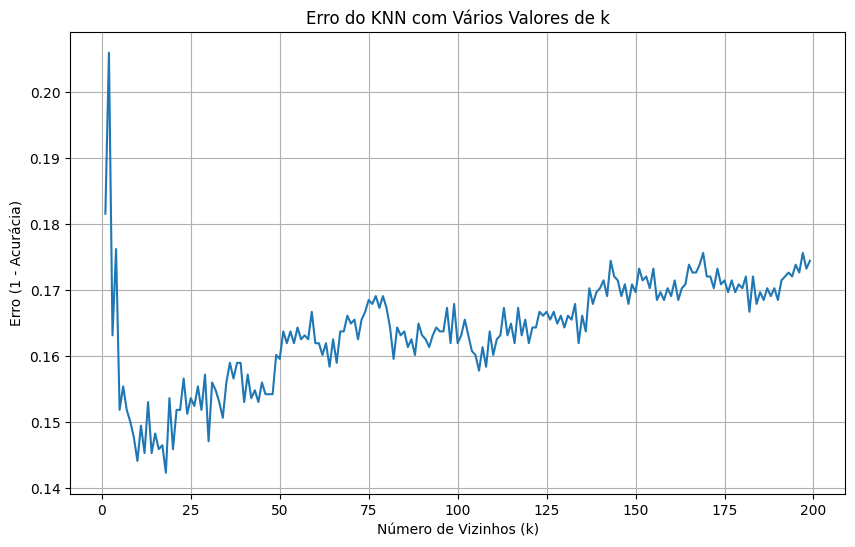

O melhor número de vizinhos é: 18
Erro correspondente: 0.1422619047619047


In [ ]:
# Extrair os valores do DataFrame e armazená-los na variável 'dados'
X = df_knn_normal.drop(columns=['popularity_binary']).values
y = df_knn_normal['popularity_binary'].values

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)

scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

neighbors_range = range(1, 200)
cv_scores = []

# Definir o número de folds para validação cruzada
kf = KFold(n_splits=10, shuffle=True, random_state=42)

# Avaliar o desempenho para cada valor de n_neighbors
for k in neighbors_range:
    knn = KNeighborsClassifier(n_neighbors=k)
    scores = cross_val_score(knn, X_train_scaled, y_train, cv=kf, scoring='accuracy')
    cv_scores.append(1 - np.mean(scores))  # Calcular o erro como 1 - acurácia média

plt.figure(figsize=(10, 6))
plt.plot(neighbors_range, cv_scores)
plt.xlabel('Número de Vizinhos (k)')
plt.ylabel('Erro (1 - Acurácia)')
plt.title('Erro do KNN com Vários Valores de k')
plt.grid(True)
plt.show()

# Encontrar o melhor número de vizinhos
best_k = neighbors_range[np.argmin(cv_scores)]
best_error = np.min(cv_scores)

# Imprimir o melhor número de vizinhos e o erro correspondente
print(f'O melhor número de vizinhos é: {best_k}')
print(f'Erro correspondente: {best_error}')

Executando o KNN:

Configuração utilizada: {'n_neighbors': 18}
Precisão: 0.8421
Revocação: 0.7822
F1: 0.8111
Acurácia: 0.8292


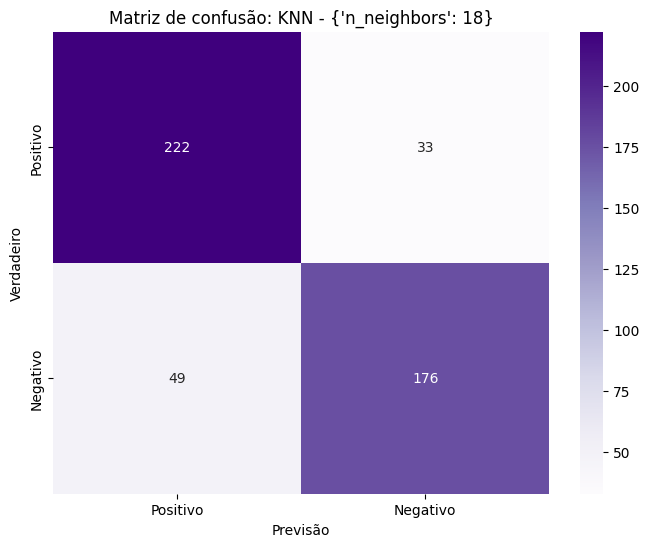



Configuração utilizada: {'n_neighbors': 5}
Precisão: 0.7759
Revocação: 0.8000
F1: 0.7877
Acurácia: 0.7979


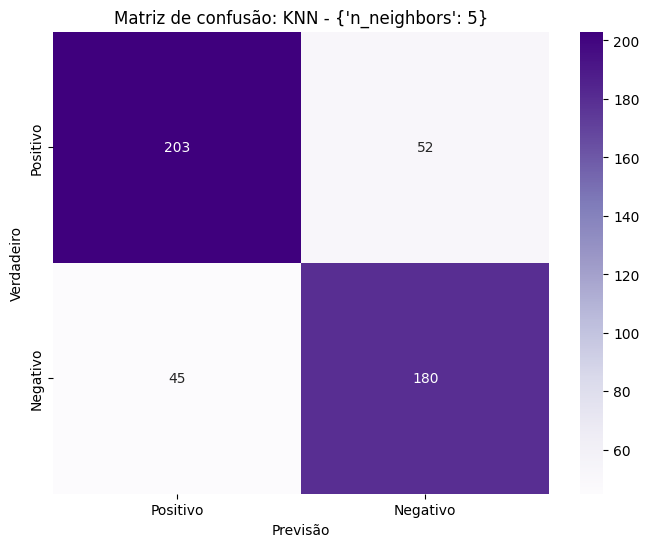



Configuração utilizada: {'n_neighbors': 10}
Precisão: 0.8382
Revocação: 0.7600
F1: 0.7972
Acurácia: 0.8187


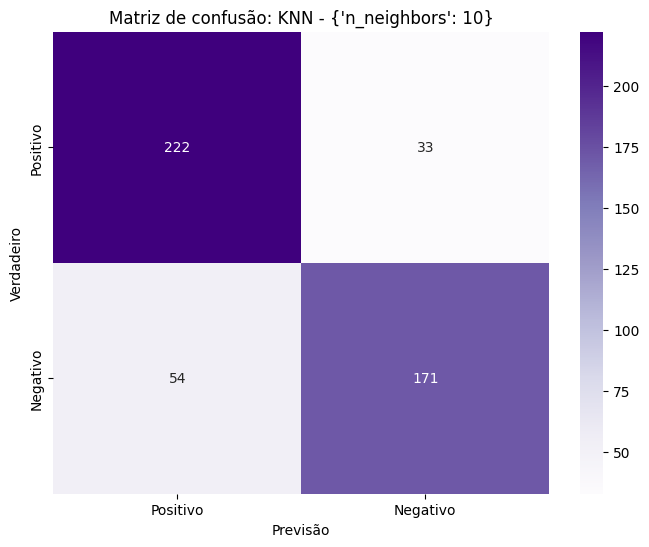



Configuração utilizada: {'n_neighbors': 20}
Precisão: 0.7758
Revocação: 0.7689
F1: 0.7723
Acurácia: 0.7875


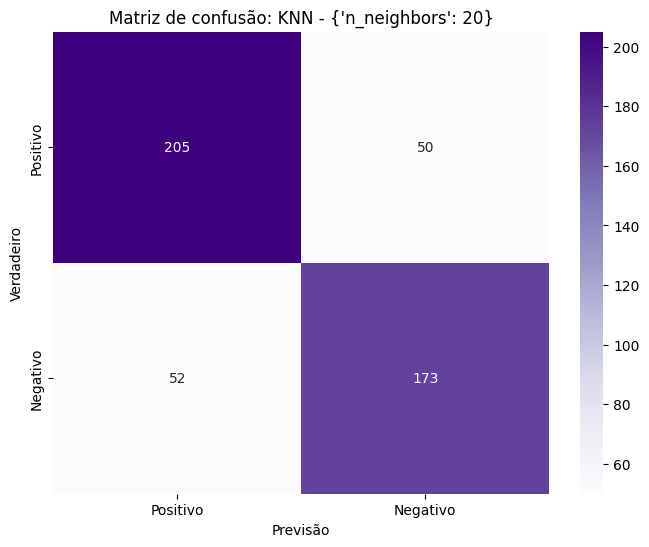



Configuração utilizada: {'n_neighbors': 50}
Precisão: 0.7901
Revocação: 0.8533
F1: 0.8205
Acurácia: 0.8250


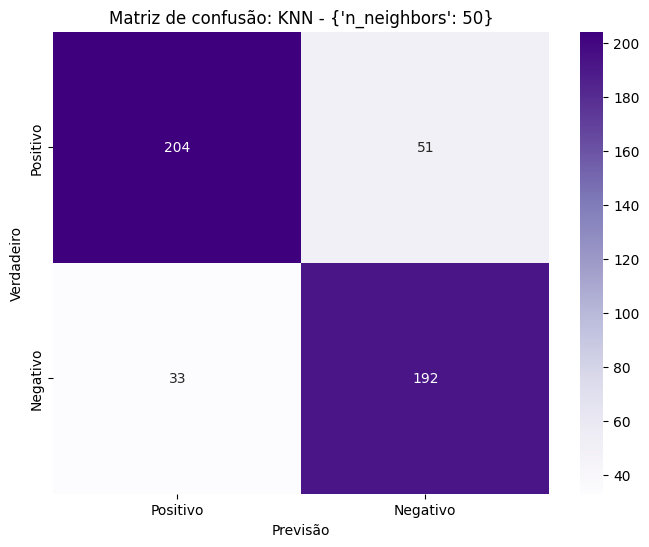



Configuração utilizada: {'n_neighbors': 100}
Precisão: 0.7383
Revocação: 0.8400
F1: 0.7859
Acurácia: 0.7854


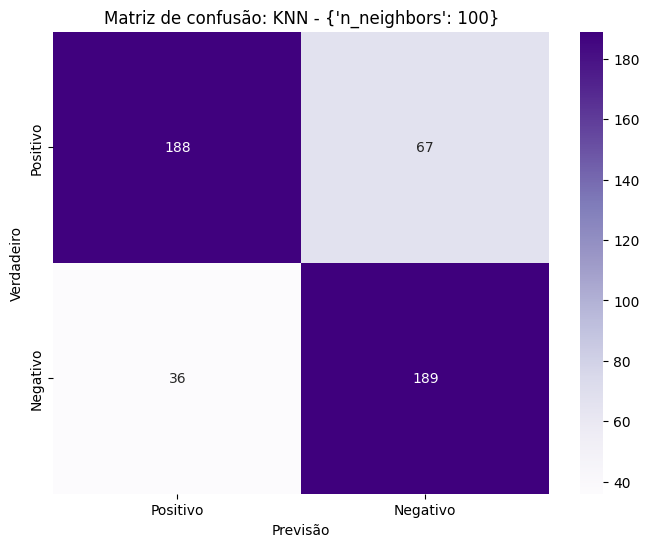



Configuração utilizada: {'n_neighbors': 900}
Precisão: 0.9020
Revocação: 0.4089
F1: 0.5627
Acurácia: 0.7021


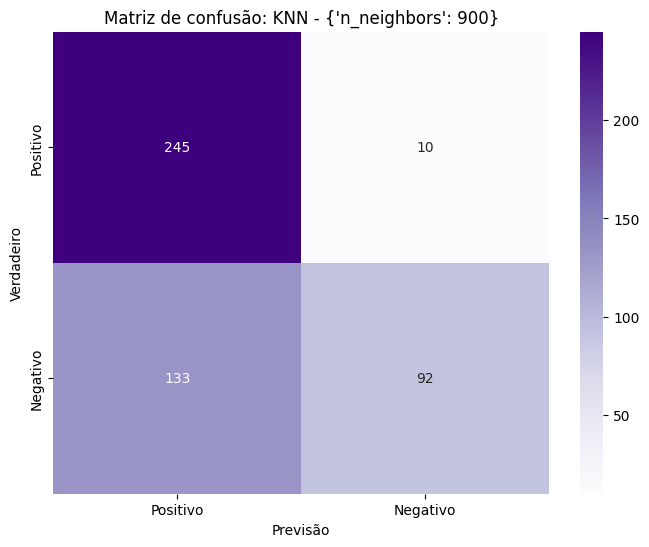



Configuração utilizada: {'n_neighbors': 1500}
Precisão: 0.8667
Revocação: 0.2311
F1: 0.3649
Acurácia: 0.6229


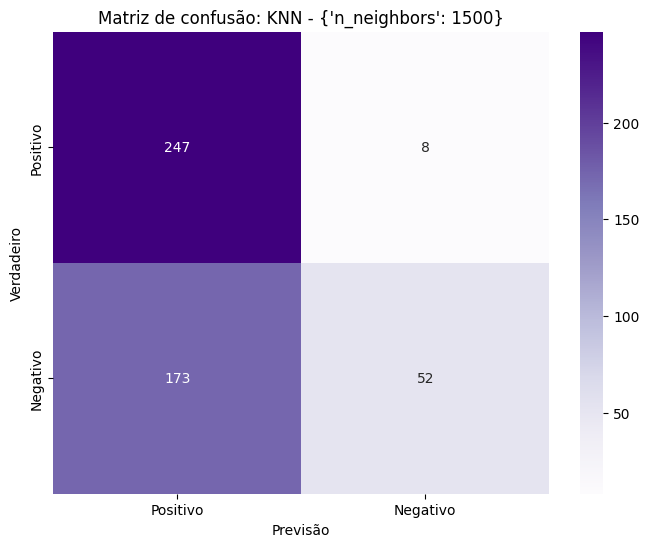

In [ ]:
# Extrair os valores do DataFrame e armazená-los na variável 'dados'
dados = df_knn_normal.drop(columns=['popularity_binary']).values  # Exclua a coluna de alvo

# Extrair classes alvo do conjunto de dados
alvo = df_knn_normal['popularity_binary'].values

# Definir diferentes valores de vizinhos (k), 3 números de vizinhos diferentes
KNN_configuracoes = [
    {'n_neighbors': best_k},
    {'n_neighbors': 5},
    {'n_neighbors': 10},
    {'n_neighbors': 20},
    {'n_neighbors': 50},
    {'n_neighbors': 100},
    {'n_neighbors': 900},
    {'n_neighbors': 1500}
]

validacao_cruzada = StratifiedKFold(n_splits=5, shuffle=True)

# Lista para armazenar os resultados de cada configuração
KNN_resposta = []

# Loop para iterar sobre cada configuração de parâmetros
for conf in KNN_configuracoes:
    # Criar o modelo KNeighborsClassifier com os parâmetros da configuração atual
    model = KNeighborsClassifier(n_neighbors=conf['n_neighbors'])

    # Avaliar o modelo utilizando a função 'avaliar_configuracao' e obter as métricas de desempenho
    precision, recall, f1, acuracia, conf_matrix = avaliar_configuracao(model, dados, alvo, validacao_cruzada)

    # Armazenar os resultados da configuração atual em um dicionário e adicionar à lista de respostas
    KNN_resposta.append({
        'config': conf,
        'precision': precision,
        'recall': recall,
        'f1': f1,
        'acuracia': acuracia,
        'confusion_matrix': conf_matrix
    })

    # Exibir os resultados para a configuração atual
    print(f"Configuração utilizada: {conf}")
    print(f"Precisão: {precision:.4f}")
    print(f"Revocação: {recall:.4f}")
    print(f"F1: {f1:.4f}")
    print(f"Acurácia: {acuracia:.4f}")

    # Criar uma nova figura para a matriz de confusão
    plt.figure(figsize=(8, 6))
    # Plotar a matriz de confusão usando seaborn com a paleta de cores 'Purples'
    sns.heatmap(conf_matrix, annot=True, fmt='d', cmap='Purples', xticklabels=['Positivo', 'Negativo'], yticklabels=['Positivo', 'Negativo'])
    # Definir o rótulo do eixo X
    plt.xlabel('Previsão')
    # Definir o rótulo do eixo Y
    plt.ylabel('Verdadeiro')
    # Definir o título do gráfico
    plt.title(f"Matriz de confusão: KNN - {conf}")
    # Mostrar o gráfico
    plt.show()

    print("\n")

Considerando apenas os gêneros mais abrangentes, o resultado do KNN para o melhor número de vizinhos ficou bem melhor, se comparado tanto com o KNN feito anteriormente (considerando todos os gêneros), quando comparamos com o KNN feito na secção 7.1.

Isso mostra que as informações de gêneros, quando tratadas de maneira mais geral, é importante para previsão de dados, pois deixa o modelo mais complexo.

### 7.4. Intervalo de Confiança do KNN

Nesta etapa, vamos desenvolver o intervalo de confiança para cada métrica do KNN.

Precisão: a precisão mede a proporção de verdadeiros positivos entre todos os exemplos que o modelo classificou como positivos.

Recall: A revocação mede a proporção de verdadeiros positivos entre todos os exemplos que são realmente positivos.

F1: O F1-Score é a média harmônica entre a precisão e a revocação. Ele combina ambas as métricas em uma única pontuação que leva em consideração tanto a precisão quanto a revocação.

Accuracy: A acurácia mede a proporção de previsões corretas (tanto positivas quanto negativas) entre todos os exemplos.

In [ ]:
# Extrair os valores do DataFrame e armazená-los na variável 'dados'
dados = df_knn_normal.drop(columns=['popularity_binary']).values  # Exclua a coluna de alvo

# Extrair classes alvo do conjunto de dados
alvo = df_knn_normal['popularity_binary'].values

obs: demora mais ou menos 4min pra rodar o código abaixo

In [ ]:
from sklearn.utils import resample
from sklearn.metrics import precision_score, recall_score, f1_score, accuracy_score
import numpy as np

# Definir os parâmetros do KNN
n_neighbors = 10
model = KNeighborsClassifier(n_neighbors=n_neighbors)

# Número de execuções do bootstrap
n_bootstraps = 1000

# Listas para armazenar os resultados das métricas
precision_scores = []
recall_scores = []
f1_scores = []
accuracy_scores = []

# Execução do bootstrap
for i in range(n_bootstraps):
    # Criação de uma amostra com substituição
    X_resampled, y_resampled = resample(dados, alvo, random_state=i)

    # Treinar o modelo com a amostra
    model.fit(X_resampled, y_resampled)

    # Fazer previsões
    y_pred = model.predict(dados)

    # Calcular as métricas
    precision_scores.append(precision_score(alvo, y_pred))
    recall_scores.append(recall_score(alvo, y_pred))
    f1_scores.append(f1_score(alvo, y_pred))
    accuracy_scores.append(accuracy_score(alvo, y_pred))

# Calcular os intervalos de confiança
confidence_interval_precision = np.percentile(precision_scores, [2.5, 97.5])
confidence_interval_recall = np.percentile(recall_scores, [2.5, 97.5])
confidence_interval_f1 = np.percentile(f1_scores, [2.5, 97.5])
confidence_interval_accuracy = np.percentile(accuracy_scores, [2.5, 97.5])

# Exibir os resultados
print(f"Intervalo de Confiança para Precisão: {confidence_interval_precision}")
print(f"Intervalo de Confiança para Revocação: {confidence_interval_recall}")
print(f"Intervalo de Confiança para F1: {confidence_interval_f1}")
print(f"Intervalo de Confiança para Acurácia: {confidence_interval_accuracy}")

Intervalo de Confiança para Precisão: [0.82321766 0.86632175]
Intervalo de Confiança para Revocação: [0.76888889 0.82844444]
Intervalo de Confiança para F1: [0.80614816 0.83386087]
Intervalo de Confiança para Acurácia: [0.82458333 0.8475    ]


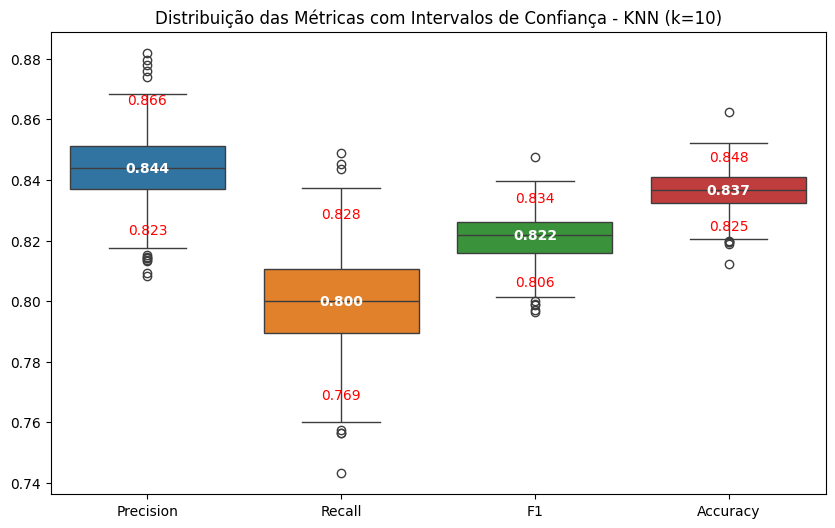

In [ ]:
# Supondo que precision_scores, recall_scores, f1_scores, e accuracy_scores já estejam definidos
df_bootstrap = pd.DataFrame({
    'Precision': precision_scores,
    'Recall': recall_scores,
    'F1': f1_scores,
    'Accuracy': accuracy_scores  # Adiciona a coluna de acurácia
})

# Criar o boxplot
plt.figure(figsize=(10, 6))  # Ajuste o tamanho da figura conforme necessário
sns.boxplot(data=df_bootstrap)
plt.title(f'Distribuição das Métricas com Intervalos de Confiança - KNN (k={n_neighbors})')

# Adicionar valores das medianas e intervalos de confiança no gráfico
medians = df_bootstrap.median()
ci_lower = df_bootstrap.quantile(0.025)
ci_upper = df_bootstrap.quantile(0.975)

# Loop sobre as colunas para adicionar valores
for i, column in enumerate(df_bootstrap.columns):
    # Adicionar mediana
    plt.text(i, medians[column], f'{medians[column]:.3f}',
             ha='center', va='center', fontweight='bold', color='white')

    # Adicionar intervalos de confiança
    plt.text(i, ci_lower[column], f'{ci_lower[column]:.3f}',
             ha='center', va='center', color='red', fontsize=10)
    plt.text(i, ci_upper[column], f'{ci_upper[column]:.3f}',
             ha='center', va='center', color='red', fontsize=10)

plt.show()

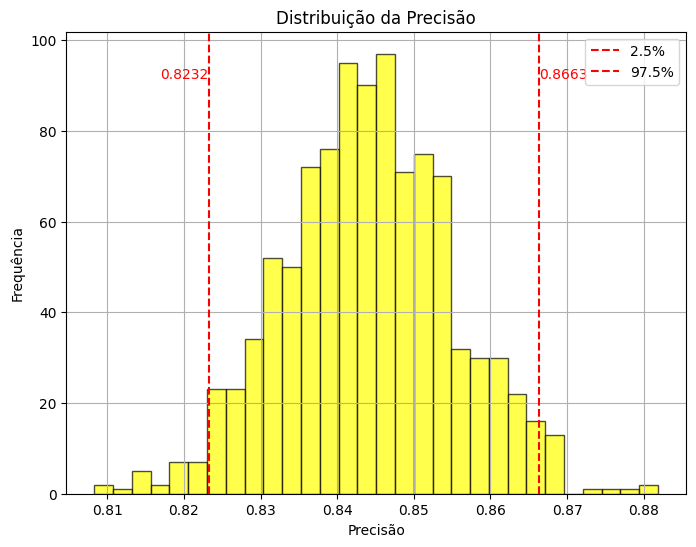

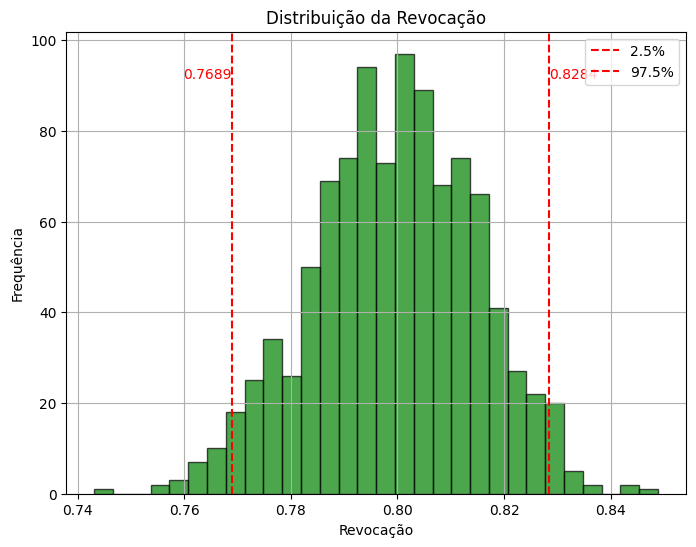

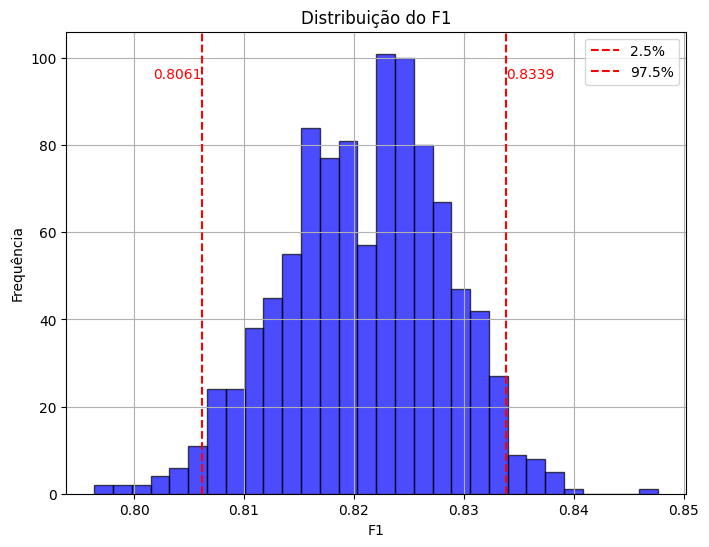

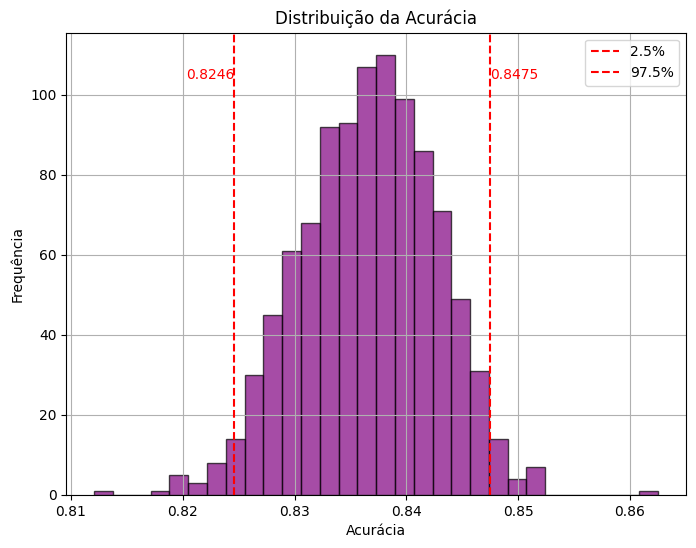

In [ ]:
# Distribuição da Precisão
plt.figure(figsize=(8, 6))
plt.hist(precision_scores, bins=30, color='yellow', alpha=0.7, edgecolor='black')
plt.axvline(confidence_interval_precision[0], color='red', linestyle='--', label='2.5%')
plt.axvline(confidence_interval_precision[1], color='red', linestyle='--', label='97.5%')
plt.text(confidence_interval_precision[0], plt.ylim()[1]*0.9, f'{confidence_interval_precision[0]:.4f}', color='red', ha='right')
plt.text(confidence_interval_precision[1], plt.ylim()[1]*0.9, f'{confidence_interval_precision[1]:.4f}', color='red', ha='left')
plt.title('Distribuição da Precisão')
plt.xlabel('Precisão')
plt.ylabel('Frequência')
plt.grid(True)
plt.legend()
plt.show()

# Distribuição da Revocação
plt.figure(figsize=(8, 6))
plt.hist(recall_scores, bins=30, color='green', alpha=0.7, edgecolor='black')
plt.axvline(confidence_interval_recall[0], color='red', linestyle='--', label='2.5%')
plt.axvline(confidence_interval_recall[1], color='red', linestyle='--', label='97.5%')
plt.text(confidence_interval_recall[0], plt.ylim()[1]*0.9, f'{confidence_interval_recall[0]:.4f}', color='red', ha='right')
plt.text(confidence_interval_recall[1], plt.ylim()[1]*0.9, f'{confidence_interval_recall[1]:.4f}', color='red', ha='left')
plt.title('Distribuição da Revocação')
plt.xlabel('Revocação')
plt.ylabel('Frequência')
plt.grid(True)
plt.legend()
plt.show()

# Distribuição do F1
plt.figure(figsize=(8, 6))
plt.hist(f1_scores, bins=30, color='blue', alpha=0.7, edgecolor='black')
plt.axvline(confidence_interval_f1[0], color='red', linestyle='--', label='2.5%')
plt.axvline(confidence_interval_f1[1], color='red', linestyle='--', label='97.5%')
plt.text(confidence_interval_f1[0], plt.ylim()[1]*0.9, f'{confidence_interval_f1[0]:.4f}', color='red', ha='right')
plt.text(confidence_interval_f1[1], plt.ylim()[1]*0.9, f'{confidence_interval_f1[1]:.4f}', color='red', ha='left')
plt.title('Distribuição do F1')
plt.xlabel('F1')
plt.ylabel('Frequência')
plt.grid(True)
plt.legend()
plt.show()

# Distribuição da Acurácia
plt.figure(figsize=(8, 6))
plt.hist(accuracy_scores, bins=30, color='purple', alpha=0.7, edgecolor='black')
plt.axvline(confidence_interval_accuracy[0], color='red', linestyle='--', label='2.5%')
plt.axvline(confidence_interval_accuracy[1], color='red', linestyle='--', label='97.5%')
plt.text(confidence_interval_accuracy[0], plt.ylim()[1]*0.9, f'{confidence_interval_accuracy[0]:.4f}', color='red', ha='right')
plt.text(confidence_interval_accuracy[1], plt.ylim()[1]*0.9, f'{confidence_interval_accuracy[1]:.4f}', color='red', ha='left')
plt.title('Distribuição da Acurácia')
plt.xlabel('Acurácia')
plt.ylabel('Frequência')
plt.grid(True)
plt.legend()
plt.show()


## **Considerações Finais**

O desenvolvimento deste projeto proporcionou uma forma de aprofundar
nosso conhecimento em Ciência de Dados. O trabalho permitiu a visualização prática dos conceitos ensinados durante o curso, ao analisar uma base de dados e extrair informações dela.

Verificamos que há uma tendência no mercado em produzir, em média, músicas com duração próxima de 120 segundos, sendo raros os casos muito discrepantes. Além disso, observamos pelo teste A/B que gêneros musicais influenciam a média dos tempos de duração.

Ao conferir as características musicais mais distintas dos gêneros mais populares, observamos que cada gênero musical possui características mais distintas. O gênero 'hip hop' destaca-se pela maior danceability e speechiness, enquanto o 'edm' exibe a maior energia e o tom 'key' mais agudo. Por outro lado, 'alternative pop' apresenta os menores valores de loudness. 'Alternative rock' se destaca pelos maiores índices de instrumentalness e o gênero 'pop' possui a maior valence. Por fim, o gênero r&b é o que apresenta a maior duração de tempo das músicas.

Com a execução da regressão linear com algumas variáveis, observamos que, individualmente, elas não explicam bem a popularidade das músicas, pois, além de apresentarem baixa correlação, o R2 também é muito baixo. Após isso, o uso da regressão múltipla com mais variáveis mostrou um intervalo do erro quadrático com um valor mais alto sugerindo uma maior discrepância entre os valores previstos e reais, indicando que o modelo pode não ter um desempenho consistente em todas as situações.

O uso dos algoritmos KNN e Naive Bayes para prever a popularidade da música e artista se mostrou eficientes, com bons valores de precisão, revocação, F1 e acurácia. De maneira generalizada, as configurações com um número muito baixo de vizinhos foram mais sensíveis a variações e ruídos dos dados, enquanto as configurações com um número muito alto tenderam a ignorar muitos positivos reais. Pelo fato das variáveis não serem tão correlacionadas, o modelo Naive Bayes possui valores melhores. A transformação da coluna gênero multivalorada em colunas binárias trouxe um melhor desempenho ao prever a popularidade da música, tornando o modelo de KNN mais complexo.

Ao fim do projeto, percebemos características importantes da base de dados e do tema proposto. Notamos, contudo, que nosso estudo apresenta algumas limitações tanto pela disponibilidade de dados, como também pela simplicidade dos métodos utilizados. A primeira delas, pode ser contornada pela obtenção de um maior volume de dados com maior diversidade. Além disso, uma futura análise pode se beneficiar de modelos mais complexos, sendo a aplicação de uma regressão não-linear com uma rede neural.   

## Referências

Flavio Vinicius Diniz de Figueiredo (2024). Slides virtuais da disciplina de Introdução à Ciência de Dados. Disponível em: DCC 212 | Introdução à Ciência de Dados (https://icd-ufmg.github.io/). Departamento de Ciência da Computação. Universidade Federal de Minas Gerais. Belo Horizonte.

LAU, Sam; GONZALEZ, Joey; NOLAN, Deb. Learning Data Science. O’Reilly Media, 2023. Disponível em: https://learningds.org/intro.html. Acesso em: jul. 2024.

ÇETINKAYA-RUNDEL, Mine; HARDIN, Johanna. Introduction to Modern Statistics. 2. ed. OpenIntro, 2024. Disponível em: https://openintro-ims.netlify.app/. Acesso em: jul. 2024.

ADHIKARI, Ani; DENERO, John; WAGNER, David. Computational and Inferential Thinking: The Foundations of Data Science. 2. ed. Disponível em: https://inferentialthinking.com/chapters/intro.html. Acesso em: jul. 2024.